In [5]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import ImageDataGenerator

In [6]:
batch_size=64
SIZE=32

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_image_generator(directory, batch_size, target_size=(64, 64)):
    # Configuración del generador de imágenes
    datagen = ImageDataGenerator(
        rescale=1./255,  # Normaliza las imágenes
        horizontal_flip=True,  # Aplica flip horizontal
        vertical_flip=True     # Aplica flip vertical
    )

    # Crear un flujo de datos a partir del directorio
    generator = datagen.flow_from_directory(
        directory=directory,
        target_size=target_size,  # Redimensiona las imágenes
        batch_size=batch_size,
        class_mode='categorical',  # Ajusta según tus necesidades (categorical, binary, etc.)
        shuffle=True  # Mezcla las imágenes
    )

    return generator

# Uso del generador
batch_size = 32  # Define el tamaño de tu batch
source_directory = 'Dataset/animal_cutouts'

image_generator = create_image_generator(source_directory, batch_size)

# Para obtener un batch de imágenes, puedes usar:
images, labels = next(image_generator)

Found 39489 images belonging to 4 classes.


In [8]:
import matplotlib.pyplot as plt


batch1 = next(dataset)
batch2 = next(dataset)

# Seleccionar una imagen de cada lote
image1 = batch1[0]  # Primera imagen del primer lote
image2 = batch2[0]  # Primera imagen del segundo lote

# Calcular y mostrar los valores máximos y mínimos de los píxeles para cada imagen
max_val_image1 = image1.max()
min_val_image1 = image1.min()
max_val_image2 = image2.max()
min_val_image2 = image2.min()

print(f"Imagen 1 - Valor máximo de píxeles: {max_val_image1}, Valor mínimo de píxeles: {min_val_image1}")
print(f"Imagen 2 - Valor máximo de píxeles: {max_val_image2}, Valor mínimo de píxeles: {min_val_image2}")
# Suponiendo que batch1 y batch2 son dos lotes obtenidos del dataset

# Rescale back the images to the range 0-255 for display
image1 = (batch1[0] + 1) * 0.5 * 255  # Convert from range -1 to 1 back to 0-255
image2 = (batch2[0] + 1) * 0.5 * 255  # Convert from range -1 to 1 back to 0-255

# Remove the channel dimension since matplotlib expects grayscale images to be 2D
image1 = image1.squeeze()  # Convert from (64, 64, 1) to (64, 64)
image2 = image2.squeeze()  # Convert from (64, 64, 1) to (64, 64)

# Plot the images
fig, axes = plt.subplots(1, 2, figsize=(2, 2))

axes[0].imshow(image1.astype('uint8'), cmap='gray')  # Convert to uint8 and set colormap to gray
axes[0].axis('off')  # Hide axes
axes[0].set_title('Image 1')

axes[1].imshow(image2.astype('uint8'), cmap='gray')  # Convert to uint8 and set colormap to gray
axes[1].axis('off')  # Hide axes
axes[1].set_title('Image 2')

plt.show()

NameError: name 'dataset' is not defined

In [572]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2DTranspose, BatchNormalization, LeakyReLU, Conv2D, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import Input
from keras.layers import Dropout
from tensorflow.keras.layers import UpSampling2D, Conv2D

def build_generator(latent_dim=100):
    model = Sequential()

    model.add(Dense(4*4*256,activation="relu",input_dim=100))
    model.add(Reshape((4,4,256)))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))
   
    # Output resolution, additional upsampling
    model.add(UpSampling2D())
    model.add(Conv2D(128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    # Final CNN layer
    model.add(Conv2D(3,kernel_size=3,padding="same"))
    model.add(Activation("tanh"))

    return model

In [573]:
from tensorflow.keras.layers import Conv2DTranspose, BatchNormalization, LeakyReLU, Conv2D, Activation, Flatten, Dense, Reshape
from tensorflow.keras.layers import Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU, Activation, Concatenate
from tensorflow.keras.layers import Flatten, Dense
from tensorflow.keras.layers import Activation, ZeroPadding2D
def build_discriminator(in_shape=(32,32,3)):
    model = Sequential()

    model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=in_shape, 
                     padding="same"))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
    model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model

In [574]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1.5e-4, beta_1=0.5) 
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1.5e-4, beta_1=0.5)

In [575]:
generator = build_generator()
generator.summary()
discriminator = build_discriminator()
discriminator.summary()

Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_96 (Dense)            (None, 4096)              413696    
                                                                 
 reshape_54 (Reshape)        (None, 4, 4, 256)         0         
                                                                 
 up_sampling2d_48 (UpSamplin  (None, 8, 8, 256)        0         
 g2D)                                                            
                                                                 
 conv2d_241 (Conv2D)         (None, 8, 8, 256)         590080    
                                                                 
 batch_normalization_242 (Ba  (None, 8, 8, 256)        1024      
 tchNormalization)                                               
                                                                 
 activation_104 (Activation)  (None, 8, 8, 256)     

In [576]:
@tf.function
def train_step(images):
  seed = tf.random.normal([batch_size, 100])

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(seed, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)
    

    gradients_of_generator = gen_tape.gradient(\
        gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(\
        disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(
        gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(
        gradients_of_discriminator, 
        discriminator.trainable_variables))
  return gen_loss,disc_loss

In [577]:
import matplotlib.pyplot as plt
import numpy as np

def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)

    # Adjust the figure size if needed
    fig = plt.figure(figsize=(2, 2))  # You may want to make this bigger if the images are too small

    # Limit to display the first 4 images
    for i in range(4):  # Change from `predictions.shape[0]` to `4`
        plt.subplot(2, 2, i+1)  # Arrange in a 2x2 grid
        # Rescale the pixel values to the [0, 255] range and remove the last dimension
        image = np.squeeze(np.clip(predictions[i] * 127.5 + 127.5, 0, 255).astype(np.uint8))
        plt.imshow(image, cmap='gray')  # Show the image in grayscale
        plt.axis('off')

    # Save and display the figure
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

In [578]:
from tqdm import tqdm  # Import tqdm
num_examples_to_generate = 4
seed = tf.random.normal([num_examples_to_generate, 100])

def train(dataset, epochs, batch_size=4):
    for epoch in range(epochs):
        gen_loss_list = []
        disc_loss_list = []

        # Calculate the number of steps per epoch
        steps_per_epoch = dataset.samples // batch_size
        if dataset.samples % batch_size != 0:
            steps_per_epoch += 1

        # tqdm is used here to show the progress bar
        with tqdm(total=steps_per_epoch, desc=f'Epoch {epoch + 1}/{epochs}', unit='step') as pbar:
            for step in range(steps_per_epoch):
                image_batch = next(dataset)
                t_loss_gen, t_loss_disc = train_step(image_batch)
                gen_loss_list.append(t_loss_gen)
                disc_loss_list.append(t_loss_disc)

                # Update the progress bar
                pbar.update(1)

            # Generate images for the GIF at the end
            generate_and_save_images(generator, epoch + 1, seed)

            # Optionally save the model every 15 epochs
            #if (epoch + 1) % 15 == 0:
                # checkpoint.save(file_prefix=checkpoint_prefix)

        # Print losses after the progress bar
        print(f'Generator Loss: {np.mean(gen_loss_list)}, Discriminator Loss: {np.mean(disc_loss_list)}')


Epoch 1/1000:  98%|█████████▊| 85/87 [00:09<00:00,  5.13step/s]

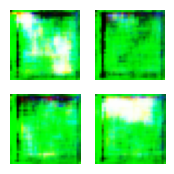

Epoch 1/1000: 100%|██████████| 87/87 [00:10<00:00,  8.53step/s]


Generator Loss: 1.7017494440078735, Discriminator Loss: 1.0632935762405396


Epoch 2/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.61step/s]

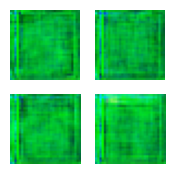

Epoch 2/1000: 100%|██████████| 87/87 [00:04<00:00, 18.66step/s]


Generator Loss: 1.4338356256484985, Discriminator Loss: 1.2566381692886353


Epoch 3/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]

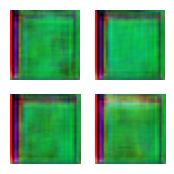

Epoch 3/1000: 100%|██████████| 87/87 [00:05<00:00, 17.28step/s]


Generator Loss: 2.0295515060424805, Discriminator Loss: 0.8493155241012573


Epoch 4/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.51step/s]

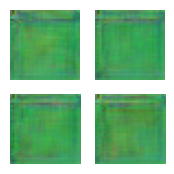

Epoch 4/1000: 100%|██████████| 87/87 [00:04<00:00, 19.00step/s]


Generator Loss: 2.0420210361480713, Discriminator Loss: 1.2725948095321655


Epoch 5/1000: 100%|██████████| 87/87 [00:04<00:00, 20.32step/s]

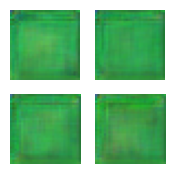

Epoch 5/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 0.8410553932189941, Discriminator Loss: 1.4602909088134766


Epoch 6/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.47step/s]

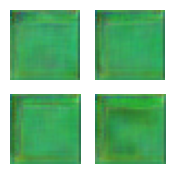

Epoch 6/1000: 100%|██████████| 87/87 [00:04<00:00, 17.70step/s]


Generator Loss: 0.9169167876243591, Discriminator Loss: 1.332451343536377


Epoch 7/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.10step/s]

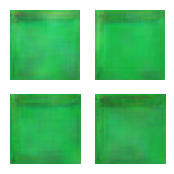

Epoch 7/1000: 100%|██████████| 87/87 [00:04<00:00, 18.45step/s]


Generator Loss: 1.2016602754592896, Discriminator Loss: 1.1451958417892456


Epoch 8/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.68step/s]

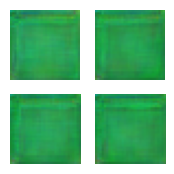

Epoch 8/1000: 100%|██████████| 87/87 [00:04<00:00, 18.22step/s]


Generator Loss: 0.8725636601448059, Discriminator Loss: 1.4189932346343994


Epoch 9/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.27step/s]

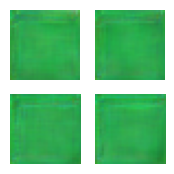

Epoch 9/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]


Generator Loss: 0.8119586706161499, Discriminator Loss: 1.4358843564987183


Epoch 10/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]

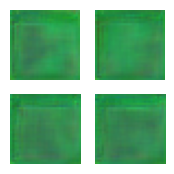

Epoch 10/1000: 100%|██████████| 87/87 [00:04<00:00, 19.80step/s]


Generator Loss: 0.8512176275253296, Discriminator Loss: 1.3666868209838867


Epoch 11/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.60step/s]

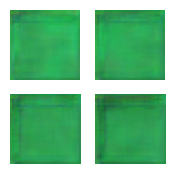

Epoch 11/1000: 100%|██████████| 87/87 [00:04<00:00, 18.90step/s]


Generator Loss: 0.8626468777656555, Discriminator Loss: 1.3877564668655396


Epoch 12/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.69step/s]

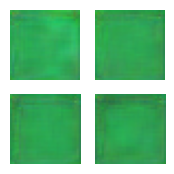

Epoch 12/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]


Generator Loss: 0.8238224387168884, Discriminator Loss: 1.4109554290771484


Epoch 13/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.07step/s]

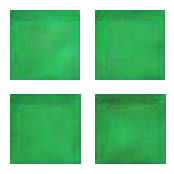

Epoch 13/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 0.833784282207489, Discriminator Loss: 1.3706868886947632


Epoch 14/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.77step/s]

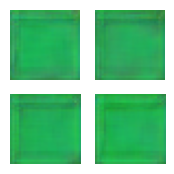

Epoch 14/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 0.9013662338256836, Discriminator Loss: 1.3198398351669312


Epoch 15/1000: 100%|██████████| 87/87 [00:04<00:00, 21.17step/s]

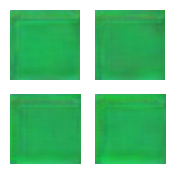

Epoch 15/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 0.8104002475738525, Discriminator Loss: 1.3980623483657837


Epoch 16/1000: 100%|██████████| 87/87 [00:04<00:00, 19.31step/s]

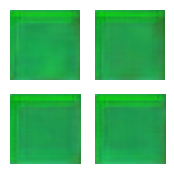

Epoch 16/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 0.964466392993927, Discriminator Loss: 1.2915242910385132


Epoch 17/1000: 100%|██████████| 87/87 [00:04<00:00, 18.81step/s]

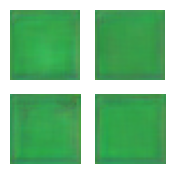

Epoch 17/1000: 100%|██████████| 87/87 [00:04<00:00, 18.02step/s]


Generator Loss: 1.582534670829773, Discriminator Loss: 0.9958961009979248


Epoch 18/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.06step/s]

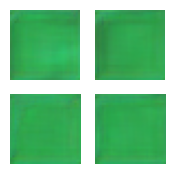

Epoch 18/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 0.9363435506820679, Discriminator Loss: 1.340376615524292


Epoch 19/1000: 100%|██████████| 87/87 [00:04<00:00, 20.81step/s]

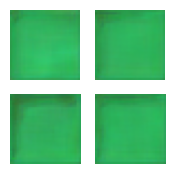

Epoch 19/1000: 100%|██████████| 87/87 [00:04<00:00, 18.23step/s]


Generator Loss: 0.8840298652648926, Discriminator Loss: 1.3358619213104248


Epoch 20/1000:  99%|█████████▉| 86/87 [00:05<00:00, 18.48step/s]

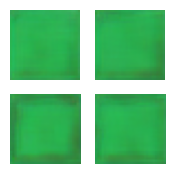

Epoch 20/1000: 100%|██████████| 87/87 [00:05<00:00, 16.18step/s]


Generator Loss: 0.8681582808494568, Discriminator Loss: 1.3470228910446167


Epoch 21/1000:  99%|█████████▉| 86/87 [00:05<00:00, 18.23step/s]

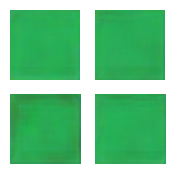

Epoch 21/1000: 100%|██████████| 87/87 [00:05<00:00, 16.45step/s]


Generator Loss: 0.8783898949623108, Discriminator Loss: 1.3250093460083008


Epoch 22/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.60step/s]

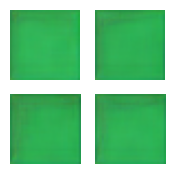

Epoch 22/1000: 100%|██████████| 87/87 [00:05<00:00, 17.07step/s]


Generator Loss: 1.001164436340332, Discriminator Loss: 1.262398600578308


Epoch 23/1000: 100%|██████████| 87/87 [00:04<00:00, 18.15step/s]

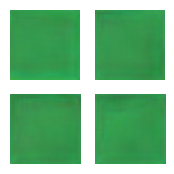

Epoch 23/1000: 100%|██████████| 87/87 [00:05<00:00, 17.39step/s]


Generator Loss: 0.90678870677948, Discriminator Loss: 1.3081063032150269


Epoch 24/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.22step/s]

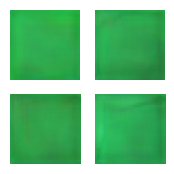

Epoch 24/1000: 100%|██████████| 87/87 [00:04<00:00, 18.03step/s]


Generator Loss: 0.9486910700798035, Discriminator Loss: 1.2838573455810547


Epoch 25/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]

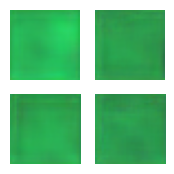

Epoch 25/1000: 100%|██████████| 87/87 [00:04<00:00, 17.67step/s]


Generator Loss: 0.8892830014228821, Discriminator Loss: 1.3364962339401245


Epoch 26/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.37step/s]

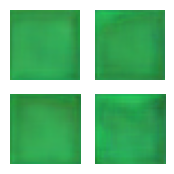

Epoch 26/1000: 100%|██████████| 87/87 [00:04<00:00, 17.76step/s]


Generator Loss: 0.9287846684455872, Discriminator Loss: 1.2771450281143188


Epoch 27/1000: 100%|██████████| 87/87 [00:04<00:00, 19.12step/s]

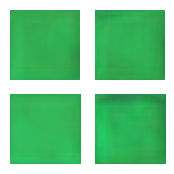

Epoch 27/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 1.026473879814148, Discriminator Loss: 1.2029829025268555


Epoch 28/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.65step/s]

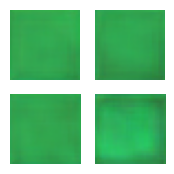

Epoch 28/1000: 100%|██████████| 87/87 [00:05<00:00, 17.27step/s]


Generator Loss: 1.062915563583374, Discriminator Loss: 1.2284350395202637


Epoch 29/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.48step/s]

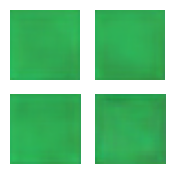

Epoch 29/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 1.0387156009674072, Discriminator Loss: 1.2690668106079102


Epoch 30/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]

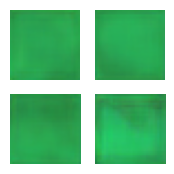

Epoch 30/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 0.9429667592048645, Discriminator Loss: 1.307667851448059


Epoch 31/1000: 100%|██████████| 87/87 [00:04<00:00, 18.98step/s]

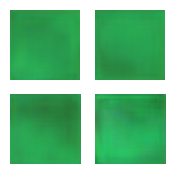

Epoch 31/1000: 100%|██████████| 87/87 [00:04<00:00, 18.67step/s]


Generator Loss: 0.8738438487052917, Discriminator Loss: 1.3624686002731323


Epoch 32/1000: 100%|██████████| 87/87 [00:04<00:00, 19.70step/s]

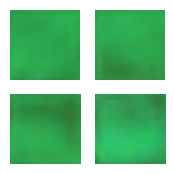

Epoch 32/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]


Generator Loss: 0.8413944244384766, Discriminator Loss: 1.3813952207565308


Epoch 33/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]

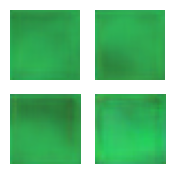

Epoch 33/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]


Generator Loss: 0.8342098593711853, Discriminator Loss: 1.3921449184417725


Epoch 34/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.73step/s]

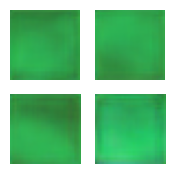

Epoch 34/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 0.8031253814697266, Discriminator Loss: 1.400978922843933


Epoch 35/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.19step/s]

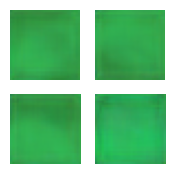

Epoch 35/1000: 100%|██████████| 87/87 [00:04<00:00, 18.31step/s]


Generator Loss: 0.7852197289466858, Discriminator Loss: 1.4150935411453247


Epoch 36/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.08step/s]

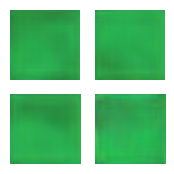

Epoch 36/1000: 100%|██████████| 87/87 [00:05<00:00, 17.36step/s]


Generator Loss: 0.8445559740066528, Discriminator Loss: 1.3357963562011719


Epoch 37/1000: 100%|██████████| 87/87 [00:05<00:00, 16.15step/s]

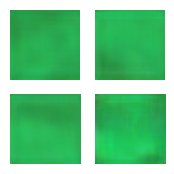

Epoch 37/1000: 100%|██████████| 87/87 [00:05<00:00, 15.57step/s]


Generator Loss: 0.8181202411651611, Discriminator Loss: 1.3690855503082275


Epoch 38/1000: 100%|██████████| 87/87 [00:05<00:00, 16.44step/s]

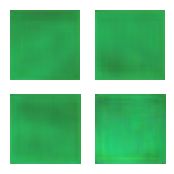

Epoch 38/1000: 100%|██████████| 87/87 [00:05<00:00, 15.16step/s]


Generator Loss: 0.8112915754318237, Discriminator Loss: 1.3752334117889404


Epoch 39/1000: 100%|██████████| 87/87 [00:05<00:00, 16.33step/s]

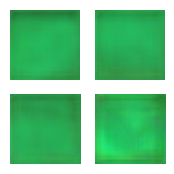

Epoch 39/1000: 100%|██████████| 87/87 [00:05<00:00, 15.77step/s]


Generator Loss: 0.8096656203269958, Discriminator Loss: 1.374290943145752


Epoch 40/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.35step/s]

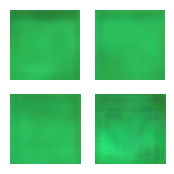

Epoch 40/1000: 100%|██████████| 87/87 [00:05<00:00, 15.09step/s]


Generator Loss: 0.8181142807006836, Discriminator Loss: 1.3517471551895142


Epoch 41/1000: 100%|██████████| 87/87 [00:05<00:00, 15.07step/s]

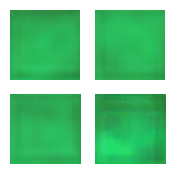

Epoch 41/1000: 100%|██████████| 87/87 [00:05<00:00, 15.67step/s]


Generator Loss: 0.8290504217147827, Discriminator Loss: 1.3496410846710205


Epoch 42/1000: 100%|██████████| 87/87 [00:05<00:00, 15.97step/s]

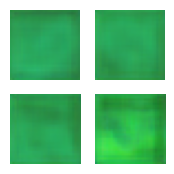

Epoch 42/1000: 100%|██████████| 87/87 [00:05<00:00, 14.76step/s]


Generator Loss: 0.8634050488471985, Discriminator Loss: 1.3246175050735474


Epoch 43/1000: 100%|██████████| 87/87 [00:05<00:00, 14.12step/s]

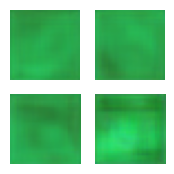

Epoch 43/1000: 100%|██████████| 87/87 [00:05<00:00, 14.57step/s]


Generator Loss: 0.989062488079071, Discriminator Loss: 1.2219687700271606


Epoch 44/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.12step/s]

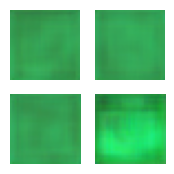

Epoch 44/1000: 100%|██████████| 87/87 [00:05<00:00, 14.90step/s]


Generator Loss: 1.031158208847046, Discriminator Loss: 1.2435822486877441


Epoch 45/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.56step/s]

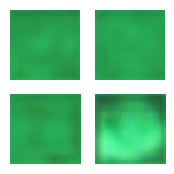

Epoch 45/1000: 100%|██████████| 87/87 [00:05<00:00, 14.52step/s]


Generator Loss: 1.0605851411819458, Discriminator Loss: 1.1682913303375244


Epoch 46/1000: 100%|██████████| 87/87 [00:05<00:00, 16.60step/s]

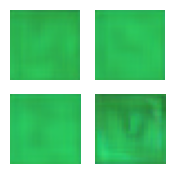

Epoch 46/1000: 100%|██████████| 87/87 [00:05<00:00, 15.47step/s]


Generator Loss: 1.1134734153747559, Discriminator Loss: 1.1417185068130493


Epoch 47/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.90step/s]

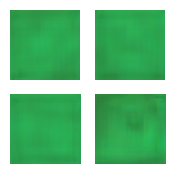

Epoch 47/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 1.0346282720565796, Discriminator Loss: 1.2621415853500366


Epoch 48/1000: 100%|██████████| 87/87 [00:04<00:00, 19.55step/s]

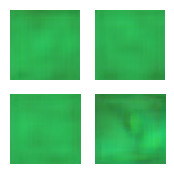

Epoch 48/1000: 100%|██████████| 87/87 [00:04<00:00, 19.08step/s]


Generator Loss: 0.9541289210319519, Discriminator Loss: 1.3082259893417358


Epoch 49/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.60step/s]

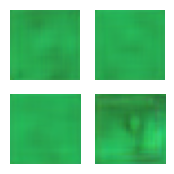

Epoch 49/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 0.9690855145454407, Discriminator Loss: 1.2678533792495728


Epoch 50/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]

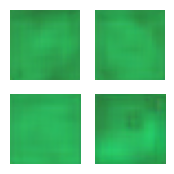

Epoch 50/1000: 100%|██████████| 87/87 [00:04<00:00, 18.10step/s]


Generator Loss: 1.0799765586853027, Discriminator Loss: 1.1916518211364746


Epoch 51/1000: 100%|██████████| 87/87 [00:04<00:00, 20.85step/s]

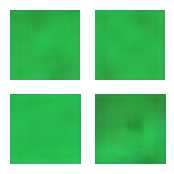

Epoch 51/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 1.127375841140747, Discriminator Loss: 1.11758291721344


Epoch 52/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.53step/s]

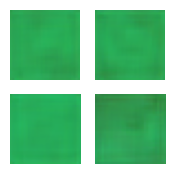

Epoch 52/1000: 100%|██████████| 87/87 [00:04<00:00, 18.79step/s]


Generator Loss: 1.2772208452224731, Discriminator Loss: 1.043707251548767


Epoch 53/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.21step/s]

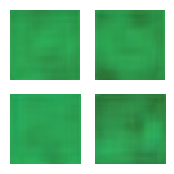

Epoch 53/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 1.1418960094451904, Discriminator Loss: 1.1887816190719604


Epoch 54/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.91step/s]

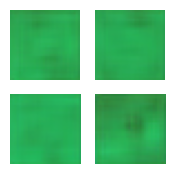

Epoch 54/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 1.2701263427734375, Discriminator Loss: 1.0771799087524414


Epoch 55/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.15step/s]

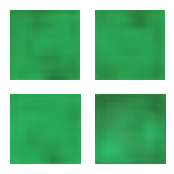

Epoch 55/1000: 100%|██████████| 87/87 [00:04<00:00, 17.98step/s]


Generator Loss: 1.266494870185852, Discriminator Loss: 1.0688517093658447


Epoch 56/1000: 100%|██████████| 87/87 [00:04<00:00, 20.34step/s]

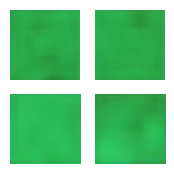

Epoch 56/1000: 100%|██████████| 87/87 [00:04<00:00, 19.07step/s]


Generator Loss: 1.2757850885391235, Discriminator Loss: 1.0701916217803955


Epoch 57/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.40step/s]

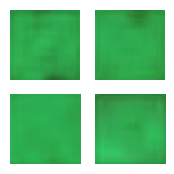

Epoch 57/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 1.284905195236206, Discriminator Loss: 1.0530798435211182


Epoch 58/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.07step/s]

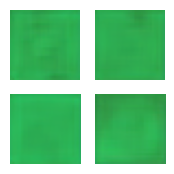

Epoch 58/1000: 100%|██████████| 87/87 [00:04<00:00, 18.99step/s]


Generator Loss: 1.174867033958435, Discriminator Loss: 1.2143430709838867


Epoch 59/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.03step/s]

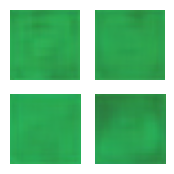

Epoch 59/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 1.1943016052246094, Discriminator Loss: 1.1730784177780151


Epoch 60/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]

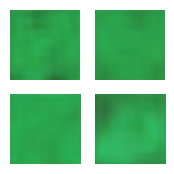

Epoch 60/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 1.04293692111969, Discriminator Loss: 1.2364513874053955


Epoch 61/1000: 100%|██████████| 87/87 [00:04<00:00, 18.37step/s]

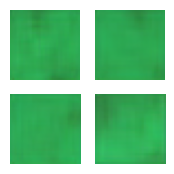

Epoch 61/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 1.0300045013427734, Discriminator Loss: 1.310884714126587


Epoch 62/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.09step/s]

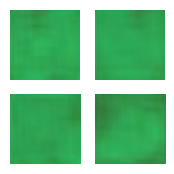

Epoch 62/1000: 100%|██████████| 87/87 [00:04<00:00, 17.80step/s]


Generator Loss: 0.9948402643203735, Discriminator Loss: 1.2774617671966553


Epoch 63/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.77step/s]

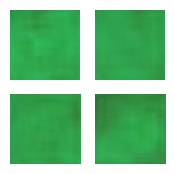

Epoch 63/1000: 100%|██████████| 87/87 [00:04<00:00, 17.95step/s]


Generator Loss: 1.05731201171875, Discriminator Loss: 1.1957756280899048


Epoch 64/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.71step/s]

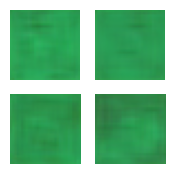

Epoch 64/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 1.0853568315505981, Discriminator Loss: 1.219611406326294


Epoch 65/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.10step/s]

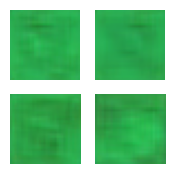

Epoch 65/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 1.1303722858428955, Discriminator Loss: 1.154630422592163


Epoch 66/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.12step/s]

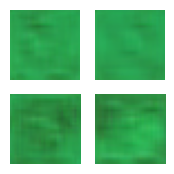

Epoch 66/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 1.1613777875900269, Discriminator Loss: 1.126186728477478


Epoch 67/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.57step/s]

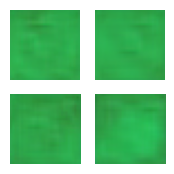

Epoch 67/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]


Generator Loss: 1.2302476167678833, Discriminator Loss: 1.1523724794387817


Epoch 68/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.34step/s]

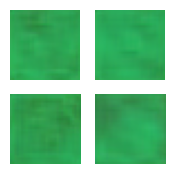

Epoch 68/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 1.0576051473617554, Discriminator Loss: 1.2689204216003418


Epoch 69/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.30step/s]

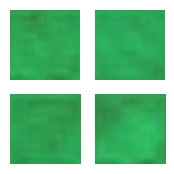

Epoch 69/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 1.1420555114746094, Discriminator Loss: 1.167056679725647


Epoch 70/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.37step/s]

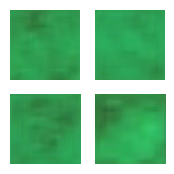

Epoch 70/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 1.1450207233428955, Discriminator Loss: 1.186922311782837


Epoch 71/1000: 100%|██████████| 87/87 [00:04<00:00, 20.15step/s]

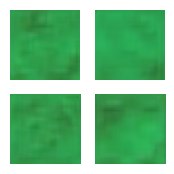

Epoch 71/1000: 100%|██████████| 87/87 [00:04<00:00, 17.99step/s]


Generator Loss: 1.0441787242889404, Discriminator Loss: 1.2671539783477783


Epoch 72/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.92step/s]

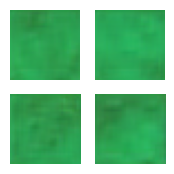

Epoch 72/1000: 100%|██████████| 87/87 [00:04<00:00, 17.71step/s]


Generator Loss: 1.144092321395874, Discriminator Loss: 1.1423755884170532


Epoch 73/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.34step/s]

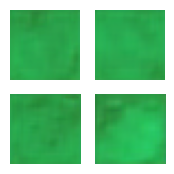

Epoch 73/1000: 100%|██████████| 87/87 [00:04<00:00, 17.71step/s]


Generator Loss: 1.1086355447769165, Discriminator Loss: 1.2191368341445923


Epoch 74/1000: 100%|██████████| 87/87 [00:04<00:00, 17.39step/s]

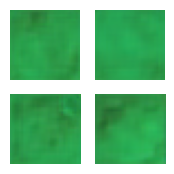

Epoch 74/1000: 100%|██████████| 87/87 [00:05<00:00, 17.22step/s]


Generator Loss: 1.0944242477416992, Discriminator Loss: 1.205237627029419


Epoch 75/1000: 100%|██████████| 87/87 [00:04<00:00, 20.12step/s]

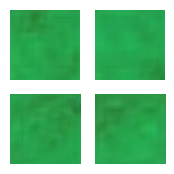

Epoch 75/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 1.0455082654953003, Discriminator Loss: 1.2200634479522705


Epoch 76/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]

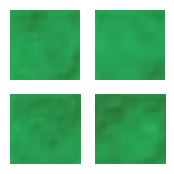

Epoch 76/1000: 100%|██████████| 87/87 [00:04<00:00, 17.72step/s]


Generator Loss: 1.1730958223342896, Discriminator Loss: 1.1202505826950073


Epoch 77/1000: 100%|██████████| 87/87 [00:04<00:00, 17.88step/s]

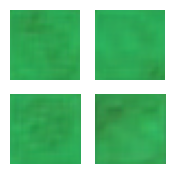

Epoch 77/1000: 100%|██████████| 87/87 [00:04<00:00, 17.83step/s]


Generator Loss: 1.149629831314087, Discriminator Loss: 1.1290394067764282


Epoch 78/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.50step/s]

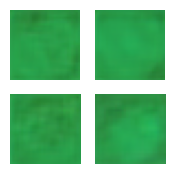

Epoch 78/1000: 100%|██████████| 87/87 [00:04<00:00, 18.35step/s]


Generator Loss: 1.485538363456726, Discriminator Loss: 1.007733941078186


Epoch 79/1000: 100%|██████████| 87/87 [00:04<00:00, 19.97step/s]

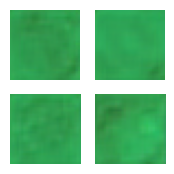

Epoch 79/1000: 100%|██████████| 87/87 [00:04<00:00, 18.60step/s]


Generator Loss: 1.3184599876403809, Discriminator Loss: 1.0582144260406494


Epoch 80/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.76step/s]

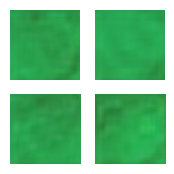

Epoch 80/1000: 100%|██████████| 87/87 [00:04<00:00, 17.97step/s]


Generator Loss: 1.2967697381973267, Discriminator Loss: 1.1326879262924194


Epoch 81/1000: 100%|██████████| 87/87 [00:04<00:00, 19.18step/s]

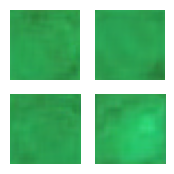

Epoch 81/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 1.4352539777755737, Discriminator Loss: 0.9221859574317932


Epoch 82/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.16step/s]

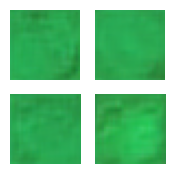

Epoch 82/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 1.4759244918823242, Discriminator Loss: 1.0850403308868408


Epoch 83/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.64step/s]

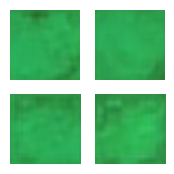

Epoch 83/1000: 100%|██████████| 87/87 [00:04<00:00, 18.09step/s]


Generator Loss: 1.2062135934829712, Discriminator Loss: 1.1809629201889038


Epoch 84/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.17step/s]

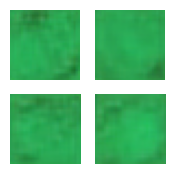

Epoch 84/1000: 100%|██████████| 87/87 [00:04<00:00, 17.54step/s]


Generator Loss: 1.2212406396865845, Discriminator Loss: 1.1410400867462158


Epoch 85/1000:  99%|█████████▉| 86/87 [00:05<00:00, 18.36step/s]

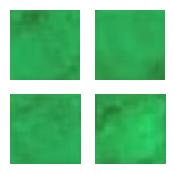

Epoch 85/1000: 100%|██████████| 87/87 [00:05<00:00, 15.49step/s]


Generator Loss: 1.2281204462051392, Discriminator Loss: 1.1541988849639893


Epoch 86/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.61step/s]

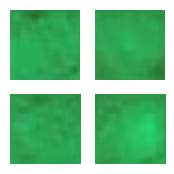

Epoch 86/1000: 100%|██████████| 87/87 [00:05<00:00, 14.98step/s]


Generator Loss: 1.0930410623550415, Discriminator Loss: 1.2680009603500366


Epoch 87/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.55step/s]

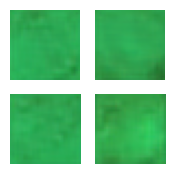

Epoch 87/1000: 100%|██████████| 87/87 [00:05<00:00, 15.64step/s]


Generator Loss: 1.2926275730133057, Discriminator Loss: 1.0867968797683716


Epoch 88/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.68step/s]

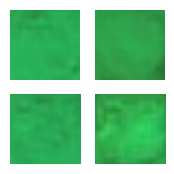

Epoch 88/1000: 100%|██████████| 87/87 [00:05<00:00, 15.47step/s]


Generator Loss: 1.3502146005630493, Discriminator Loss: 1.0862529277801514


Epoch 89/1000: 100%|██████████| 87/87 [00:05<00:00, 16.92step/s]

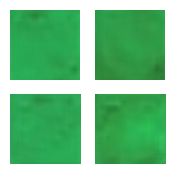

Epoch 89/1000: 100%|██████████| 87/87 [00:05<00:00, 15.50step/s]


Generator Loss: 1.2359539270401, Discriminator Loss: 1.1691256761550903


Epoch 90/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.96step/s]

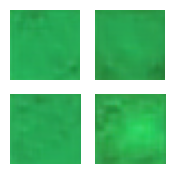

Epoch 90/1000: 100%|██████████| 87/87 [00:05<00:00, 14.89step/s]


Generator Loss: 1.1100558042526245, Discriminator Loss: 1.1966606378555298


Epoch 91/1000: 100%|██████████| 87/87 [00:05<00:00, 15.40step/s]

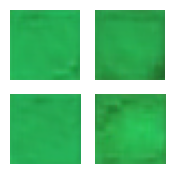

Epoch 91/1000: 100%|██████████| 87/87 [00:05<00:00, 14.79step/s]


Generator Loss: 1.2159923315048218, Discriminator Loss: 1.157386302947998


Epoch 92/1000: 100%|██████████| 87/87 [00:05<00:00, 14.91step/s]

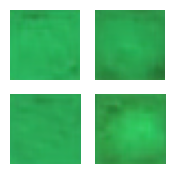

Epoch 92/1000: 100%|██████████| 87/87 [00:05<00:00, 14.66step/s]


Generator Loss: 1.130122423171997, Discriminator Loss: 1.2519181966781616


Epoch 93/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.01step/s]

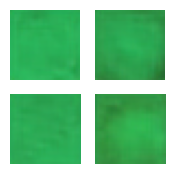

Epoch 93/1000: 100%|██████████| 87/87 [00:05<00:00, 14.91step/s]


Generator Loss: 1.106926679611206, Discriminator Loss: 1.1896806955337524


Epoch 94/1000: 100%|██████████| 87/87 [00:05<00:00, 14.68step/s]

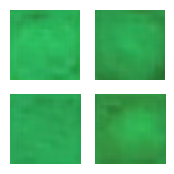

Epoch 94/1000: 100%|██████████| 87/87 [00:05<00:00, 14.55step/s]


Generator Loss: 1.0696877241134644, Discriminator Loss: 1.2287667989730835


Epoch 95/1000: 100%|██████████| 87/87 [00:04<00:00, 20.51step/s]

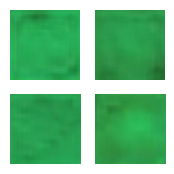

Epoch 95/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 1.1495110988616943, Discriminator Loss: 1.159492015838623


Epoch 96/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]

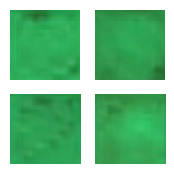

Epoch 96/1000: 100%|██████████| 87/87 [00:04<00:00, 17.65step/s]


Generator Loss: 1.0080327987670898, Discriminator Loss: 1.297369122505188


Epoch 97/1000: 100%|██████████| 87/87 [00:04<00:00, 17.85step/s]

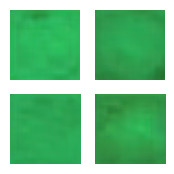

Epoch 97/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]


Generator Loss: 1.1057969331741333, Discriminator Loss: 1.2099120616912842


Epoch 98/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.88step/s]

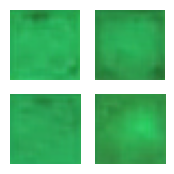

Epoch 98/1000: 100%|██████████| 87/87 [00:04<00:00, 17.77step/s]


Generator Loss: 1.072957158088684, Discriminator Loss: 1.2087785005569458


Epoch 99/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.62step/s]

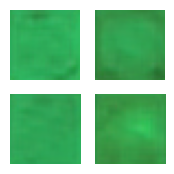

Epoch 99/1000: 100%|██████████| 87/87 [00:04<00:00, 18.28step/s]


Generator Loss: 1.184695839881897, Discriminator Loss: 1.0989707708358765


Epoch 100/1000: 100%|██████████| 87/87 [00:04<00:00, 19.55step/s]

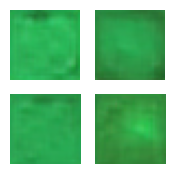

Epoch 100/1000: 100%|██████████| 87/87 [00:04<00:00, 17.91step/s]


Generator Loss: 1.3445528745651245, Discriminator Loss: 1.0297584533691406


Epoch 101/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]

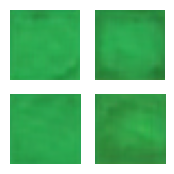

Epoch 101/1000: 100%|██████████| 87/87 [00:04<00:00, 18.18step/s]


Generator Loss: 1.5599193572998047, Discriminator Loss: 0.8564409017562866


Epoch 102/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.14step/s]

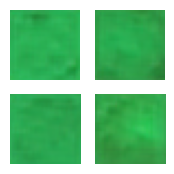

Epoch 102/1000: 100%|██████████| 87/87 [00:04<00:00, 17.44step/s]


Generator Loss: 1.3294265270233154, Discriminator Loss: 1.0548757314682007


Epoch 103/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.50step/s]

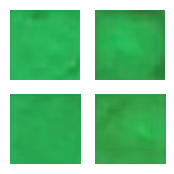

Epoch 103/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 1.4072660207748413, Discriminator Loss: 0.9837990999221802


Epoch 104/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.39step/s]

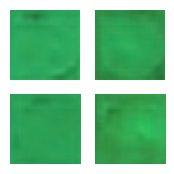

Epoch 104/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 1.655993938446045, Discriminator Loss: 0.9061630964279175


Epoch 105/1000: 100%|██████████| 87/87 [00:04<00:00, 19.50step/s]

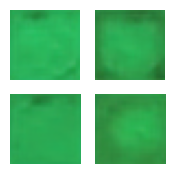

Epoch 105/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 1.4205623865127563, Discriminator Loss: 1.1095539331436157


Epoch 106/1000: 100%|██████████| 87/87 [00:04<00:00, 19.67step/s]

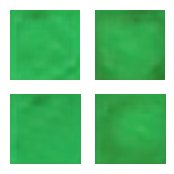

Epoch 106/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]


Generator Loss: 1.7673742771148682, Discriminator Loss: 0.8962692022323608


Epoch 107/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.58step/s]

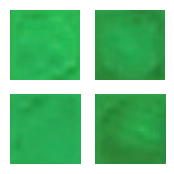

Epoch 107/1000: 100%|██████████| 87/87 [00:04<00:00, 17.83step/s]


Generator Loss: 1.4910911321640015, Discriminator Loss: 0.9486132264137268


Epoch 108/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.12step/s]

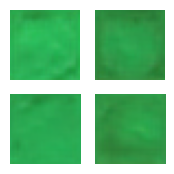

Epoch 108/1000: 100%|██████████| 87/87 [00:04<00:00, 17.71step/s]


Generator Loss: 1.3223397731781006, Discriminator Loss: 1.1100014448165894


Epoch 109/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.58step/s]

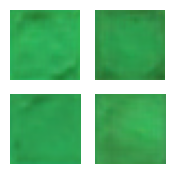

Epoch 109/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]


Generator Loss: 1.1937552690505981, Discriminator Loss: 1.1684941053390503


Epoch 110/1000: 100%|██████████| 87/87 [00:04<00:00, 19.65step/s]

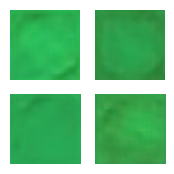

Epoch 110/1000: 100%|██████████| 87/87 [00:05<00:00, 17.16step/s]


Generator Loss: 1.10924232006073, Discriminator Loss: 1.191247820854187


Epoch 111/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.11step/s]

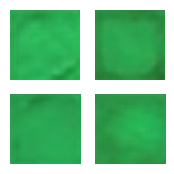

Epoch 111/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]


Generator Loss: 1.2211706638336182, Discriminator Loss: 1.1636408567428589


Epoch 112/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.00step/s]

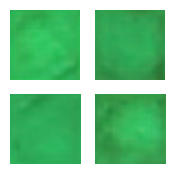

Epoch 112/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]


Generator Loss: 1.3754303455352783, Discriminator Loss: 0.9729593992233276


Epoch 113/1000: 100%|██████████| 87/87 [00:04<00:00, 17.64step/s]

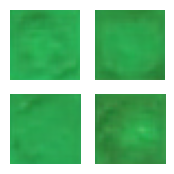

Epoch 113/1000: 100%|██████████| 87/87 [00:04<00:00, 17.45step/s]


Generator Loss: 1.744966745376587, Discriminator Loss: 0.8526573777198792


Epoch 114/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.86step/s]

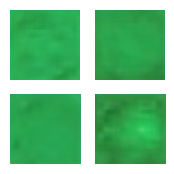

Epoch 114/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 1.8348281383514404, Discriminator Loss: 0.8006051778793335


Epoch 115/1000: 100%|██████████| 87/87 [00:04<00:00, 19.49step/s]

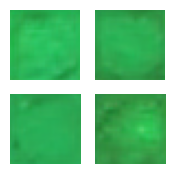

Epoch 115/1000: 100%|██████████| 87/87 [00:04<00:00, 19.09step/s]


Generator Loss: 1.4224714040756226, Discriminator Loss: 1.1186400651931763


Epoch 116/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]

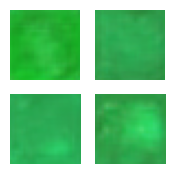

Epoch 116/1000: 100%|██████████| 87/87 [00:04<00:00, 17.59step/s]


Generator Loss: 1.5517261028289795, Discriminator Loss: 0.9075940847396851


Epoch 117/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.33step/s]

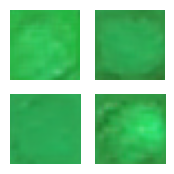

Epoch 117/1000: 100%|██████████| 87/87 [00:04<00:00, 17.52step/s]


Generator Loss: 1.516698956489563, Discriminator Loss: 0.9821261763572693


Epoch 118/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]

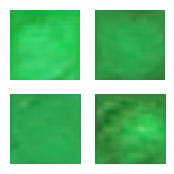

Epoch 118/1000: 100%|██████████| 87/87 [00:05<00:00, 16.89step/s]


Generator Loss: 1.506819486618042, Discriminator Loss: 1.0088061094284058


Epoch 119/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.72step/s]

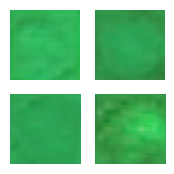

Epoch 119/1000: 100%|██████████| 87/87 [00:05<00:00, 16.63step/s]


Generator Loss: 1.3744654655456543, Discriminator Loss: 1.122491478919983


Epoch 120/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]

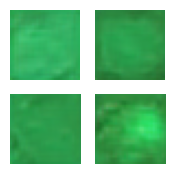

Epoch 120/1000: 100%|██████████| 87/87 [00:04<00:00, 17.51step/s]


Generator Loss: 1.599251627922058, Discriminator Loss: 0.9491742849349976


Epoch 121/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.67step/s]

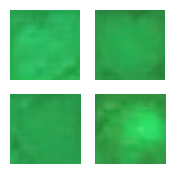

Epoch 121/1000: 100%|██████████| 87/87 [00:04<00:00, 17.73step/s]


Generator Loss: 1.324271321296692, Discriminator Loss: 1.161281943321228


Epoch 122/1000: 100%|██████████| 87/87 [00:04<00:00, 16.74step/s]

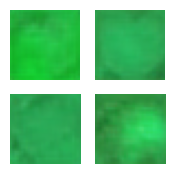

Epoch 122/1000: 100%|██████████| 87/87 [00:05<00:00, 16.93step/s]


Generator Loss: 1.5056134462356567, Discriminator Loss: 0.9412621855735779


Epoch 123/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.15step/s]

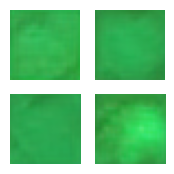

Epoch 123/1000: 100%|██████████| 87/87 [00:04<00:00, 17.62step/s]


Generator Loss: 1.4975132942199707, Discriminator Loss: 0.997032105922699


Epoch 124/1000: 100%|██████████| 87/87 [00:04<00:00, 18.66step/s]

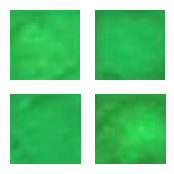

Epoch 124/1000: 100%|██████████| 87/87 [00:05<00:00, 17.06step/s]


Generator Loss: 1.5049735307693481, Discriminator Loss: 1.0560520887374878


Epoch 125/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.58step/s]

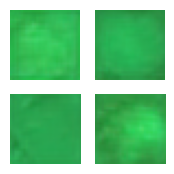

Epoch 125/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 1.703203558921814, Discriminator Loss: 0.8738532066345215


Epoch 126/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.97step/s]

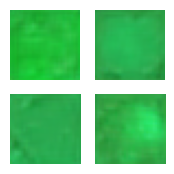

Epoch 126/1000: 100%|██████████| 87/87 [00:04<00:00, 18.93step/s]


Generator Loss: 1.426928162574768, Discriminator Loss: 1.106421947479248


Epoch 127/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.24step/s]

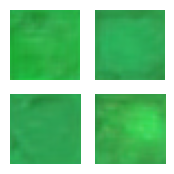

Epoch 127/1000: 100%|██████████| 87/87 [00:04<00:00, 18.50step/s]


Generator Loss: 1.5588515996932983, Discriminator Loss: 1.0470982789993286


Epoch 128/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.23step/s]

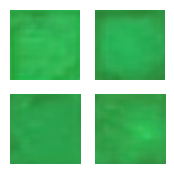

Epoch 128/1000: 100%|██████████| 87/87 [00:04<00:00, 18.39step/s]


Generator Loss: 1.9151111841201782, Discriminator Loss: 0.7815053462982178


Epoch 129/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.10step/s]

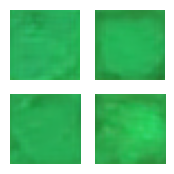

Epoch 129/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 1.6854970455169678, Discriminator Loss: 1.032448649406433


Epoch 130/1000: 100%|██████████| 87/87 [00:04<00:00, 20.12step/s]

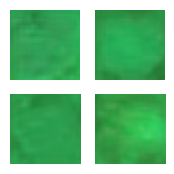

Epoch 130/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 1.308884620666504, Discriminator Loss: 1.167070746421814


Epoch 131/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.52step/s]

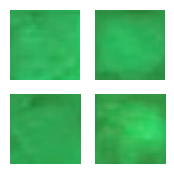

Epoch 131/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 1.536798119544983, Discriminator Loss: 1.046233057975769


Epoch 132/1000: 100%|██████████| 87/87 [00:05<00:00, 17.30step/s]

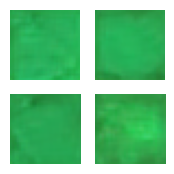

Epoch 132/1000: 100%|██████████| 87/87 [00:05<00:00, 15.67step/s]


Generator Loss: 1.1563622951507568, Discriminator Loss: 1.2713614702224731


Epoch 133/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.31step/s]

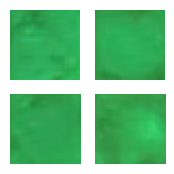

Epoch 133/1000: 100%|██████████| 87/87 [00:05<00:00, 15.81step/s]


Generator Loss: 1.254891037940979, Discriminator Loss: 1.2085542678833008


Epoch 134/1000: 100%|██████████| 87/87 [00:05<00:00, 15.48step/s]

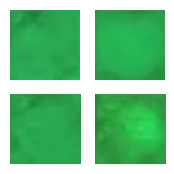

Epoch 134/1000: 100%|██████████| 87/87 [00:05<00:00, 15.12step/s]


Generator Loss: 1.9317504167556763, Discriminator Loss: 0.8608540296554565


Epoch 135/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.85step/s]

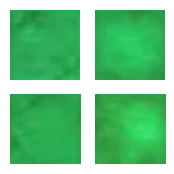

Epoch 135/1000: 100%|██████████| 87/87 [00:05<00:00, 16.04step/s]


Generator Loss: 1.3272663354873657, Discriminator Loss: 1.1253166198730469


Epoch 136/1000: 100%|██████████| 87/87 [00:05<00:00, 15.62step/s]

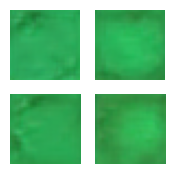

Epoch 136/1000: 100%|██████████| 87/87 [00:05<00:00, 15.15step/s]


Generator Loss: 1.2381585836410522, Discriminator Loss: 1.116768479347229


Epoch 137/1000: 100%|██████████| 87/87 [00:05<00:00, 15.54step/s]

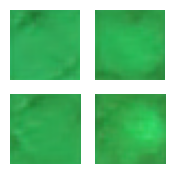

Epoch 137/1000: 100%|██████████| 87/87 [00:05<00:00, 15.15step/s]


Generator Loss: 1.3058488368988037, Discriminator Loss: 1.0681991577148438


Epoch 138/1000: 100%|██████████| 87/87 [00:05<00:00, 14.89step/s]

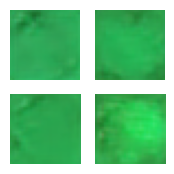

Epoch 138/1000: 100%|██████████| 87/87 [00:05<00:00, 14.51step/s]


Generator Loss: 1.3841748237609863, Discriminator Loss: 1.056306004524231


Epoch 139/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.93step/s]

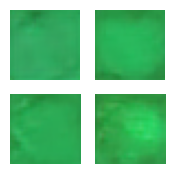

Epoch 139/1000: 100%|██████████| 87/87 [00:05<00:00, 14.54step/s]


Generator Loss: 1.36266028881073, Discriminator Loss: 1.0620629787445068


Epoch 140/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.61step/s]

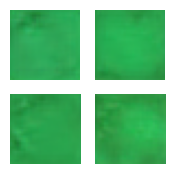

Epoch 140/1000: 100%|██████████| 87/87 [00:05<00:00, 15.07step/s]


Generator Loss: 1.336100697517395, Discriminator Loss: 1.078282356262207


Epoch 141/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.40step/s]

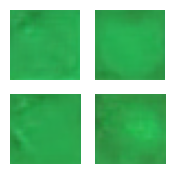

Epoch 141/1000: 100%|██████████| 87/87 [00:05<00:00, 14.75step/s]


Generator Loss: 1.6302549839019775, Discriminator Loss: 0.9148807525634766


Epoch 142/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.52step/s]

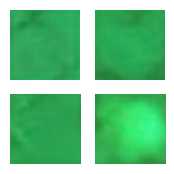

Epoch 142/1000: 100%|██████████| 87/87 [00:05<00:00, 16.92step/s]


Generator Loss: 1.7558053731918335, Discriminator Loss: 0.8196524381637573


Epoch 143/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.78step/s]

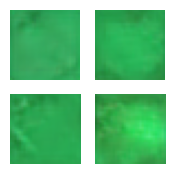

Epoch 143/1000: 100%|██████████| 87/87 [00:04<00:00, 18.73step/s]


Generator Loss: 1.5516849756240845, Discriminator Loss: 0.9210113883018494


Epoch 144/1000: 100%|██████████| 87/87 [00:04<00:00, 19.19step/s]

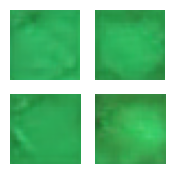

Epoch 144/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 1.8067933320999146, Discriminator Loss: 0.9217186570167542


Epoch 145/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.08step/s]

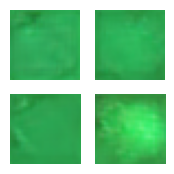

Epoch 145/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 1.5843344926834106, Discriminator Loss: 1.108338713645935


Epoch 146/1000: 100%|██████████| 87/87 [00:04<00:00, 19.47step/s]

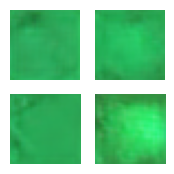

Epoch 146/1000: 100%|██████████| 87/87 [00:04<00:00, 18.19step/s]


Generator Loss: 1.5812228918075562, Discriminator Loss: 0.9108805060386658


Epoch 147/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.07step/s]

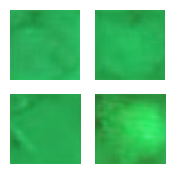

Epoch 147/1000: 100%|██████████| 87/87 [00:04<00:00, 19.07step/s]


Generator Loss: 1.386160969734192, Discriminator Loss: 1.1246802806854248


Epoch 148/1000: 100%|██████████| 87/87 [00:04<00:00, 19.86step/s]

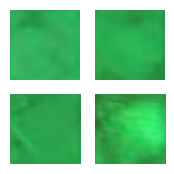

Epoch 148/1000: 100%|██████████| 87/87 [00:04<00:00, 17.49step/s]


Generator Loss: 1.5889594554901123, Discriminator Loss: 0.9188206195831299


Epoch 149/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.97step/s]

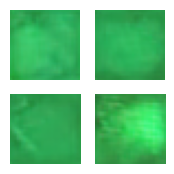

Epoch 149/1000: 100%|██████████| 87/87 [00:04<00:00, 18.18step/s]


Generator Loss: 1.7407331466674805, Discriminator Loss: 0.8229309320449829


Epoch 150/1000: 100%|██████████| 87/87 [00:04<00:00, 19.47step/s]

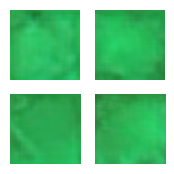

Epoch 150/1000: 100%|██████████| 87/87 [00:04<00:00, 19.03step/s]


Generator Loss: 2.2515554428100586, Discriminator Loss: 0.761037290096283


Epoch 151/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.21step/s]

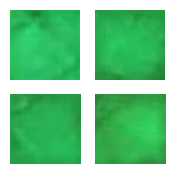

Epoch 151/1000: 100%|██████████| 87/87 [00:04<00:00, 18.39step/s]


Generator Loss: 1.8114055395126343, Discriminator Loss: 0.9321774840354919


Epoch 152/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.21step/s]

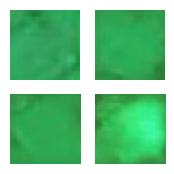

Epoch 152/1000: 100%|██████████| 87/87 [00:04<00:00, 17.53step/s]


Generator Loss: 1.9969850778579712, Discriminator Loss: 0.7999243140220642


Epoch 153/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.95step/s]

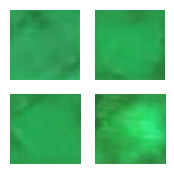

Epoch 153/1000: 100%|██████████| 87/87 [00:04<00:00, 18.03step/s]


Generator Loss: 1.895359754562378, Discriminator Loss: 0.9354735016822815


Epoch 154/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.35step/s]

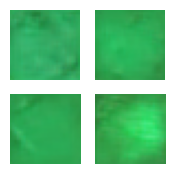

Epoch 154/1000: 100%|██████████| 87/87 [00:04<00:00, 19.68step/s]


Generator Loss: 1.5373640060424805, Discriminator Loss: 0.9743780493736267


Epoch 155/1000: 100%|██████████| 87/87 [00:04<00:00, 16.55step/s]

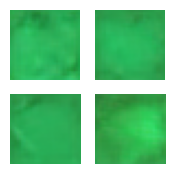

Epoch 155/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 1.3740698099136353, Discriminator Loss: 1.0696667432785034


Epoch 156/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.16step/s]

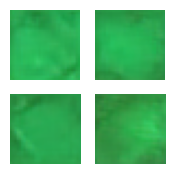

Epoch 156/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]


Generator Loss: 1.8285541534423828, Discriminator Loss: 0.9402035474777222


Epoch 157/1000: 100%|██████████| 87/87 [00:04<00:00, 17.78step/s]

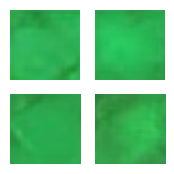

Epoch 157/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 1.8999910354614258, Discriminator Loss: 0.7459277510643005


Epoch 158/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]

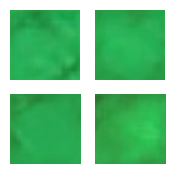

Epoch 158/1000: 100%|██████████| 87/87 [00:04<00:00, 17.43step/s]


Generator Loss: 1.6351970434188843, Discriminator Loss: 1.0594053268432617


Epoch 159/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]

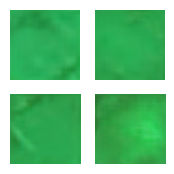

Epoch 159/1000: 100%|██████████| 87/87 [00:04<00:00, 18.27step/s]


Generator Loss: 1.6318861246109009, Discriminator Loss: 0.9438657164573669


Epoch 160/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.39step/s]

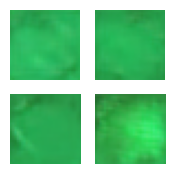

Epoch 160/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 1.5045918226242065, Discriminator Loss: 1.1176762580871582


Epoch 161/1000: 100%|██████████| 87/87 [00:04<00:00, 18.78step/s]

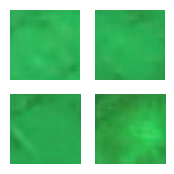

Epoch 161/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 1.7268863916397095, Discriminator Loss: 0.9069090485572815


Epoch 162/1000: 100%|██████████| 87/87 [00:04<00:00, 16.85step/s]

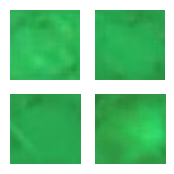

Epoch 162/1000: 100%|██████████| 87/87 [00:04<00:00, 17.57step/s]


Generator Loss: 1.6458603143692017, Discriminator Loss: 1.0106030702590942


Epoch 163/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.43step/s]

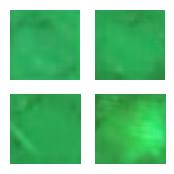

Epoch 163/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 1.802150011062622, Discriminator Loss: 0.843655526638031


Epoch 164/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.77step/s]

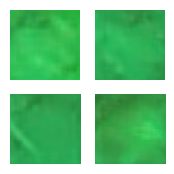

Epoch 164/1000: 100%|██████████| 87/87 [00:04<00:00, 18.08step/s]


Generator Loss: 1.7393921613693237, Discriminator Loss: 0.9695400595664978


Epoch 165/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.25step/s]

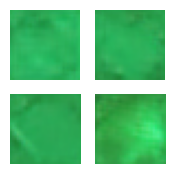

Epoch 165/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 1.4990023374557495, Discriminator Loss: 0.9877775311470032


Epoch 166/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.21step/s]

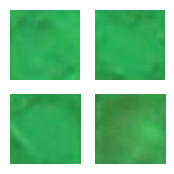

Epoch 166/1000: 100%|██████████| 87/87 [00:04<00:00, 18.60step/s]


Generator Loss: 1.6832698583602905, Discriminator Loss: 0.9629490375518799


Epoch 167/1000: 100%|██████████| 87/87 [00:04<00:00, 19.94step/s]

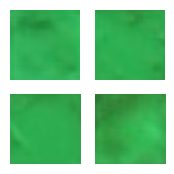

Epoch 167/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 1.7489840984344482, Discriminator Loss: 0.8595072627067566


Epoch 168/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.02step/s]

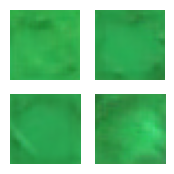

Epoch 168/1000: 100%|██████████| 87/87 [00:04<00:00, 17.80step/s]


Generator Loss: 1.8510642051696777, Discriminator Loss: 0.7698726654052734


Epoch 169/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.12step/s]

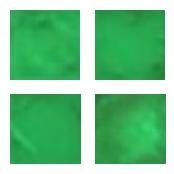

Epoch 169/1000: 100%|██████████| 87/87 [00:05<00:00, 17.33step/s]


Generator Loss: 1.6721336841583252, Discriminator Loss: 0.9372266530990601


Epoch 170/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.61step/s]

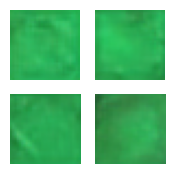

Epoch 170/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 2.262235164642334, Discriminator Loss: 0.7215129137039185


Epoch 171/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.37step/s]

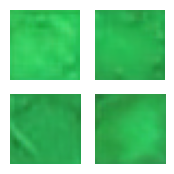

Epoch 171/1000: 100%|██████████| 87/87 [00:04<00:00, 18.15step/s]


Generator Loss: 1.7371665239334106, Discriminator Loss: 0.9113498330116272


Epoch 172/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]

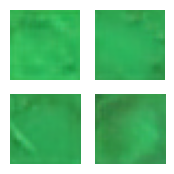

Epoch 172/1000: 100%|██████████| 87/87 [00:04<00:00, 17.58step/s]


Generator Loss: 2.053311347961426, Discriminator Loss: 0.8339526057243347


Epoch 173/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.90step/s]

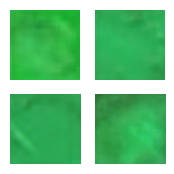

Epoch 173/1000: 100%|██████████| 87/87 [00:04<00:00, 18.15step/s]


Generator Loss: 2.0652072429656982, Discriminator Loss: 0.7977839708328247


Epoch 174/1000: 100%|██████████| 87/87 [00:04<00:00, 19.94step/s]

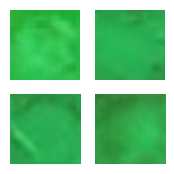

Epoch 174/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 2.0408010482788086, Discriminator Loss: 0.7701879143714905


Epoch 175/1000: 100%|██████████| 87/87 [00:04<00:00, 19.44step/s]

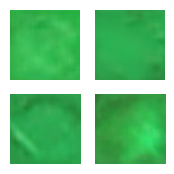

Epoch 175/1000: 100%|██████████| 87/87 [00:04<00:00, 18.31step/s]


Generator Loss: 1.6973813772201538, Discriminator Loss: 1.0251185894012451


Epoch 176/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.50step/s]

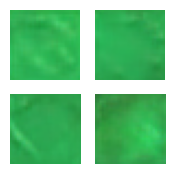

Epoch 176/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 1.7659085988998413, Discriminator Loss: 0.8575168251991272


Epoch 177/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.96step/s]

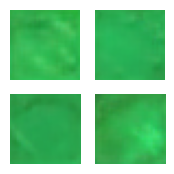

Epoch 177/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 2.3514578342437744, Discriminator Loss: 0.8606905937194824


Epoch 178/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.78step/s]

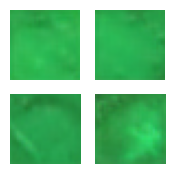

Epoch 178/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 2.6958515644073486, Discriminator Loss: 0.6363255381584167


Epoch 179/1000: 100%|██████████| 87/87 [00:04<00:00, 16.31step/s]

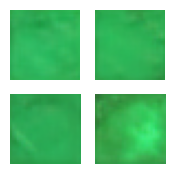

Epoch 179/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]


Generator Loss: 2.238774538040161, Discriminator Loss: 0.6908460259437561


Epoch 180/1000: 100%|██████████| 87/87 [00:05<00:00, 16.97step/s]

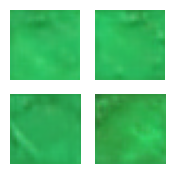

Epoch 180/1000: 100%|██████████| 87/87 [00:05<00:00, 15.58step/s]


Generator Loss: 1.8186553716659546, Discriminator Loss: 0.9414241313934326


Epoch 181/1000: 100%|██████████| 87/87 [00:05<00:00, 15.42step/s]

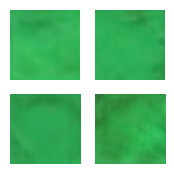

Epoch 181/1000: 100%|██████████| 87/87 [00:05<00:00, 15.26step/s]


Generator Loss: 1.9803577661514282, Discriminator Loss: 0.9095461368560791


Epoch 182/1000: 100%|██████████| 87/87 [00:05<00:00, 15.46step/s]

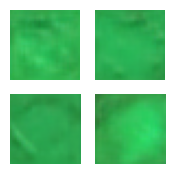

Epoch 182/1000: 100%|██████████| 87/87 [00:05<00:00, 15.50step/s]


Generator Loss: 2.0188817977905273, Discriminator Loss: 0.751944899559021


Epoch 183/1000: 100%|██████████| 87/87 [00:05<00:00, 15.72step/s]

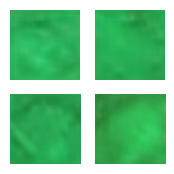

Epoch 183/1000: 100%|██████████| 87/87 [00:05<00:00, 15.47step/s]


Generator Loss: 2.0040619373321533, Discriminator Loss: 0.8305031061172485


Epoch 184/1000: 100%|██████████| 87/87 [00:05<00:00, 16.05step/s]

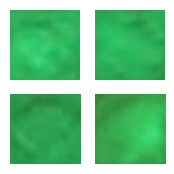

Epoch 184/1000: 100%|██████████| 87/87 [00:05<00:00, 15.74step/s]


Generator Loss: 1.8210102319717407, Discriminator Loss: 0.9075942635536194


Epoch 185/1000: 100%|██████████| 87/87 [00:05<00:00, 15.52step/s]

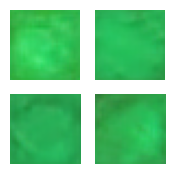

Epoch 185/1000: 100%|██████████| 87/87 [00:05<00:00, 14.82step/s]


Generator Loss: 1.8697234392166138, Discriminator Loss: 0.983066976070404


Epoch 186/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.45step/s]

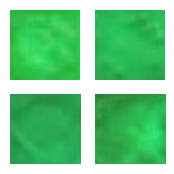

Epoch 186/1000: 100%|██████████| 87/87 [00:05<00:00, 14.71step/s]


Generator Loss: 1.6037890911102295, Discriminator Loss: 1.0567671060562134


Epoch 187/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.61step/s]

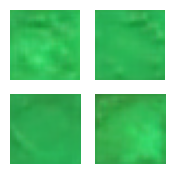

Epoch 187/1000: 100%|██████████| 87/87 [00:06<00:00, 14.40step/s]


Generator Loss: 1.8913350105285645, Discriminator Loss: 0.9370185732841492


Epoch 188/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.23step/s]

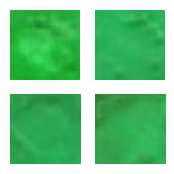

Epoch 188/1000: 100%|██████████| 87/87 [00:05<00:00, 14.52step/s]


Generator Loss: 1.8704577684402466, Discriminator Loss: 0.7835954427719116


Epoch 189/1000: 100%|██████████| 87/87 [00:05<00:00, 15.44step/s]

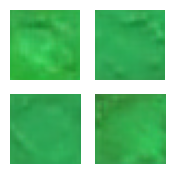

Epoch 189/1000: 100%|██████████| 87/87 [00:05<00:00, 14.62step/s]


Generator Loss: 1.9373750686645508, Discriminator Loss: 0.8717632293701172


Epoch 190/1000: 100%|██████████| 87/87 [00:04<00:00, 19.74step/s]

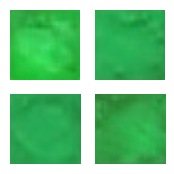

Epoch 190/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 2.1459949016571045, Discriminator Loss: 0.7541754841804504


Epoch 191/1000: 100%|██████████| 87/87 [00:04<00:00, 19.86step/s]

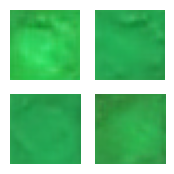

Epoch 191/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]


Generator Loss: 2.1158132553100586, Discriminator Loss: 0.7747886180877686


Epoch 192/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.48step/s]

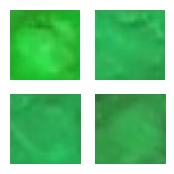

Epoch 192/1000: 100%|██████████| 87/87 [00:04<00:00, 19.29step/s]


Generator Loss: 1.935495138168335, Discriminator Loss: 0.9814792275428772


Epoch 193/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.18step/s]

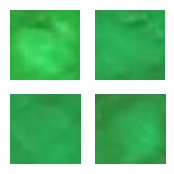

Epoch 193/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 1.7439690828323364, Discriminator Loss: 0.9147545695304871


Epoch 194/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.94step/s]

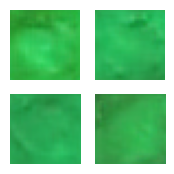

Epoch 194/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 1.8709876537322998, Discriminator Loss: 0.8715184330940247


Epoch 195/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.59step/s]

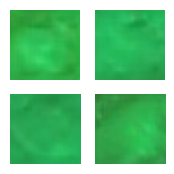

Epoch 195/1000: 100%|██████████| 87/87 [00:04<00:00, 19.16step/s]


Generator Loss: 1.9375413656234741, Discriminator Loss: 0.9071279168128967


Epoch 196/1000: 100%|██████████| 87/87 [00:04<00:00, 19.16step/s]

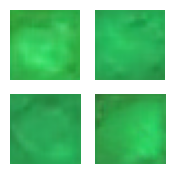

Epoch 196/1000: 100%|██████████| 87/87 [00:04<00:00, 18.39step/s]


Generator Loss: 1.6988890171051025, Discriminator Loss: 0.9435539841651917


Epoch 197/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.88step/s]

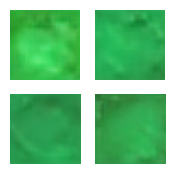

Epoch 197/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]


Generator Loss: 1.9837943315505981, Discriminator Loss: 0.9201108813285828


Epoch 198/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.15step/s]

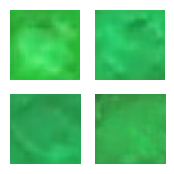

Epoch 198/1000: 100%|██████████| 87/87 [00:04<00:00, 19.29step/s]


Generator Loss: 2.0473482608795166, Discriminator Loss: 0.7943193912506104


Epoch 199/1000: 100%|██████████| 87/87 [00:04<00:00, 17.92step/s]

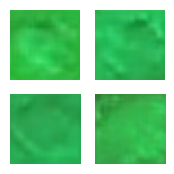

Epoch 199/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 2.320861339569092, Discriminator Loss: 0.7713654637336731


Epoch 200/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.64step/s]

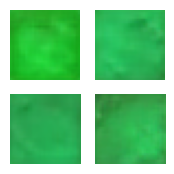

Epoch 200/1000: 100%|██████████| 87/87 [00:04<00:00, 17.78step/s]


Generator Loss: 2.6394009590148926, Discriminator Loss: 0.626081645488739


Epoch 201/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.24step/s]

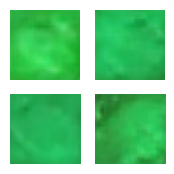

Epoch 201/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 2.2857730388641357, Discriminator Loss: 0.8384373784065247


Epoch 202/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.79step/s]

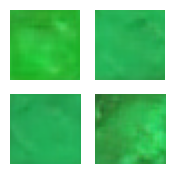

Epoch 202/1000: 100%|██████████| 87/87 [00:04<00:00, 18.79step/s]


Generator Loss: 1.8439569473266602, Discriminator Loss: 0.9234166741371155


Epoch 203/1000: 100%|██████████| 87/87 [00:04<00:00, 19.20step/s]

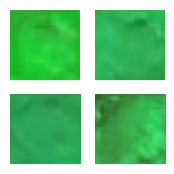

Epoch 203/1000: 100%|██████████| 87/87 [00:04<00:00, 18.00step/s]


Generator Loss: 1.7717400789260864, Discriminator Loss: 0.9513855576515198


Epoch 204/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.45step/s]

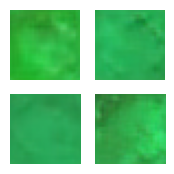

Epoch 204/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]


Generator Loss: 2.1322922706604004, Discriminator Loss: 0.7534294724464417


Epoch 205/1000: 100%|██████████| 87/87 [00:04<00:00, 19.48step/s]

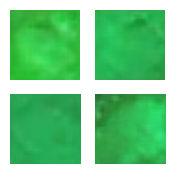

Epoch 205/1000: 100%|██████████| 87/87 [00:04<00:00, 17.59step/s]


Generator Loss: 2.2974894046783447, Discriminator Loss: 0.802623450756073


Epoch 206/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.08step/s]

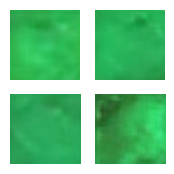

Epoch 206/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.3157131671905518, Discriminator Loss: 0.7181656956672668


Epoch 207/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.14step/s]

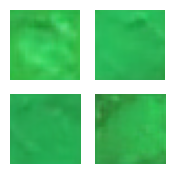

Epoch 207/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]


Generator Loss: 1.8571679592132568, Discriminator Loss: 0.9595651626586914


Epoch 208/1000: 100%|██████████| 87/87 [00:04<00:00, 19.83step/s]

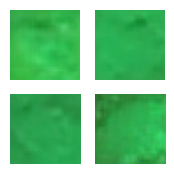

Epoch 208/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]


Generator Loss: 2.1082069873809814, Discriminator Loss: 0.8251428604125977


Epoch 209/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.69step/s]

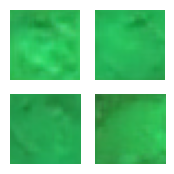

Epoch 209/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 2.0313782691955566, Discriminator Loss: 0.8116981387138367


Epoch 210/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.80step/s]

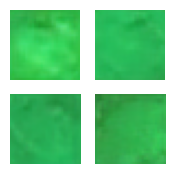

Epoch 210/1000: 100%|██████████| 87/87 [00:04<00:00, 17.99step/s]


Generator Loss: 2.095031976699829, Discriminator Loss: 0.8277801871299744


Epoch 211/1000: 100%|██████████| 87/87 [00:04<00:00, 19.65step/s]

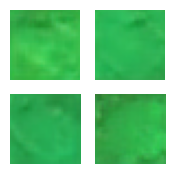

Epoch 211/1000: 100%|██████████| 87/87 [00:04<00:00, 18.78step/s]


Generator Loss: 2.287064552307129, Discriminator Loss: 0.750377357006073


Epoch 212/1000: 100%|██████████| 87/87 [00:04<00:00, 19.31step/s]

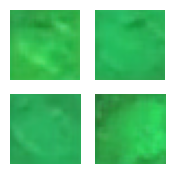

Epoch 212/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 2.0672926902770996, Discriminator Loss: 0.7399282455444336


Epoch 213/1000: 100%|██████████| 87/87 [00:04<00:00, 20.20step/s]

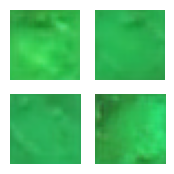

Epoch 213/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 2.5751523971557617, Discriminator Loss: 0.5216440558433533


Epoch 214/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.32step/s]

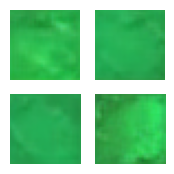

Epoch 214/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 2.5231688022613525, Discriminator Loss: 0.6312375664710999


Epoch 215/1000: 100%|██████████| 87/87 [00:04<00:00, 17.64step/s]

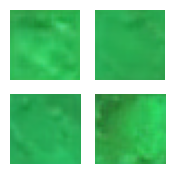

Epoch 215/1000: 100%|██████████| 87/87 [00:04<00:00, 17.70step/s]


Generator Loss: 2.415271520614624, Discriminator Loss: 0.8124037384986877


Epoch 216/1000: 100%|██████████| 87/87 [00:04<00:00, 16.69step/s]

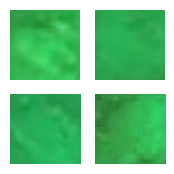

Epoch 216/1000: 100%|██████████| 87/87 [00:05<00:00, 16.85step/s]


Generator Loss: 2.312269926071167, Discriminator Loss: 0.7731484770774841


Epoch 217/1000: 100%|██████████| 87/87 [00:04<00:00, 17.20step/s]

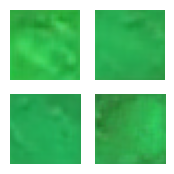

Epoch 217/1000: 100%|██████████| 87/87 [00:04<00:00, 17.96step/s]


Generator Loss: 2.335644245147705, Discriminator Loss: 0.830000102519989


Epoch 218/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.75step/s]

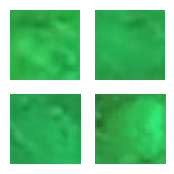

Epoch 218/1000: 100%|██████████| 87/87 [00:05<00:00, 17.23step/s]


Generator Loss: 1.7877507209777832, Discriminator Loss: 0.9333292841911316


Epoch 219/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.16step/s]

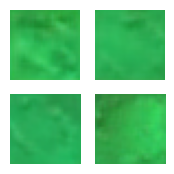

Epoch 219/1000: 100%|██████████| 87/87 [00:04<00:00, 17.57step/s]


Generator Loss: 2.0493743419647217, Discriminator Loss: 0.8307389616966248


Epoch 220/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.39step/s]

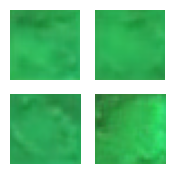

Epoch 220/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.324117422103882, Discriminator Loss: 0.7838173508644104


Epoch 221/1000: 100%|██████████| 87/87 [00:04<00:00, 19.54step/s]

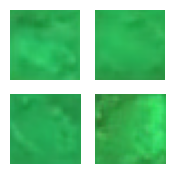

Epoch 221/1000: 100%|██████████| 87/87 [00:04<00:00, 18.27step/s]


Generator Loss: 1.7040722370147705, Discriminator Loss: 1.1174492835998535


Epoch 222/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]

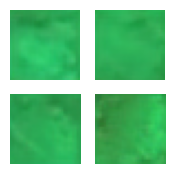

Epoch 222/1000: 100%|██████████| 87/87 [00:04<00:00, 19.02step/s]


Generator Loss: 2.004625082015991, Discriminator Loss: 0.7880203127861023


Epoch 223/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.66step/s]

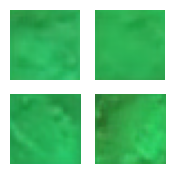

Epoch 223/1000: 100%|██████████| 87/87 [00:04<00:00, 18.23step/s]


Generator Loss: 1.9414297342300415, Discriminator Loss: 0.7658071517944336


Epoch 224/1000: 100%|██████████| 87/87 [00:04<00:00, 18.34step/s]

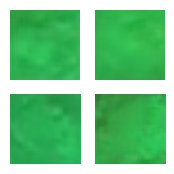

Epoch 224/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 2.0442328453063965, Discriminator Loss: 0.7803164124488831


Epoch 225/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.20step/s]

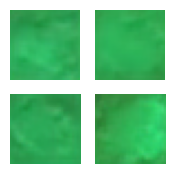

Epoch 225/1000: 100%|██████████| 87/87 [00:04<00:00, 18.78step/s]


Generator Loss: 2.2383921146392822, Discriminator Loss: 0.7079731822013855


Epoch 226/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.66step/s]

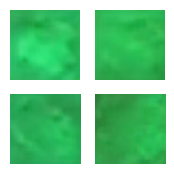

Epoch 226/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 2.21425199508667, Discriminator Loss: 0.7112470269203186


Epoch 227/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.81step/s]

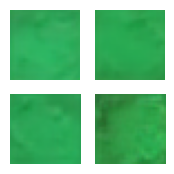

Epoch 227/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 2.8442487716674805, Discriminator Loss: 0.5273960828781128


Epoch 228/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.81step/s]

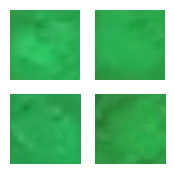

Epoch 228/1000: 100%|██████████| 87/87 [00:05<00:00, 15.86step/s]


Generator Loss: 2.5102901458740234, Discriminator Loss: 0.8024793863296509


Epoch 229/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.10step/s]

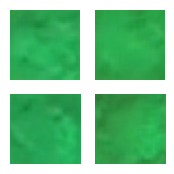

Epoch 229/1000: 100%|██████████| 87/87 [00:05<00:00, 15.48step/s]


Generator Loss: 2.238098621368408, Discriminator Loss: 0.7526136636734009


Epoch 230/1000: 100%|██████████| 87/87 [00:05<00:00, 16.74step/s]

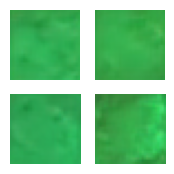

Epoch 230/1000: 100%|██████████| 87/87 [00:05<00:00, 15.55step/s]


Generator Loss: 2.1384048461914062, Discriminator Loss: 0.8042579889297485


Epoch 231/1000: 100%|██████████| 87/87 [00:05<00:00, 17.11step/s]

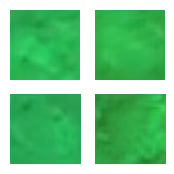

Epoch 231/1000: 100%|██████████| 87/87 [00:05<00:00, 15.84step/s]


Generator Loss: 2.2555103302001953, Discriminator Loss: 0.795308530330658


Epoch 232/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.42step/s]

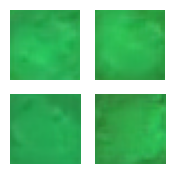

Epoch 232/1000: 100%|██████████| 87/87 [00:05<00:00, 15.61step/s]


Generator Loss: 2.8311996459960938, Discriminator Loss: 0.6200064420700073


Epoch 233/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.18step/s]

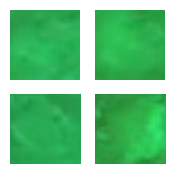

Epoch 233/1000: 100%|██████████| 87/87 [00:05<00:00, 15.44step/s]


Generator Loss: 1.9305047988891602, Discriminator Loss: 0.958716630935669


Epoch 234/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.03step/s]

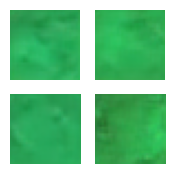

Epoch 234/1000: 100%|██████████| 87/87 [00:05<00:00, 15.53step/s]


Generator Loss: 2.2936291694641113, Discriminator Loss: 0.7865962982177734


Epoch 235/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.48step/s]

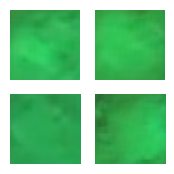

Epoch 235/1000: 100%|██████████| 87/87 [00:05<00:00, 14.89step/s]


Generator Loss: 2.6434741020202637, Discriminator Loss: 0.6915825009346008


Epoch 236/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.15step/s]

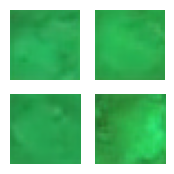

Epoch 236/1000: 100%|██████████| 87/87 [00:06<00:00, 14.48step/s]


Generator Loss: 2.066307783126831, Discriminator Loss: 0.8825201392173767


Epoch 237/1000: 100%|██████████| 87/87 [00:05<00:00, 15.47step/s]

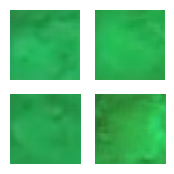

Epoch 237/1000: 100%|██████████| 87/87 [00:05<00:00, 14.84step/s]


Generator Loss: 2.485853910446167, Discriminator Loss: 0.8194445967674255


Epoch 238/1000: 100%|██████████| 87/87 [00:05<00:00, 21.38step/s]

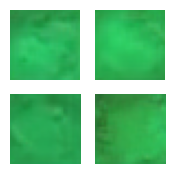

Epoch 238/1000: 100%|██████████| 87/87 [00:05<00:00, 16.34step/s]


Generator Loss: 2.9255030155181885, Discriminator Loss: 0.5453241467475891


Epoch 239/1000: 100%|██████████| 87/87 [00:04<00:00, 20.85step/s]

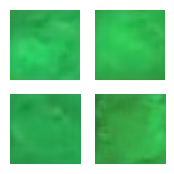

Epoch 239/1000: 100%|██████████| 87/87 [00:04<00:00, 19.85step/s]


Generator Loss: 1.9185501337051392, Discriminator Loss: 0.8397773504257202


Epoch 240/1000: 100%|██████████| 87/87 [00:04<00:00, 18.86step/s]

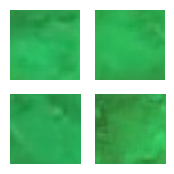

Epoch 240/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 2.005384683609009, Discriminator Loss: 0.9417449831962585


Epoch 241/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.38step/s]

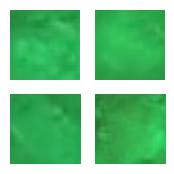

Epoch 241/1000: 100%|██████████| 87/87 [00:04<00:00, 17.83step/s]


Generator Loss: 1.9209855794906616, Discriminator Loss: 0.8438413143157959


Epoch 242/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.10step/s]

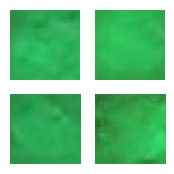

Epoch 242/1000: 100%|██████████| 87/87 [00:04<00:00, 17.93step/s]


Generator Loss: 2.0889155864715576, Discriminator Loss: 0.9129660725593567


Epoch 243/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.21step/s]

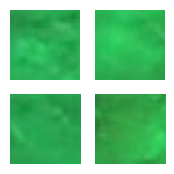

Epoch 243/1000: 100%|██████████| 87/87 [00:04<00:00, 18.99step/s]


Generator Loss: 2.485238552093506, Discriminator Loss: 0.6945909261703491


Epoch 244/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]

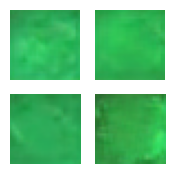

Epoch 244/1000: 100%|██████████| 87/87 [00:04<00:00, 19.07step/s]


Generator Loss: 2.463634729385376, Discriminator Loss: 0.6338632106781006


Epoch 245/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.10step/s]

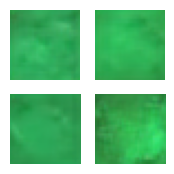

Epoch 245/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]


Generator Loss: 2.7781455516815186, Discriminator Loss: 0.624554455280304


Epoch 246/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.11step/s]

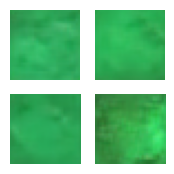

Epoch 246/1000: 100%|██████████| 87/87 [00:04<00:00, 19.07step/s]


Generator Loss: 2.2810134887695312, Discriminator Loss: 0.7117055058479309


Epoch 247/1000: 100%|██████████| 87/87 [00:04<00:00, 20.17step/s]

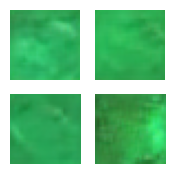

Epoch 247/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]


Generator Loss: 2.688269853591919, Discriminator Loss: 0.6059032082557678


Epoch 248/1000: 100%|██████████| 87/87 [00:04<00:00, 21.50step/s]

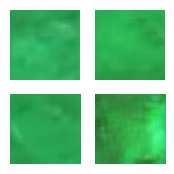

Epoch 248/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 2.347275733947754, Discriminator Loss: 0.7512974143028259


Epoch 249/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.30step/s]

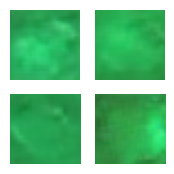

Epoch 249/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 2.3643245697021484, Discriminator Loss: 0.7792628407478333


Epoch 250/1000: 100%|██████████| 87/87 [00:04<00:00, 20.47step/s]

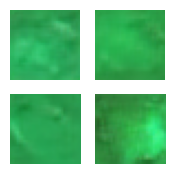

Epoch 250/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 2.148287534713745, Discriminator Loss: 0.8242053389549255


Epoch 251/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.99step/s]

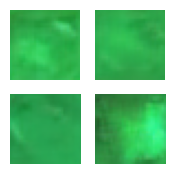

Epoch 251/1000: 100%|██████████| 87/87 [00:04<00:00, 19.08step/s]


Generator Loss: 2.4760916233062744, Discriminator Loss: 0.6630538105964661


Epoch 252/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]

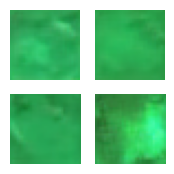

Epoch 252/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 2.3334641456604004, Discriminator Loss: 0.6864749193191528


Epoch 253/1000: 100%|██████████| 87/87 [00:04<00:00, 18.48step/s]

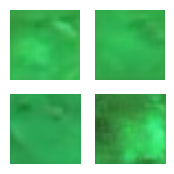

Epoch 253/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 2.3486461639404297, Discriminator Loss: 0.7823972105979919


Epoch 254/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.40step/s]

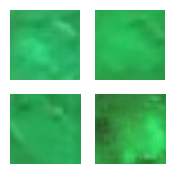

Epoch 254/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 2.59175705909729, Discriminator Loss: 0.7571390271186829


Epoch 255/1000: 100%|██████████| 87/87 [00:04<00:00, 19.00step/s]

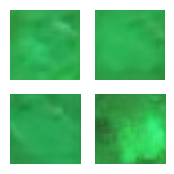

Epoch 255/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 2.228048801422119, Discriminator Loss: 0.8297973275184631


Epoch 256/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.18step/s]

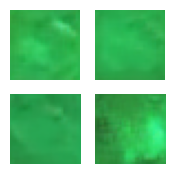

Epoch 256/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 1.8677940368652344, Discriminator Loss: 0.9672554135322571


Epoch 257/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.77step/s]

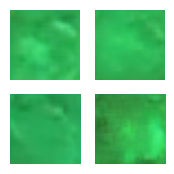

Epoch 257/1000: 100%|██████████| 87/87 [00:04<00:00, 19.12step/s]


Generator Loss: 2.326803207397461, Discriminator Loss: 0.9296838045120239


Epoch 258/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.00step/s]

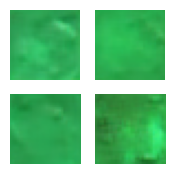

Epoch 258/1000: 100%|██████████| 87/87 [00:04<00:00, 19.43step/s]


Generator Loss: 2.256007671356201, Discriminator Loss: 0.8193632960319519


Epoch 259/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.12step/s]

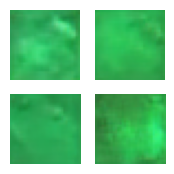

Epoch 259/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 2.6613423824310303, Discriminator Loss: 0.6783808469772339


Epoch 260/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]

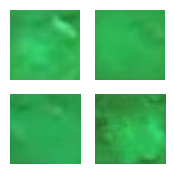

Epoch 260/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 2.2303013801574707, Discriminator Loss: 0.7778574824333191


Epoch 261/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.50step/s]

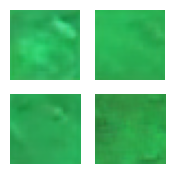

Epoch 261/1000: 100%|██████████| 87/87 [00:05<00:00, 16.78step/s]


Generator Loss: 1.948574185371399, Discriminator Loss: 0.8067232370376587


Epoch 262/1000:  98%|█████████▊| 85/87 [00:05<00:00, 16.64step/s]

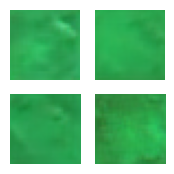

Epoch 262/1000: 100%|██████████| 87/87 [00:05<00:00, 16.46step/s]


Generator Loss: 2.2279927730560303, Discriminator Loss: 0.7907763719558716


Epoch 263/1000: 100%|██████████| 87/87 [00:04<00:00, 18.89step/s]

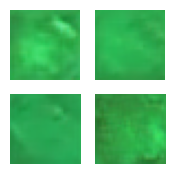

Epoch 263/1000: 100%|██████████| 87/87 [00:05<00:00, 17.21step/s]


Generator Loss: 2.1579740047454834, Discriminator Loss: 0.7889037728309631


Epoch 264/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.67step/s]

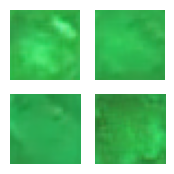

Epoch 264/1000: 100%|██████████| 87/87 [00:05<00:00, 16.54step/s]


Generator Loss: 2.130216360092163, Discriminator Loss: 0.8792605996131897


Epoch 265/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.57step/s]

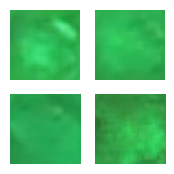

Epoch 265/1000: 100%|██████████| 87/87 [00:05<00:00, 17.35step/s]


Generator Loss: 2.4655120372772217, Discriminator Loss: 0.7345631122589111


Epoch 266/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.71step/s]

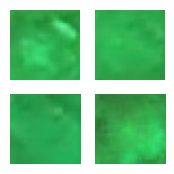

Epoch 266/1000: 100%|██████████| 87/87 [00:05<00:00, 17.34step/s]


Generator Loss: 2.119938611984253, Discriminator Loss: 0.7420101761817932


Epoch 267/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.13step/s]

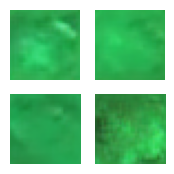

Epoch 267/1000: 100%|██████████| 87/87 [00:04<00:00, 17.79step/s]


Generator Loss: 2.7067553997039795, Discriminator Loss: 0.6672694683074951


Epoch 268/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.94step/s]

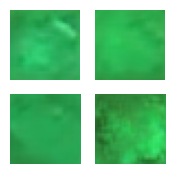

Epoch 268/1000: 100%|██████████| 87/87 [00:04<00:00, 17.84step/s]


Generator Loss: 2.228404998779297, Discriminator Loss: 0.7438520193099976


Epoch 269/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.99step/s]

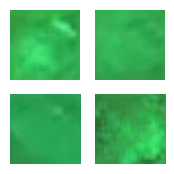

Epoch 269/1000: 100%|██████████| 87/87 [00:04<00:00, 18.22step/s]


Generator Loss: 2.1771655082702637, Discriminator Loss: 0.8848755955696106


Epoch 270/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.07step/s]

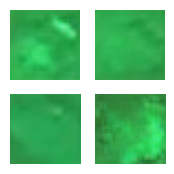

Epoch 270/1000: 100%|██████████| 87/87 [00:04<00:00, 19.33step/s]


Generator Loss: 2.203064441680908, Discriminator Loss: 0.7401520013809204


Epoch 271/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.27step/s]

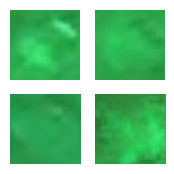

Epoch 271/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 2.444162368774414, Discriminator Loss: 0.807945191860199


Epoch 272/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.65step/s]

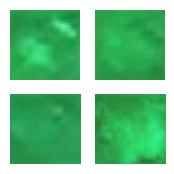

Epoch 272/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 1.9440165758132935, Discriminator Loss: 0.9663499593734741


Epoch 273/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.96step/s]

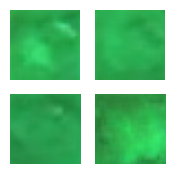

Epoch 273/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 2.762549638748169, Discriminator Loss: 0.5976123213768005


Epoch 274/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.77step/s]

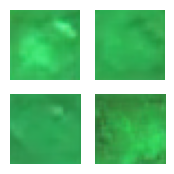

Epoch 274/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]


Generator Loss: 2.348811626434326, Discriminator Loss: 0.7063384652137756


Epoch 275/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.07step/s]

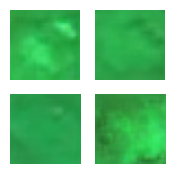

Epoch 275/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 2.1307222843170166, Discriminator Loss: 0.865436315536499


Epoch 276/1000: 100%|██████████| 87/87 [00:05<00:00, 15.52step/s]

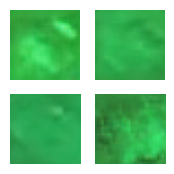

Epoch 276/1000: 100%|██████████| 87/87 [00:05<00:00, 16.30step/s]


Generator Loss: 1.9527512788772583, Discriminator Loss: 1.0235453844070435


Epoch 277/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.24step/s]

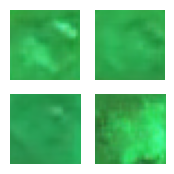

Epoch 277/1000: 100%|██████████| 87/87 [00:05<00:00, 15.43step/s]


Generator Loss: 2.53080153465271, Discriminator Loss: 0.6363310217857361


Epoch 278/1000: 100%|██████████| 87/87 [00:05<00:00, 16.26step/s]

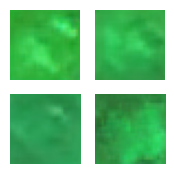

Epoch 278/1000: 100%|██████████| 87/87 [00:05<00:00, 14.98step/s]


Generator Loss: 2.739938974380493, Discriminator Loss: 0.6284688711166382


Epoch 279/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.09step/s]

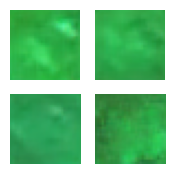

Epoch 279/1000: 100%|██████████| 87/87 [00:05<00:00, 15.90step/s]


Generator Loss: 2.5445995330810547, Discriminator Loss: 0.6693959832191467


Epoch 280/1000: 100%|██████████| 87/87 [00:05<00:00, 17.04step/s]

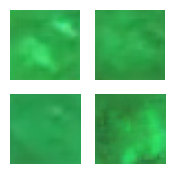

Epoch 280/1000: 100%|██████████| 87/87 [00:05<00:00, 15.71step/s]


Generator Loss: 2.583341598510742, Discriminator Loss: 0.6104520559310913


Epoch 281/1000: 100%|██████████| 87/87 [00:05<00:00, 14.79step/s]

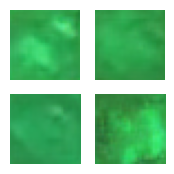

Epoch 281/1000: 100%|██████████| 87/87 [00:05<00:00, 15.52step/s]


Generator Loss: 2.56923770904541, Discriminator Loss: 0.6178004145622253


Epoch 282/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.76step/s]

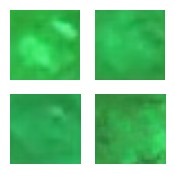

Epoch 282/1000: 100%|██████████| 87/87 [00:05<00:00, 14.96step/s]


Generator Loss: 2.440378189086914, Discriminator Loss: 0.8380665183067322


Epoch 283/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.63step/s]

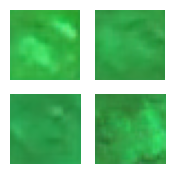

Epoch 283/1000: 100%|██████████| 87/87 [00:05<00:00, 15.20step/s]


Generator Loss: 2.9456353187561035, Discriminator Loss: 0.5574934482574463


Epoch 284/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.10step/s]

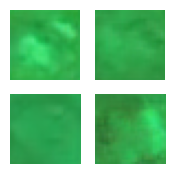

Epoch 284/1000: 100%|██████████| 87/87 [00:05<00:00, 14.77step/s]


Generator Loss: 2.1774256229400635, Discriminator Loss: 0.858027994632721


Epoch 285/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.97step/s]

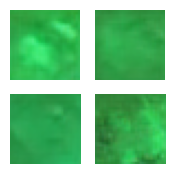

Epoch 285/1000: 100%|██████████| 87/87 [00:05<00:00, 15.10step/s]


Generator Loss: 2.087886333465576, Discriminator Loss: 1.0297372341156006


Epoch 286/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.97step/s]

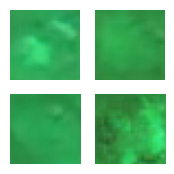

Epoch 286/1000: 100%|██████████| 87/87 [00:05<00:00, 15.31step/s]


Generator Loss: 2.100459098815918, Discriminator Loss: 0.8254321813583374


Epoch 287/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.20step/s]

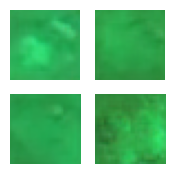

Epoch 287/1000: 100%|██████████| 87/87 [00:04<00:00, 19.12step/s]


Generator Loss: 2.34669828414917, Discriminator Loss: 0.7700725793838501


Epoch 288/1000: 100%|██████████| 87/87 [00:04<00:00, 19.19step/s]

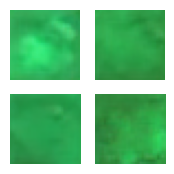

Epoch 288/1000: 100%|██████████| 87/87 [00:04<00:00, 18.99step/s]


Generator Loss: 2.314833879470825, Discriminator Loss: 0.6495949625968933


Epoch 289/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]

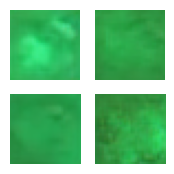

Epoch 289/1000: 100%|██████████| 87/87 [00:04<00:00, 18.67step/s]


Generator Loss: 1.8923894166946411, Discriminator Loss: 1.0071487426757812


Epoch 290/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]

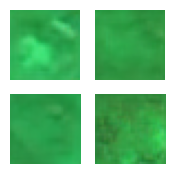

Epoch 290/1000: 100%|██████████| 87/87 [00:04<00:00, 18.23step/s]


Generator Loss: 2.5845413208007812, Discriminator Loss: 0.5783753991127014


Epoch 291/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]

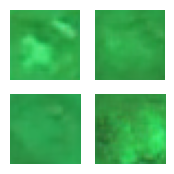

Epoch 291/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 2.4338443279266357, Discriminator Loss: 0.6840204000473022


Epoch 292/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.60step/s]

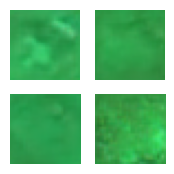

Epoch 292/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 2.138004779815674, Discriminator Loss: 0.8433201313018799


Epoch 293/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.04step/s]

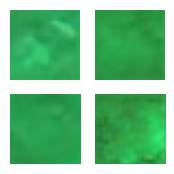

Epoch 293/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]


Generator Loss: 2.4820640087127686, Discriminator Loss: 0.6348209977149963


Epoch 294/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.50step/s]

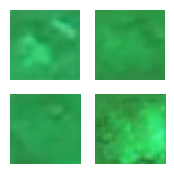

Epoch 294/1000: 100%|██████████| 87/87 [00:04<00:00, 19.53step/s]


Generator Loss: 2.194598913192749, Discriminator Loss: 0.8924621343612671


Epoch 295/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.84step/s]

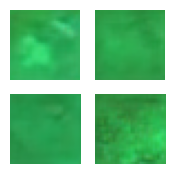

Epoch 295/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 2.1059396266937256, Discriminator Loss: 0.9226309061050415


Epoch 296/1000: 100%|██████████| 87/87 [00:04<00:00, 17.72step/s]

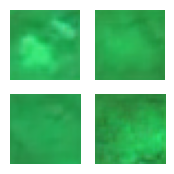

Epoch 296/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 2.641404151916504, Discriminator Loss: 0.5769925713539124


Epoch 297/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.51step/s]

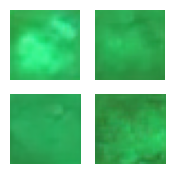

Epoch 297/1000: 100%|██████████| 87/87 [00:04<00:00, 19.34step/s]


Generator Loss: 2.486715078353882, Discriminator Loss: 0.6776002645492554


Epoch 298/1000: 100%|██████████| 87/87 [00:04<00:00, 20.23step/s]

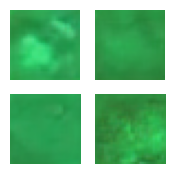

Epoch 298/1000: 100%|██████████| 87/87 [00:04<00:00, 19.35step/s]


Generator Loss: 2.0782766342163086, Discriminator Loss: 0.9072025418281555


Epoch 299/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]

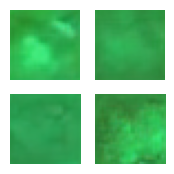

Epoch 299/1000: 100%|██████████| 87/87 [00:04<00:00, 18.33step/s]


Generator Loss: 2.0888609886169434, Discriminator Loss: 0.822367250919342


Epoch 300/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.66step/s]

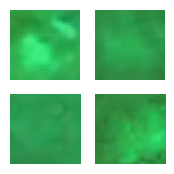

Epoch 300/1000: 100%|██████████| 87/87 [00:04<00:00, 17.49step/s]


Generator Loss: 2.565220355987549, Discriminator Loss: 0.7349721789360046


Epoch 301/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]

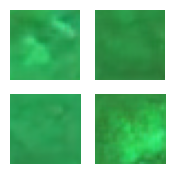

Epoch 301/1000: 100%|██████████| 87/87 [00:04<00:00, 19.51step/s]


Generator Loss: 2.287795066833496, Discriminator Loss: 0.734092116355896


Epoch 302/1000: 100%|██████████| 87/87 [00:04<00:00, 19.33step/s]

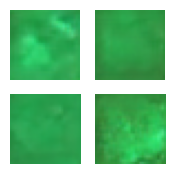

Epoch 302/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 2.5463664531707764, Discriminator Loss: 0.7255297899246216


Epoch 303/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.51step/s]

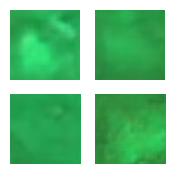

Epoch 303/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 2.284899950027466, Discriminator Loss: 0.8952862024307251


Epoch 304/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.81step/s]

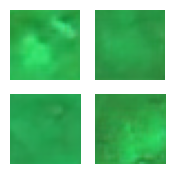

Epoch 304/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]


Generator Loss: 2.6812565326690674, Discriminator Loss: 0.6427111029624939


Epoch 305/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.12step/s]

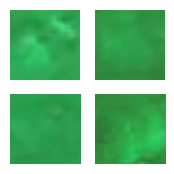

Epoch 305/1000: 100%|██████████| 87/87 [00:04<00:00, 18.48step/s]


Generator Loss: 2.7393548488616943, Discriminator Loss: 0.638078510761261


Epoch 306/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.94step/s]

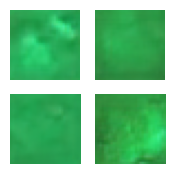

Epoch 306/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 2.516287088394165, Discriminator Loss: 0.7006601095199585


Epoch 307/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.12step/s]

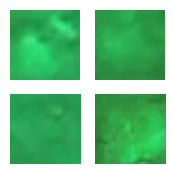

Epoch 307/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 2.3493471145629883, Discriminator Loss: 0.9368606209754944


Epoch 308/1000: 100%|██████████| 87/87 [00:04<00:00, 17.48step/s]

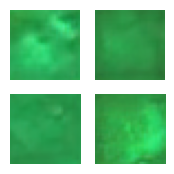

Epoch 308/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 2.0664734840393066, Discriminator Loss: 0.8410718441009521


Epoch 309/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.29step/s]

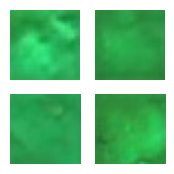

Epoch 309/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 2.101510763168335, Discriminator Loss: 0.9172827005386353


Epoch 310/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.48step/s]

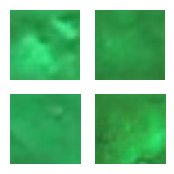

Epoch 310/1000: 100%|██████████| 87/87 [00:04<00:00, 18.31step/s]


Generator Loss: 2.009509801864624, Discriminator Loss: 0.7851259112358093


Epoch 311/1000: 100%|██████████| 87/87 [00:04<00:00, 16.80step/s]

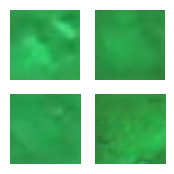

Epoch 311/1000: 100%|██████████| 87/87 [00:04<00:00, 17.57step/s]


Generator Loss: 2.3913989067077637, Discriminator Loss: 0.6053134799003601


Epoch 312/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.50step/s]

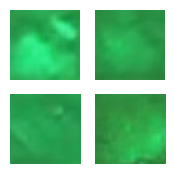

Epoch 312/1000: 100%|██████████| 87/87 [00:05<00:00, 17.36step/s]


Generator Loss: 2.132638692855835, Discriminator Loss: 0.769081711769104


Epoch 313/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.72step/s]

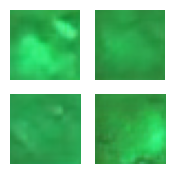

Epoch 313/1000: 100%|██████████| 87/87 [00:05<00:00, 17.22step/s]


Generator Loss: 2.1539268493652344, Discriminator Loss: 0.8513868451118469


Epoch 314/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]

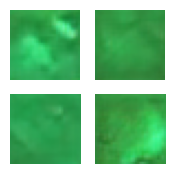

Epoch 314/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]


Generator Loss: 2.0818772315979004, Discriminator Loss: 0.8095763921737671


Epoch 315/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.71step/s]

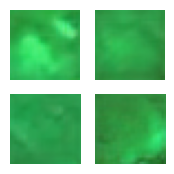

Epoch 315/1000: 100%|██████████| 87/87 [00:04<00:00, 17.79step/s]


Generator Loss: 3.248636245727539, Discriminator Loss: 0.4510684013366699


Epoch 316/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]

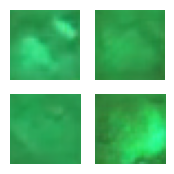

Epoch 316/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.767557144165039, Discriminator Loss: 0.4870131015777588


Epoch 317/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.89step/s]

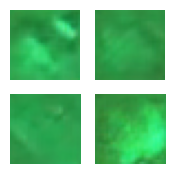

Epoch 317/1000: 100%|██████████| 87/87 [00:05<00:00, 16.72step/s]


Generator Loss: 2.4888181686401367, Discriminator Loss: 0.7220796346664429


Epoch 318/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.14step/s]

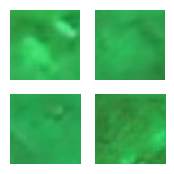

Epoch 318/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.3423876762390137, Discriminator Loss: 0.8249214291572571


Epoch 319/1000: 100%|██████████| 87/87 [00:04<00:00, 19.69step/s]

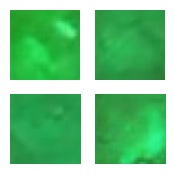

Epoch 319/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 2.0656888484954834, Discriminator Loss: 0.8346637487411499


Epoch 320/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.56step/s]

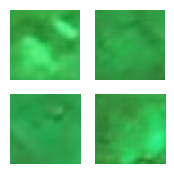

Epoch 320/1000: 100%|██████████| 87/87 [00:04<00:00, 18.74step/s]


Generator Loss: 2.3740251064300537, Discriminator Loss: 0.6947335600852966


Epoch 321/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.18step/s]

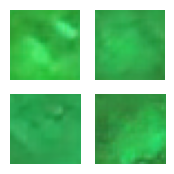

Epoch 321/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.2597460746765137, Discriminator Loss: 0.8024362921714783


Epoch 322/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.33step/s]

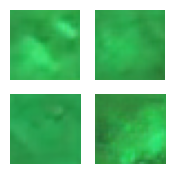

Epoch 322/1000: 100%|██████████| 87/87 [00:04<00:00, 17.98step/s]


Generator Loss: 2.0933027267456055, Discriminator Loss: 0.7689949870109558


Epoch 323/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.18step/s]

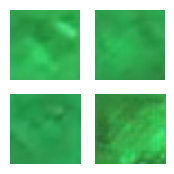

Epoch 323/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]


Generator Loss: 2.3864128589630127, Discriminator Loss: 0.7136914730072021


Epoch 324/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.70step/s]

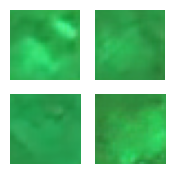

Epoch 324/1000: 100%|██████████| 87/87 [00:05<00:00, 17.13step/s]


Generator Loss: 2.306688070297241, Discriminator Loss: 0.8236621618270874


Epoch 325/1000: 100%|██████████| 87/87 [00:05<00:00, 15.86step/s]

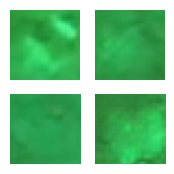

Epoch 325/1000: 100%|██████████| 87/87 [00:05<00:00, 15.23step/s]


Generator Loss: 2.2695541381835938, Discriminator Loss: 0.7946736812591553


Epoch 326/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.17step/s]

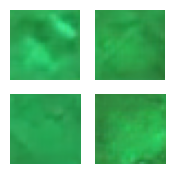

Epoch 326/1000: 100%|██████████| 87/87 [00:05<00:00, 14.92step/s]


Generator Loss: 2.6866555213928223, Discriminator Loss: 0.5798888802528381


Epoch 327/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.77step/s]

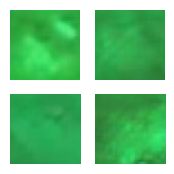

Epoch 327/1000: 100%|██████████| 87/87 [00:05<00:00, 15.28step/s]


Generator Loss: 2.471315622329712, Discriminator Loss: 0.5837171077728271


Epoch 328/1000: 100%|██████████| 87/87 [00:05<00:00, 16.28step/s]

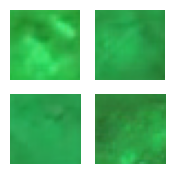

Epoch 328/1000: 100%|██████████| 87/87 [00:05<00:00, 15.84step/s]


Generator Loss: 2.6130309104919434, Discriminator Loss: 0.6484541296958923


Epoch 329/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.41step/s]

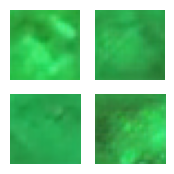

Epoch 329/1000: 100%|██████████| 87/87 [00:05<00:00, 15.59step/s]


Generator Loss: 2.8997766971588135, Discriminator Loss: 0.47758445143699646


Epoch 330/1000: 100%|██████████| 87/87 [00:05<00:00, 15.33step/s]

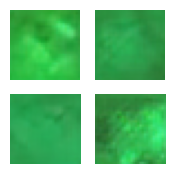

Epoch 330/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 2.7859950065612793, Discriminator Loss: 0.5130727887153625


Epoch 331/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.64step/s]

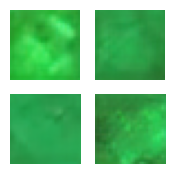

Epoch 331/1000: 100%|██████████| 87/87 [00:05<00:00, 14.69step/s]


Generator Loss: 2.4061028957366943, Discriminator Loss: 0.6391270756721497


Epoch 332/1000: 100%|██████████| 87/87 [00:05<00:00, 15.82step/s]

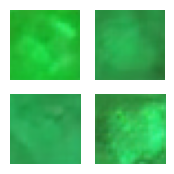

Epoch 332/1000: 100%|██████████| 87/87 [00:05<00:00, 14.94step/s]


Generator Loss: 2.5678091049194336, Discriminator Loss: 0.6782008409500122


Epoch 333/1000: 100%|██████████| 87/87 [00:05<00:00, 14.51step/s]

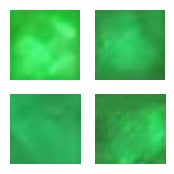

Epoch 333/1000: 100%|██████████| 87/87 [00:05<00:00, 14.69step/s]


Generator Loss: 2.302008867263794, Discriminator Loss: 0.795539140701294


Epoch 334/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.44step/s]

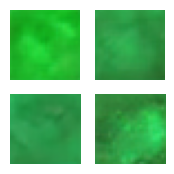

Epoch 334/1000: 100%|██████████| 87/87 [00:05<00:00, 14.78step/s]


Generator Loss: 2.8142189979553223, Discriminator Loss: 0.6022960543632507


Epoch 335/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.82step/s]

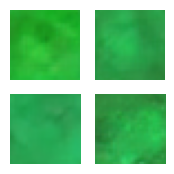

Epoch 335/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 2.531176805496216, Discriminator Loss: 0.7526816129684448


Epoch 336/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]

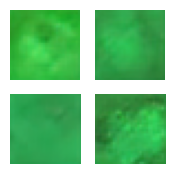

Epoch 336/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 2.9406352043151855, Discriminator Loss: 0.5544845461845398


Epoch 337/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]

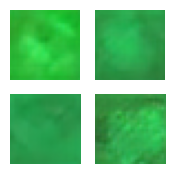

Epoch 337/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 2.8329226970672607, Discriminator Loss: 0.8123111128807068


Epoch 338/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.76step/s]

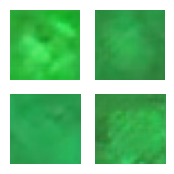

Epoch 338/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]


Generator Loss: 2.5195844173431396, Discriminator Loss: 0.6680744886398315


Epoch 339/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.25step/s]

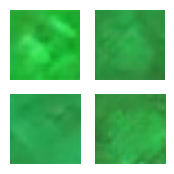

Epoch 339/1000: 100%|██████████| 87/87 [00:04<00:00, 18.77step/s]


Generator Loss: 2.354818344116211, Discriminator Loss: 0.775098443031311


Epoch 340/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.24step/s]

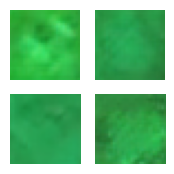

Epoch 340/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]


Generator Loss: 2.3290257453918457, Discriminator Loss: 0.7597658038139343


Epoch 341/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.56step/s]

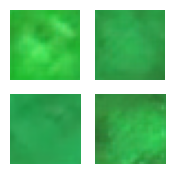

Epoch 341/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.3421437740325928, Discriminator Loss: 0.8083397150039673


Epoch 342/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]

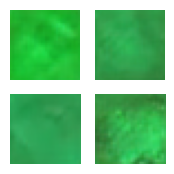

Epoch 342/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]


Generator Loss: 2.1699588298797607, Discriminator Loss: 0.8713961243629456


Epoch 343/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.25step/s]

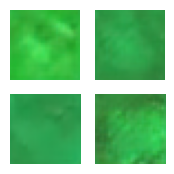

Epoch 343/1000: 100%|██████████| 87/87 [00:04<00:00, 18.66step/s]


Generator Loss: 2.2297770977020264, Discriminator Loss: 0.9367489814758301


Epoch 344/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.15step/s]

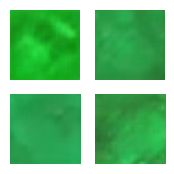

Epoch 344/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 2.0232720375061035, Discriminator Loss: 0.9058789610862732


Epoch 345/1000: 100%|██████████| 87/87 [00:04<00:00, 19.55step/s]

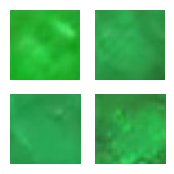

Epoch 345/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 2.3775970935821533, Discriminator Loss: 0.7519178986549377


Epoch 346/1000: 100%|██████████| 87/87 [00:04<00:00, 19.82step/s]

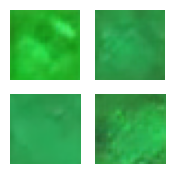

Epoch 346/1000: 100%|██████████| 87/87 [00:04<00:00, 18.02step/s]


Generator Loss: 2.467658519744873, Discriminator Loss: 0.7099577784538269


Epoch 347/1000: 100%|██████████| 87/87 [00:04<00:00, 20.49step/s]

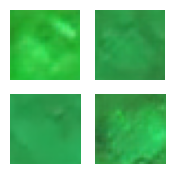

Epoch 347/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 2.2962920665740967, Discriminator Loss: 0.7020965814590454


Epoch 348/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.87step/s]

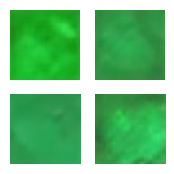

Epoch 348/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 2.4544708728790283, Discriminator Loss: 0.6919763684272766


Epoch 349/1000: 100%|██████████| 87/87 [00:04<00:00, 20.43step/s]

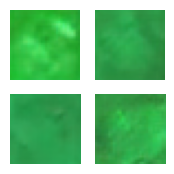

Epoch 349/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]


Generator Loss: 2.1945533752441406, Discriminator Loss: 0.734209418296814


Epoch 350/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.13step/s]

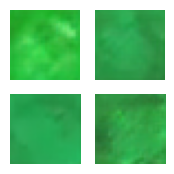

Epoch 350/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 2.2921690940856934, Discriminator Loss: 0.7241401672363281


Epoch 351/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.08step/s]

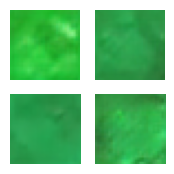

Epoch 351/1000: 100%|██████████| 87/87 [00:04<00:00, 18.02step/s]


Generator Loss: 2.3619704246520996, Discriminator Loss: 0.6221991181373596


Epoch 352/1000: 100%|██████████| 87/87 [00:04<00:00, 20.34step/s]

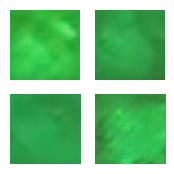

Epoch 352/1000: 100%|██████████| 87/87 [00:04<00:00, 19.04step/s]


Generator Loss: 2.3471808433532715, Discriminator Loss: 0.7730792760848999


Epoch 353/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.91step/s]

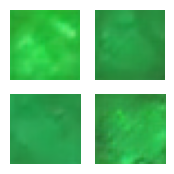

Epoch 353/1000: 100%|██████████| 87/87 [00:04<00:00, 18.23step/s]


Generator Loss: 2.201946496963501, Discriminator Loss: 0.9188061356544495


Epoch 354/1000: 100%|██████████| 87/87 [00:04<00:00, 19.40step/s]

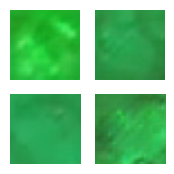

Epoch 354/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 2.1448872089385986, Discriminator Loss: 0.8552581071853638


Epoch 355/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.88step/s]

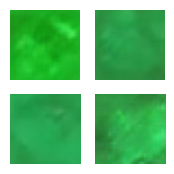

Epoch 355/1000: 100%|██████████| 87/87 [00:04<00:00, 20.34step/s]


Generator Loss: 3.1445133686065674, Discriminator Loss: 0.4489070475101471


Epoch 356/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.40step/s]

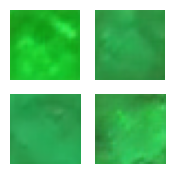

Epoch 356/1000: 100%|██████████| 87/87 [00:04<00:00, 19.83step/s]


Generator Loss: 2.332595109939575, Discriminator Loss: 0.809797465801239


Epoch 357/1000: 100%|██████████| 87/87 [00:04<00:00, 20.63step/s]

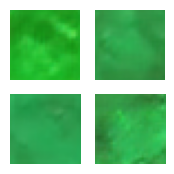

Epoch 357/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 2.391857862472534, Discriminator Loss: 0.7322173714637756


Epoch 358/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.10step/s]

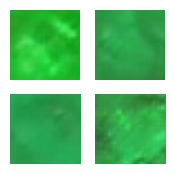

Epoch 358/1000: 100%|██████████| 87/87 [00:04<00:00, 18.74step/s]


Generator Loss: 2.0916833877563477, Discriminator Loss: 0.8111730217933655


Epoch 359/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.21step/s]

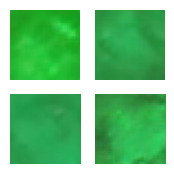

Epoch 359/1000: 100%|██████████| 87/87 [00:04<00:00, 18.69step/s]


Generator Loss: 2.313877820968628, Discriminator Loss: 0.6645477414131165


Epoch 360/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]

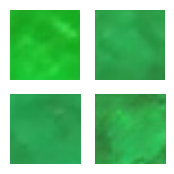

Epoch 360/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.380188226699829, Discriminator Loss: 0.6799927353858948


Epoch 361/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.86step/s]

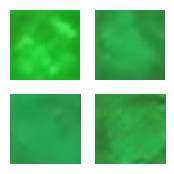

Epoch 361/1000: 100%|██████████| 87/87 [00:04<00:00, 17.59step/s]


Generator Loss: 2.246083974838257, Discriminator Loss: 0.8874996900558472


Epoch 362/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.62step/s]

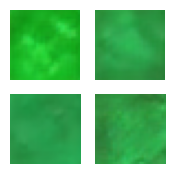

Epoch 362/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 2.1292519569396973, Discriminator Loss: 0.7208284139633179


Epoch 363/1000: 100%|██████████| 87/87 [00:04<00:00, 19.08step/s]

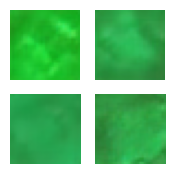

Epoch 363/1000: 100%|██████████| 87/87 [00:05<00:00, 17.15step/s]


Generator Loss: 2.24342942237854, Discriminator Loss: 0.8315796852111816


Epoch 364/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.27step/s]

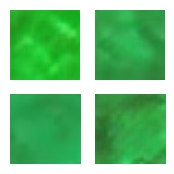

Epoch 364/1000: 100%|██████████| 87/87 [00:04<00:00, 17.67step/s]


Generator Loss: 2.3155226707458496, Discriminator Loss: 0.7740069031715393


Epoch 365/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.48step/s]

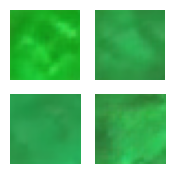

Epoch 365/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]


Generator Loss: 2.153049945831299, Discriminator Loss: 0.7956416010856628


Epoch 366/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]

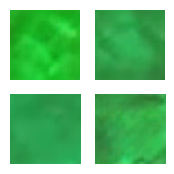

Epoch 366/1000: 100%|██████████| 87/87 [00:05<00:00, 17.19step/s]


Generator Loss: 2.097637414932251, Discriminator Loss: 0.9002094268798828


Epoch 367/1000: 100%|██████████| 87/87 [00:04<00:00, 19.56step/s]

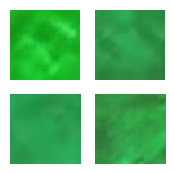

Epoch 367/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 1.9347273111343384, Discriminator Loss: 0.9497314691543579


Epoch 368/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]

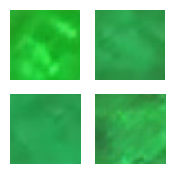

Epoch 368/1000: 100%|██████████| 87/87 [00:04<00:00, 17.85step/s]


Generator Loss: 2.3046622276306152, Discriminator Loss: 0.6823306083679199


Epoch 369/1000: 100%|██████████| 87/87 [00:04<00:00, 20.10step/s]

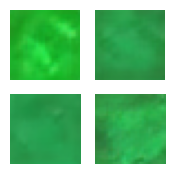

Epoch 369/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 2.390434503555298, Discriminator Loss: 0.6015112996101379


Epoch 370/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]

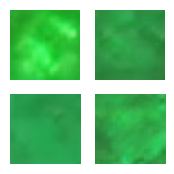

Epoch 370/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]


Generator Loss: 2.704454183578491, Discriminator Loss: 0.5333201289176941


Epoch 371/1000: 100%|██████████| 87/87 [00:04<00:00, 18.81step/s]

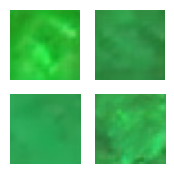

Epoch 371/1000: 100%|██████████| 87/87 [00:04<00:00, 19.12step/s]


Generator Loss: 2.4635868072509766, Discriminator Loss: 0.6649330258369446


Epoch 372/1000: 100%|██████████| 87/87 [00:04<00:00, 19.36step/s]

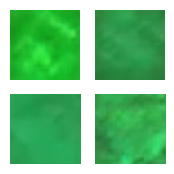

Epoch 372/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]


Generator Loss: 2.4015414714813232, Discriminator Loss: 0.7862362265586853


Epoch 373/1000: 100%|██████████| 87/87 [00:05<00:00, 17.46step/s]

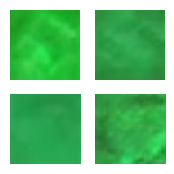

Epoch 373/1000: 100%|██████████| 87/87 [00:05<00:00, 16.61step/s]


Generator Loss: 2.5795679092407227, Discriminator Loss: 0.7135263085365295


Epoch 374/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.06step/s]

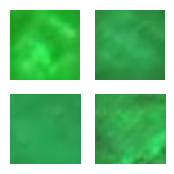

Epoch 374/1000: 100%|██████████| 87/87 [00:05<00:00, 15.55step/s]


Generator Loss: 2.158937931060791, Discriminator Loss: 0.8292208909988403


Epoch 375/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.56step/s]

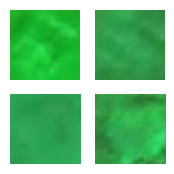

Epoch 375/1000: 100%|██████████| 87/87 [00:05<00:00, 15.64step/s]


Generator Loss: 2.534545660018921, Discriminator Loss: 0.6792888641357422


Epoch 376/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.17step/s]

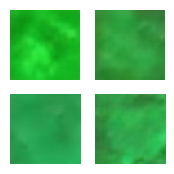

Epoch 376/1000: 100%|██████████| 87/87 [00:05<00:00, 15.31step/s]


Generator Loss: 2.407296657562256, Discriminator Loss: 0.6490280628204346


Epoch 377/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.57step/s]

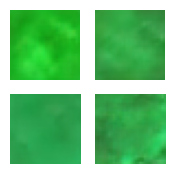

Epoch 377/1000: 100%|██████████| 87/87 [00:05<00:00, 15.04step/s]


Generator Loss: 2.520939350128174, Discriminator Loss: 0.7602408528327942


Epoch 378/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.39step/s]

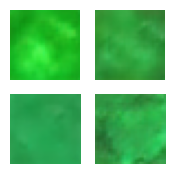

Epoch 378/1000: 100%|██████████| 87/87 [00:05<00:00, 15.62step/s]


Generator Loss: 2.2255730628967285, Discriminator Loss: 0.7745895385742188


Epoch 379/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.27step/s]

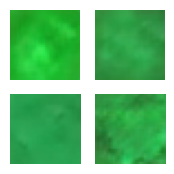

Epoch 379/1000: 100%|██████████| 87/87 [00:05<00:00, 15.11step/s]


Generator Loss: 2.5846691131591797, Discriminator Loss: 0.6724560856819153


Epoch 380/1000: 100%|██████████| 87/87 [00:05<00:00, 14.89step/s]

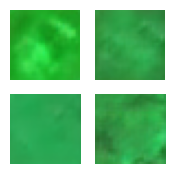

Epoch 380/1000: 100%|██████████| 87/87 [00:05<00:00, 14.82step/s]


Generator Loss: 2.2957422733306885, Discriminator Loss: 0.7551236152648926


Epoch 381/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.96step/s]

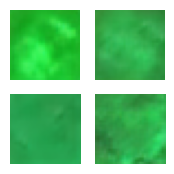

Epoch 381/1000: 100%|██████████| 87/87 [00:05<00:00, 14.85step/s]


Generator Loss: 2.358147144317627, Discriminator Loss: 0.805732011795044


Epoch 382/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.78step/s]

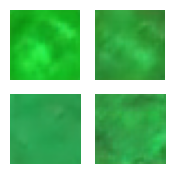

Epoch 382/1000: 100%|██████████| 87/87 [00:05<00:00, 14.98step/s]


Generator Loss: 2.373394012451172, Discriminator Loss: 0.9235363602638245


Epoch 383/1000: 100%|██████████| 87/87 [00:05<00:00, 20.88step/s]

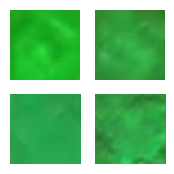

Epoch 383/1000: 100%|██████████| 87/87 [00:05<00:00, 16.27step/s]


Generator Loss: 2.268193006515503, Discriminator Loss: 0.7475008964538574


Epoch 384/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.64step/s]

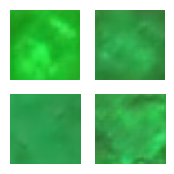

Epoch 384/1000: 100%|██████████| 87/87 [00:04<00:00, 19.53step/s]


Generator Loss: 2.17734694480896, Discriminator Loss: 0.7987333536148071


Epoch 385/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.55step/s]

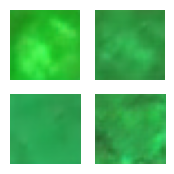

Epoch 385/1000: 100%|██████████| 87/87 [00:04<00:00, 18.85step/s]


Generator Loss: 2.5815317630767822, Discriminator Loss: 0.6477029919624329


Epoch 386/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.61step/s]

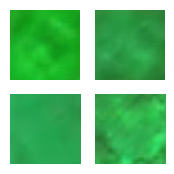

Epoch 386/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.48604416847229, Discriminator Loss: 0.5402716994285583


Epoch 387/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.19step/s]

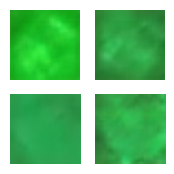

Epoch 387/1000: 100%|██████████| 87/87 [00:04<00:00, 19.08step/s]


Generator Loss: 2.558929681777954, Discriminator Loss: 0.5480239391326904


Epoch 388/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]

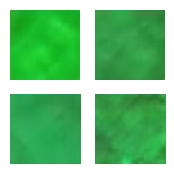

Epoch 388/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 2.407186985015869, Discriminator Loss: 0.6412056684494019


Epoch 389/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.94step/s]

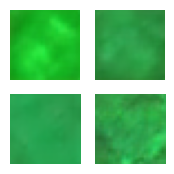

Epoch 389/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 2.4127442836761475, Discriminator Loss: 0.7601242065429688


Epoch 390/1000: 100%|██████████| 87/87 [00:04<00:00, 18.28step/s]

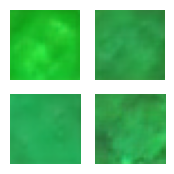

Epoch 390/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 2.326521873474121, Discriminator Loss: 0.767554521560669


Epoch 391/1000: 100%|██████████| 87/87 [00:04<00:00, 19.06step/s]

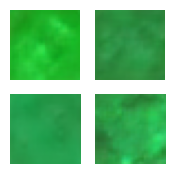

Epoch 391/1000: 100%|██████████| 87/87 [00:04<00:00, 19.12step/s]


Generator Loss: 2.481213331222534, Discriminator Loss: 0.7153677344322205


Epoch 392/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.92step/s]

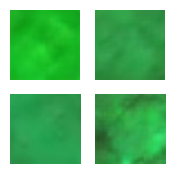

Epoch 392/1000: 100%|██████████| 87/87 [00:04<00:00, 18.81step/s]


Generator Loss: 2.745891809463501, Discriminator Loss: 0.5542787313461304


Epoch 393/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.08step/s]

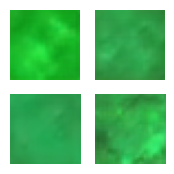

Epoch 393/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 2.3891704082489014, Discriminator Loss: 0.7894262671470642


Epoch 394/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.76step/s]

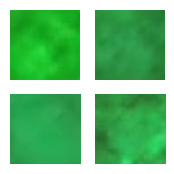

Epoch 394/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]


Generator Loss: 2.1672470569610596, Discriminator Loss: 0.8910825252532959


Epoch 395/1000: 100%|██████████| 87/87 [00:04<00:00, 17.95step/s]

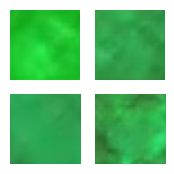

Epoch 395/1000: 100%|██████████| 87/87 [00:04<00:00, 18.99step/s]


Generator Loss: 2.727968692779541, Discriminator Loss: 0.6168968081474304


Epoch 396/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.19step/s]

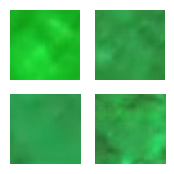

Epoch 396/1000: 100%|██████████| 87/87 [00:04<00:00, 18.79step/s]


Generator Loss: 2.6693930625915527, Discriminator Loss: 0.4748983681201935


Epoch 397/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.79step/s]

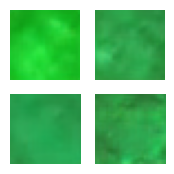

Epoch 397/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]


Generator Loss: 2.7081103324890137, Discriminator Loss: 0.546318769454956


Epoch 398/1000: 100%|██████████| 87/87 [00:04<00:00, 19.54step/s]

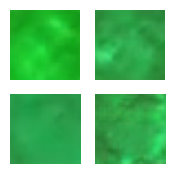

Epoch 398/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 2.4244182109832764, Discriminator Loss: 0.6921326518058777


Epoch 399/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.80step/s]

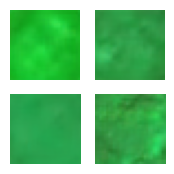

Epoch 399/1000: 100%|██████████| 87/87 [00:04<00:00, 18.67step/s]


Generator Loss: 2.1571476459503174, Discriminator Loss: 0.8477138876914978


Epoch 400/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.84step/s]

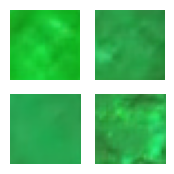

Epoch 400/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.445038080215454, Discriminator Loss: 0.7262724041938782


Epoch 401/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.09step/s]

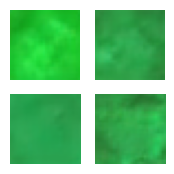

Epoch 401/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 2.418483257293701, Discriminator Loss: 0.6577292680740356


Epoch 402/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.14step/s]

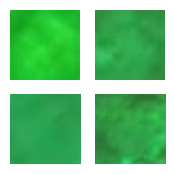

Epoch 402/1000: 100%|██████████| 87/87 [00:04<00:00, 17.91step/s]


Generator Loss: 2.661736249923706, Discriminator Loss: 0.7113007307052612


Epoch 403/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.98step/s]

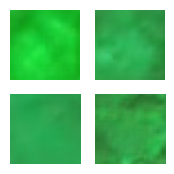

Epoch 403/1000: 100%|██████████| 87/87 [00:04<00:00, 18.33step/s]


Generator Loss: 2.441627264022827, Discriminator Loss: 0.6584678888320923


Epoch 404/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]

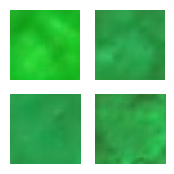

Epoch 404/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 2.2408204078674316, Discriminator Loss: 0.822852373123169


Epoch 405/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.07step/s]

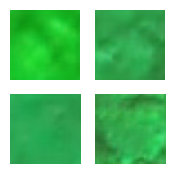

Epoch 405/1000: 100%|██████████| 87/87 [00:04<00:00, 19.29step/s]


Generator Loss: 2.41618013381958, Discriminator Loss: 0.6718052625656128


Epoch 406/1000: 100%|██████████| 87/87 [00:04<00:00, 16.91step/s]

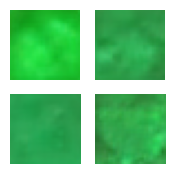

Epoch 406/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.5917110443115234, Discriminator Loss: 0.6226480603218079


Epoch 407/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.72step/s]

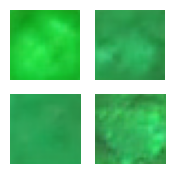

Epoch 407/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]


Generator Loss: 2.2193827629089355, Discriminator Loss: 0.8886099457740784


Epoch 408/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.97step/s]

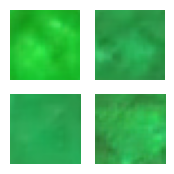

Epoch 408/1000: 100%|██████████| 87/87 [00:04<00:00, 17.93step/s]


Generator Loss: 2.205662965774536, Discriminator Loss: 0.7587617635726929


Epoch 409/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.19step/s]

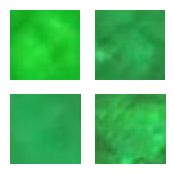

Epoch 409/1000: 100%|██████████| 87/87 [00:04<00:00, 17.55step/s]


Generator Loss: 2.4036643505096436, Discriminator Loss: 0.6365935802459717


Epoch 410/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.43step/s]

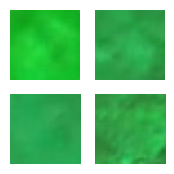

Epoch 410/1000: 100%|██████████| 87/87 [00:05<00:00, 16.71step/s]


Generator Loss: 2.160817861557007, Discriminator Loss: 0.934213399887085


Epoch 411/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.91step/s]

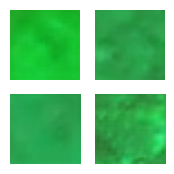

Epoch 411/1000: 100%|██████████| 87/87 [00:04<00:00, 17.41step/s]


Generator Loss: 2.558093786239624, Discriminator Loss: 0.6872377991676331


Epoch 412/1000: 100%|██████████| 87/87 [00:04<00:00, 18.77step/s]

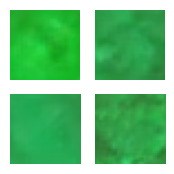

Epoch 412/1000: 100%|██████████| 87/87 [00:04<00:00, 18.03step/s]


Generator Loss: 2.304795980453491, Discriminator Loss: 0.7038171887397766


Epoch 413/1000: 100%|██████████| 87/87 [00:04<00:00, 15.80step/s]

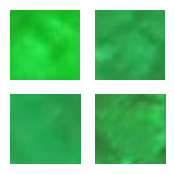

Epoch 413/1000: 100%|██████████| 87/87 [00:05<00:00, 17.12step/s]


Generator Loss: 2.372156858444214, Discriminator Loss: 0.6404919624328613


Epoch 414/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.98step/s]

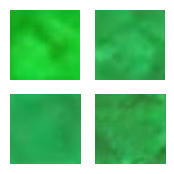

Epoch 414/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]


Generator Loss: 2.618098497390747, Discriminator Loss: 0.6888479590415955


Epoch 415/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.49step/s]

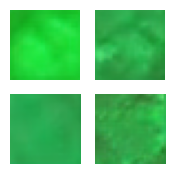

Epoch 415/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 2.7795825004577637, Discriminator Loss: 0.5970415472984314


Epoch 416/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.13step/s]

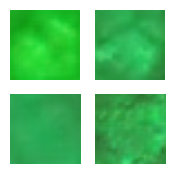

Epoch 416/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 2.7596545219421387, Discriminator Loss: 0.6279821991920471


Epoch 417/1000: 100%|██████████| 87/87 [00:04<00:00, 19.60step/s]

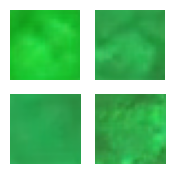

Epoch 417/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 2.2904813289642334, Discriminator Loss: 0.7442075610160828


Epoch 418/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.48step/s]

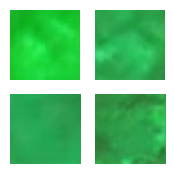

Epoch 418/1000: 100%|██████████| 87/87 [00:04<00:00, 18.77step/s]


Generator Loss: 2.380528450012207, Discriminator Loss: 0.8203889727592468


Epoch 419/1000: 100%|██████████| 87/87 [00:04<00:00, 17.66step/s]

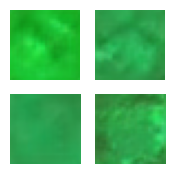

Epoch 419/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 2.3547983169555664, Discriminator Loss: 0.7275636196136475


Epoch 420/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.45step/s]

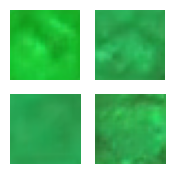

Epoch 420/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 2.5855579376220703, Discriminator Loss: 0.599656343460083


Epoch 421/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.63step/s]

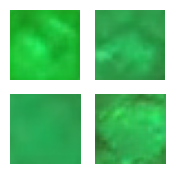

Epoch 421/1000: 100%|██████████| 87/87 [00:05<00:00, 16.62step/s]


Generator Loss: 2.57818865776062, Discriminator Loss: 0.6807507276535034


Epoch 422/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.61step/s]

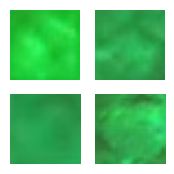

Epoch 422/1000: 100%|██████████| 87/87 [00:05<00:00, 15.41step/s]


Generator Loss: 3.014158010482788, Discriminator Loss: 0.6219810843467712


Epoch 423/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.47step/s]

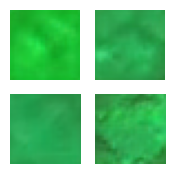

Epoch 423/1000: 100%|██████████| 87/87 [00:05<00:00, 15.23step/s]


Generator Loss: 2.6057357788085938, Discriminator Loss: 0.5960990190505981


Epoch 424/1000: 100%|██████████| 87/87 [00:05<00:00, 15.90step/s]

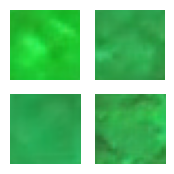

Epoch 424/1000: 100%|██████████| 87/87 [00:05<00:00, 15.54step/s]


Generator Loss: 2.403017044067383, Discriminator Loss: 0.7620080709457397


Epoch 425/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.06step/s]

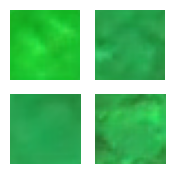

Epoch 425/1000: 100%|██████████| 87/87 [00:05<00:00, 15.15step/s]


Generator Loss: 2.9155783653259277, Discriminator Loss: 0.49998652935028076


Epoch 426/1000: 100%|██████████| 87/87 [00:05<00:00, 15.35step/s]

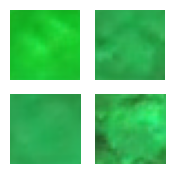

Epoch 426/1000: 100%|██████████| 87/87 [00:05<00:00, 15.33step/s]


Generator Loss: 2.5279736518859863, Discriminator Loss: 0.6890936493873596


Epoch 427/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.10step/s]

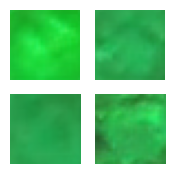

Epoch 427/1000: 100%|██████████| 87/87 [00:05<00:00, 15.17step/s]


Generator Loss: 2.9161643981933594, Discriminator Loss: 0.4842323362827301


Epoch 428/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.96step/s]

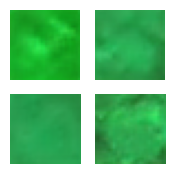

Epoch 428/1000: 100%|██████████| 87/87 [00:06<00:00, 14.41step/s]


Generator Loss: 2.7535736560821533, Discriminator Loss: 0.5427333116531372


Epoch 429/1000: 100%|██████████| 87/87 [00:05<00:00, 15.50step/s]

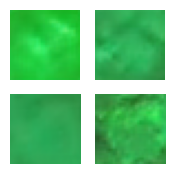

Epoch 429/1000: 100%|██████████| 87/87 [00:05<00:00, 14.76step/s]


Generator Loss: 2.7889740467071533, Discriminator Loss: 0.6364882588386536


Epoch 430/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.92step/s]

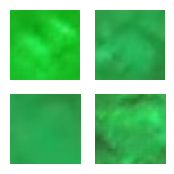

Epoch 430/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 2.9445860385894775, Discriminator Loss: 0.558332085609436


Epoch 431/1000:  98%|█████████▊| 85/87 [00:05<00:00, 19.18step/s]

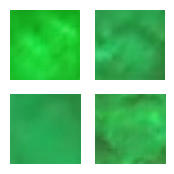

Epoch 431/1000: 100%|██████████| 87/87 [00:05<00:00, 15.28step/s]


Generator Loss: 2.8992037773132324, Discriminator Loss: 0.5252044796943665


Epoch 432/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.93step/s]

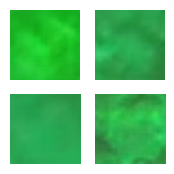

Epoch 432/1000: 100%|██████████| 87/87 [00:04<00:00, 19.31step/s]


Generator Loss: 2.721325397491455, Discriminator Loss: 0.6660096645355225


Epoch 433/1000: 100%|██████████| 87/87 [00:04<00:00, 17.00step/s]

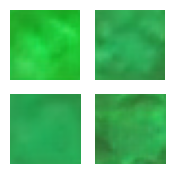

Epoch 433/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 2.4855761528015137, Discriminator Loss: 0.7481052875518799


Epoch 434/1000: 100%|██████████| 87/87 [00:04<00:00, 17.95step/s]

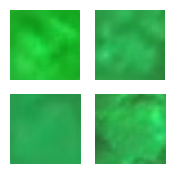

Epoch 434/1000: 100%|██████████| 87/87 [00:04<00:00, 18.33step/s]


Generator Loss: 2.5699737071990967, Discriminator Loss: 0.6398276686668396


Epoch 435/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.07step/s]

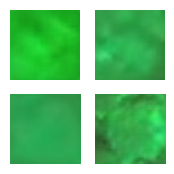

Epoch 435/1000: 100%|██████████| 87/87 [00:04<00:00, 19.47step/s]


Generator Loss: 2.376725912094116, Discriminator Loss: 0.8293614983558655


Epoch 436/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.40step/s]

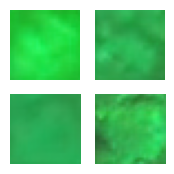

Epoch 436/1000: 100%|██████████| 87/87 [00:04<00:00, 19.20step/s]


Generator Loss: 2.390627861022949, Discriminator Loss: 0.5733544230461121


Epoch 437/1000: 100%|██████████| 87/87 [00:04<00:00, 21.25step/s]

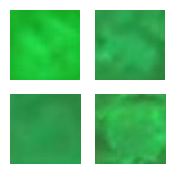

Epoch 437/1000: 100%|██████████| 87/87 [00:04<00:00, 19.07step/s]


Generator Loss: 2.8208377361297607, Discriminator Loss: 0.5291596055030823


Epoch 438/1000: 100%|██████████| 87/87 [00:04<00:00, 19.03step/s]

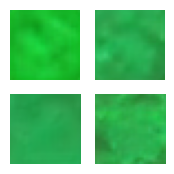

Epoch 438/1000: 100%|██████████| 87/87 [00:04<00:00, 19.24step/s]


Generator Loss: 3.1128807067871094, Discriminator Loss: 0.5514569878578186


Epoch 439/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.90step/s]

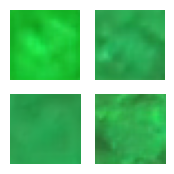

Epoch 439/1000: 100%|██████████| 87/87 [00:04<00:00, 19.05step/s]


Generator Loss: 2.7928662300109863, Discriminator Loss: 0.5339965224266052


Epoch 440/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.50step/s]

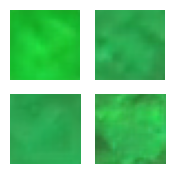

Epoch 440/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 2.796872615814209, Discriminator Loss: 0.6097303628921509


Epoch 441/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]

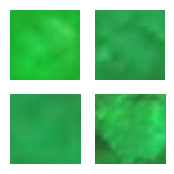

Epoch 441/1000: 100%|██████████| 87/87 [00:04<00:00, 18.79step/s]


Generator Loss: 2.8986823558807373, Discriminator Loss: 0.6568949222564697


Epoch 442/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.73step/s]

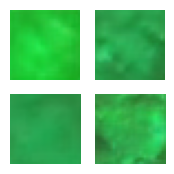

Epoch 442/1000: 100%|██████████| 87/87 [00:04<00:00, 19.00step/s]


Generator Loss: 2.725651264190674, Discriminator Loss: 0.609237790107727


Epoch 443/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.56step/s]

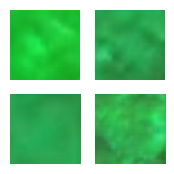

Epoch 443/1000: 100%|██████████| 87/87 [00:04<00:00, 19.56step/s]


Generator Loss: 2.700247287750244, Discriminator Loss: 0.6075775027275085


Epoch 444/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.77step/s]

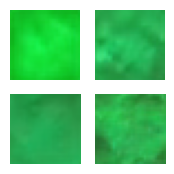

Epoch 444/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 3.1505467891693115, Discriminator Loss: 0.6772983074188232


Epoch 445/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.30step/s]

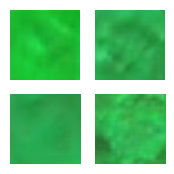

Epoch 445/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]


Generator Loss: 3.3188998699188232, Discriminator Loss: 0.39540162682533264


Epoch 446/1000: 100%|██████████| 87/87 [00:04<00:00, 19.34step/s]

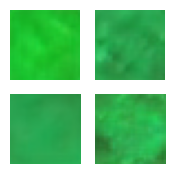

Epoch 446/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]


Generator Loss: 2.666532039642334, Discriminator Loss: 0.6935800909996033


Epoch 447/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.01step/s]

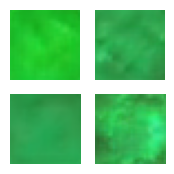

Epoch 447/1000: 100%|██████████| 87/87 [00:04<00:00, 18.99step/s]


Generator Loss: 2.777806043624878, Discriminator Loss: 0.621505618095398


Epoch 448/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.73step/s]

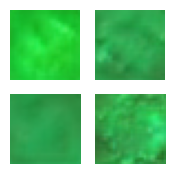

Epoch 448/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 2.794219493865967, Discriminator Loss: 0.5499964952468872


Epoch 449/1000: 100%|██████████| 87/87 [00:04<00:00, 19.61step/s]

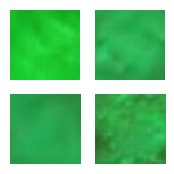

Epoch 449/1000: 100%|██████████| 87/87 [00:04<00:00, 18.62step/s]


Generator Loss: 2.4205574989318848, Discriminator Loss: 0.8195480704307556


Epoch 450/1000: 100%|██████████| 87/87 [00:04<00:00, 17.51step/s]

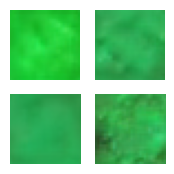

Epoch 450/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 2.4488892555236816, Discriminator Loss: 0.6489701271057129


Epoch 451/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.10step/s]

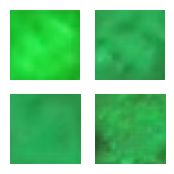

Epoch 451/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 2.818915605545044, Discriminator Loss: 0.5434062480926514


Epoch 452/1000: 100%|██████████| 87/87 [00:04<00:00, 19.90step/s]

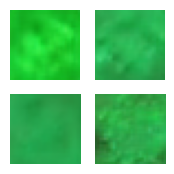

Epoch 452/1000: 100%|██████████| 87/87 [00:05<00:00, 17.39step/s]


Generator Loss: 2.5785014629364014, Discriminator Loss: 0.609555184841156


Epoch 453/1000:  98%|█████████▊| 85/87 [00:04<00:00, 16.04step/s]

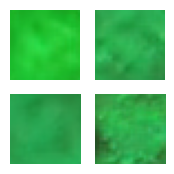

Epoch 453/1000: 100%|██████████| 87/87 [00:05<00:00, 16.79step/s]


Generator Loss: 2.7477993965148926, Discriminator Loss: 0.7108730673789978


Epoch 454/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]

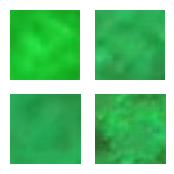

Epoch 454/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 2.3690547943115234, Discriminator Loss: 0.8426573276519775


Epoch 455/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.31step/s]

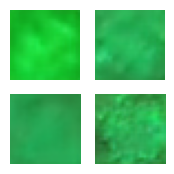

Epoch 455/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 2.7998228073120117, Discriminator Loss: 0.5300803184509277


Epoch 456/1000: 100%|██████████| 87/87 [00:04<00:00, 20.13step/s]

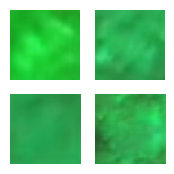

Epoch 456/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 2.6309242248535156, Discriminator Loss: 0.6202174425125122


Epoch 457/1000: 100%|██████████| 87/87 [00:04<00:00, 20.55step/s]

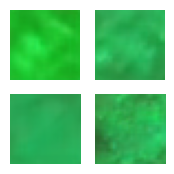

Epoch 457/1000: 100%|██████████| 87/87 [00:04<00:00, 19.47step/s]


Generator Loss: 2.733947992324829, Discriminator Loss: 0.6534870862960815


Epoch 458/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.10step/s]

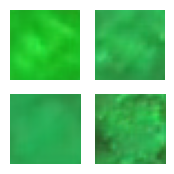

Epoch 458/1000: 100%|██████████| 87/87 [00:05<00:00, 16.92step/s]


Generator Loss: 2.8519670963287354, Discriminator Loss: 0.59002685546875


Epoch 459/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.01step/s]

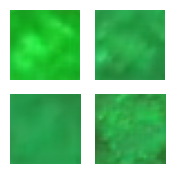

Epoch 459/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 3.117447853088379, Discriminator Loss: 0.5857096910476685


Epoch 460/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]

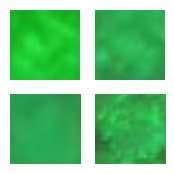

Epoch 460/1000: 100%|██████████| 87/87 [00:04<00:00, 18.07step/s]


Generator Loss: 2.9056320190429688, Discriminator Loss: 0.5619394779205322


Epoch 461/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.58step/s]

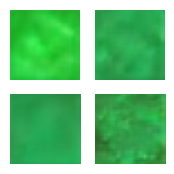

Epoch 461/1000: 100%|██████████| 87/87 [00:04<00:00, 17.46step/s]


Generator Loss: 2.391204595565796, Discriminator Loss: 0.7708688378334045


Epoch 462/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.86step/s]

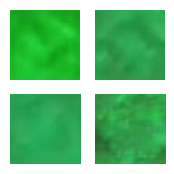

Epoch 462/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 2.749896764755249, Discriminator Loss: 0.6202224493026733


Epoch 463/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.08step/s]

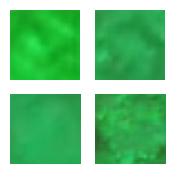

Epoch 463/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 2.575829267501831, Discriminator Loss: 0.7164506316184998


Epoch 464/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.15step/s]

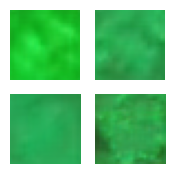

Epoch 464/1000: 100%|██████████| 87/87 [00:04<00:00, 18.31step/s]


Generator Loss: 2.5073273181915283, Discriminator Loss: 0.7017743587493896


Epoch 465/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.44step/s]

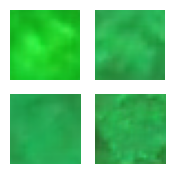

Epoch 465/1000: 100%|██████████| 87/87 [00:05<00:00, 17.23step/s]


Generator Loss: 2.8103067874908447, Discriminator Loss: 0.6004409790039062


Epoch 466/1000: 100%|██████████| 87/87 [00:04<00:00, 18.98step/s]

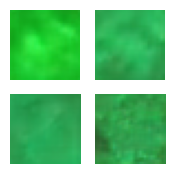

Epoch 466/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 2.718555450439453, Discriminator Loss: 0.6787161827087402


Epoch 467/1000: 100%|██████████| 87/87 [00:04<00:00, 19.75step/s]

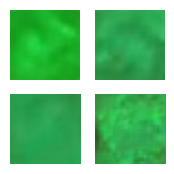

Epoch 467/1000: 100%|██████████| 87/87 [00:04<00:00, 18.49step/s]


Generator Loss: 2.499138832092285, Discriminator Loss: 0.6538393497467041


Epoch 468/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.74step/s]

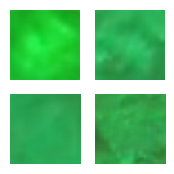

Epoch 468/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 2.737096071243286, Discriminator Loss: 0.5552279949188232


Epoch 469/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.56step/s]

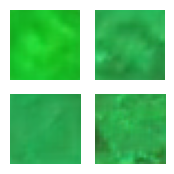

Epoch 469/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 3.1004104614257812, Discriminator Loss: 0.6061291098594666


Epoch 470/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.25step/s]

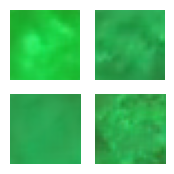

Epoch 470/1000: 100%|██████████| 87/87 [00:05<00:00, 14.89step/s]


Generator Loss: 2.9815659523010254, Discriminator Loss: 0.4647650420665741


Epoch 471/1000: 100%|██████████| 87/87 [00:05<00:00, 15.37step/s]

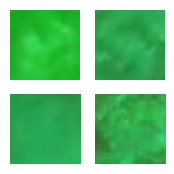

Epoch 471/1000: 100%|██████████| 87/87 [00:05<00:00, 15.49step/s]


Generator Loss: 2.687683343887329, Discriminator Loss: 0.6187834143638611


Epoch 472/1000: 100%|██████████| 87/87 [00:05<00:00, 16.34step/s]

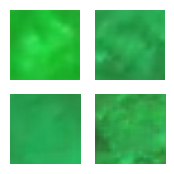

Epoch 472/1000: 100%|██████████| 87/87 [00:05<00:00, 15.44step/s]


Generator Loss: 2.555166721343994, Discriminator Loss: 0.652485191822052


Epoch 473/1000: 100%|██████████| 87/87 [00:05<00:00, 15.84step/s]

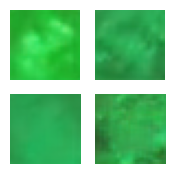

Epoch 473/1000: 100%|██████████| 87/87 [00:05<00:00, 15.54step/s]


Generator Loss: 2.6720283031463623, Discriminator Loss: 0.6375862956047058


Epoch 474/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.00step/s]

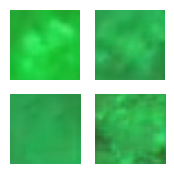

Epoch 474/1000: 100%|██████████| 87/87 [00:05<00:00, 15.22step/s]


Generator Loss: 2.556035280227661, Discriminator Loss: 0.8336031436920166


Epoch 475/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.32step/s]

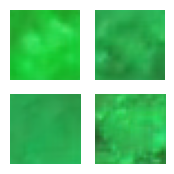

Epoch 475/1000: 100%|██████████| 87/87 [00:06<00:00, 14.50step/s]


Generator Loss: 2.654796838760376, Discriminator Loss: 0.5926886796951294


Epoch 476/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.60step/s]

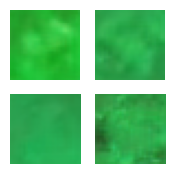

Epoch 476/1000: 100%|██████████| 87/87 [00:05<00:00, 15.29step/s]


Generator Loss: 2.703636884689331, Discriminator Loss: 0.7204380035400391


Epoch 477/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.55step/s]

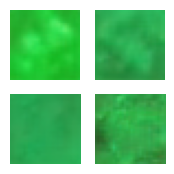

Epoch 477/1000: 100%|██████████| 87/87 [00:05<00:00, 14.59step/s]


Generator Loss: 2.572347640991211, Discriminator Loss: 0.7823870182037354


Epoch 478/1000: 100%|██████████| 87/87 [00:05<00:00, 15.31step/s]

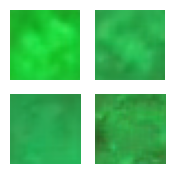

Epoch 478/1000: 100%|██████████| 87/87 [00:05<00:00, 14.71step/s]


Generator Loss: 2.6826975345611572, Discriminator Loss: 0.6230481863021851


Epoch 479/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.92step/s]

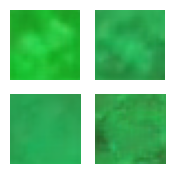

Epoch 479/1000: 100%|██████████| 87/87 [00:05<00:00, 14.51step/s]


Generator Loss: 2.4091715812683105, Discriminator Loss: 0.715194046497345


Epoch 480/1000: 100%|██████████| 87/87 [00:04<00:00, 20.03step/s]

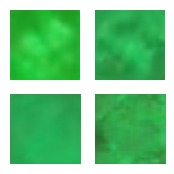

Epoch 480/1000: 100%|██████████| 87/87 [00:04<00:00, 18.62step/s]


Generator Loss: 2.905914545059204, Discriminator Loss: 0.47631382942199707


Epoch 481/1000: 100%|██████████| 87/87 [00:04<00:00, 18.13step/s]

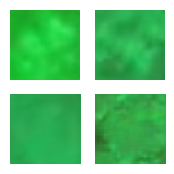

Epoch 481/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 2.7605979442596436, Discriminator Loss: 0.7269251346588135


Epoch 482/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.65step/s]

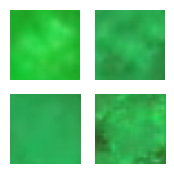

Epoch 482/1000: 100%|██████████| 87/87 [00:04<00:00, 17.71step/s]


Generator Loss: 2.6300253868103027, Discriminator Loss: 0.6660404801368713


Epoch 483/1000: 100%|██████████| 87/87 [00:04<00:00, 21.03step/s]

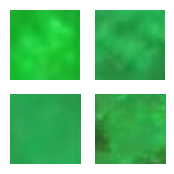

Epoch 483/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 3.0489792823791504, Discriminator Loss: 0.6025943756103516


Epoch 484/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.56step/s]

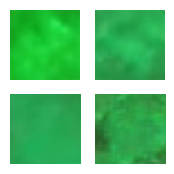

Epoch 484/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]


Generator Loss: 2.806722640991211, Discriminator Loss: 0.506257176399231


Epoch 485/1000: 100%|██████████| 87/87 [00:04<00:00, 17.48step/s]

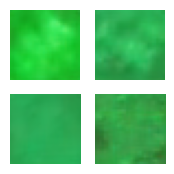

Epoch 485/1000: 100%|██████████| 87/87 [00:04<00:00, 18.14step/s]


Generator Loss: 2.8278555870056152, Discriminator Loss: 0.6143516302108765


Epoch 486/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.77step/s]

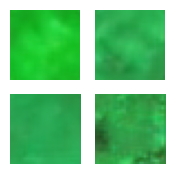

Epoch 486/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 2.420822858810425, Discriminator Loss: 0.8482895493507385


Epoch 487/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.18step/s]

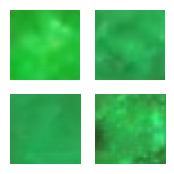

Epoch 487/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 2.6777491569519043, Discriminator Loss: 0.6506200432777405


Epoch 488/1000: 100%|██████████| 87/87 [00:04<00:00, 19.27step/s]

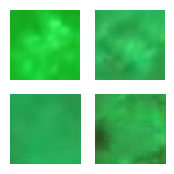

Epoch 488/1000: 100%|██████████| 87/87 [00:04<00:00, 18.19step/s]


Generator Loss: 2.726005792617798, Discriminator Loss: 0.6504184603691101


Epoch 489/1000: 100%|██████████| 87/87 [00:04<00:00, 19.32step/s]

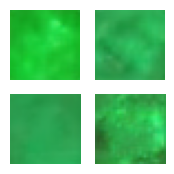

Epoch 489/1000: 100%|██████████| 87/87 [00:04<00:00, 18.39step/s]


Generator Loss: 3.110332727432251, Discriminator Loss: 0.5273916721343994


Epoch 490/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.40step/s]

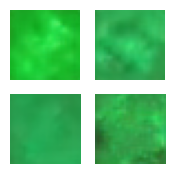

Epoch 490/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 2.5054471492767334, Discriminator Loss: 0.639346182346344


Epoch 491/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.48step/s]

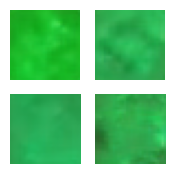

Epoch 491/1000: 100%|██████████| 87/87 [00:04<00:00, 18.49step/s]


Generator Loss: 2.8810880184173584, Discriminator Loss: 0.527631402015686


Epoch 492/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.95step/s]

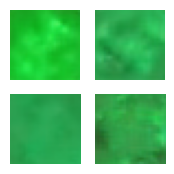

Epoch 492/1000: 100%|██████████| 87/87 [00:04<00:00, 18.66step/s]


Generator Loss: 2.790424108505249, Discriminator Loss: 0.592610239982605


Epoch 493/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.82step/s]

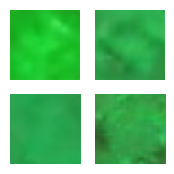

Epoch 493/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 2.925447702407837, Discriminator Loss: 0.7437357306480408


Epoch 494/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.98step/s]

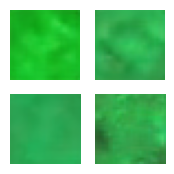

Epoch 494/1000: 100%|██████████| 87/87 [00:04<00:00, 17.89step/s]


Generator Loss: 3.0053985118865967, Discriminator Loss: 0.5407776236534119


Epoch 495/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.48step/s]

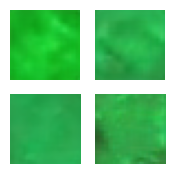

Epoch 495/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 2.7434377670288086, Discriminator Loss: 0.6619779467582703


Epoch 496/1000: 100%|██████████| 87/87 [00:04<00:00, 20.53step/s]

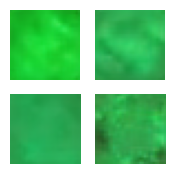

Epoch 496/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]


Generator Loss: 2.8754143714904785, Discriminator Loss: 0.5518792867660522


Epoch 497/1000: 100%|██████████| 87/87 [00:04<00:00, 17.60step/s]

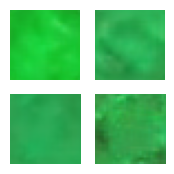

Epoch 497/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 2.8749914169311523, Discriminator Loss: 0.6679474711418152


Epoch 498/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.28step/s]

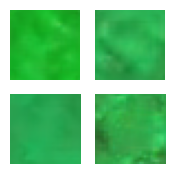

Epoch 498/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 2.5042426586151123, Discriminator Loss: 0.8720867037773132


Epoch 499/1000: 100%|██████████| 87/87 [00:04<00:00, 21.03step/s]

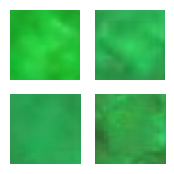

Epoch 499/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 2.9420721530914307, Discriminator Loss: 0.5357387065887451


Epoch 500/1000: 100%|██████████| 87/87 [00:04<00:00, 19.34step/s]

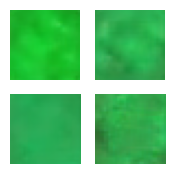

Epoch 500/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 2.837350368499756, Discriminator Loss: 0.6079578399658203


Epoch 501/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]

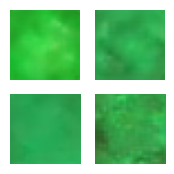

Epoch 501/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 2.6647863388061523, Discriminator Loss: 0.6427204608917236


Epoch 502/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.91step/s]

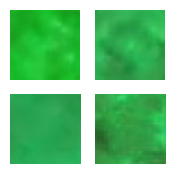

Epoch 502/1000: 100%|██████████| 87/87 [00:04<00:00, 18.90step/s]


Generator Loss: 3.138157367706299, Discriminator Loss: 0.7004532217979431


Epoch 503/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]

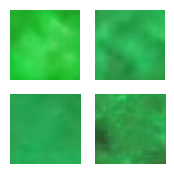

Epoch 503/1000: 100%|██████████| 87/87 [00:04<00:00, 17.83step/s]


Generator Loss: 2.4758448600769043, Discriminator Loss: 0.7908425331115723


Epoch 504/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]

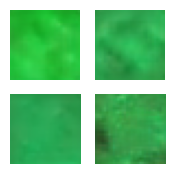

Epoch 504/1000: 100%|██████████| 87/87 [00:04<00:00, 18.08step/s]


Generator Loss: 2.6553070545196533, Discriminator Loss: 0.6434539556503296


Epoch 505/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]

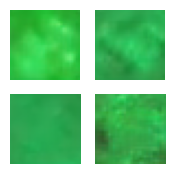

Epoch 505/1000: 100%|██████████| 87/87 [00:04<00:00, 17.91step/s]


Generator Loss: 2.471255302429199, Discriminator Loss: 0.6767539381980896


Epoch 506/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]

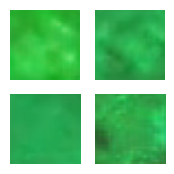

Epoch 506/1000: 100%|██████████| 87/87 [00:04<00:00, 17.46step/s]


Generator Loss: 2.34324049949646, Discriminator Loss: 0.7117917537689209


Epoch 507/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.83step/s]

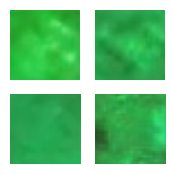

Epoch 507/1000: 100%|██████████| 87/87 [00:04<00:00, 17.95step/s]


Generator Loss: 2.8442084789276123, Discriminator Loss: 0.514417827129364


Epoch 508/1000: 100%|██████████| 87/87 [00:04<00:00, 17.29step/s]

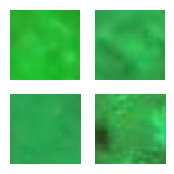

Epoch 508/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 2.984988212585449, Discriminator Loss: 0.4831834137439728


Epoch 509/1000: 100%|██████████| 87/87 [00:04<00:00, 17.17step/s]

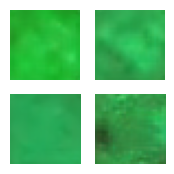

Epoch 509/1000: 100%|██████████| 87/87 [00:04<00:00, 17.55step/s]


Generator Loss: 2.963618755340576, Discriminator Loss: 0.5259134769439697


Epoch 510/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.73step/s]

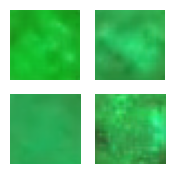

Epoch 510/1000: 100%|██████████| 87/87 [00:04<00:00, 17.41step/s]


Generator Loss: 2.85374116897583, Discriminator Loss: 0.5427786111831665


Epoch 511/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.05step/s]

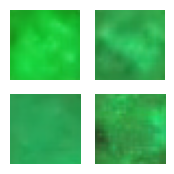

Epoch 511/1000: 100%|██████████| 87/87 [00:04<00:00, 18.45step/s]


Generator Loss: 3.072568416595459, Discriminator Loss: 0.44796523451805115


Epoch 512/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.46step/s]

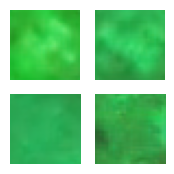

Epoch 512/1000: 100%|██████████| 87/87 [00:04<00:00, 19.52step/s]


Generator Loss: 2.71891188621521, Discriminator Loss: 0.5673537254333496


Epoch 513/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.12step/s]

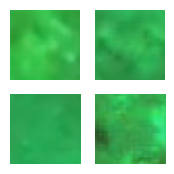

Epoch 513/1000: 100%|██████████| 87/87 [00:04<00:00, 17.69step/s]


Generator Loss: 2.7813711166381836, Discriminator Loss: 0.711963415145874


Epoch 514/1000: 100%|██████████| 87/87 [00:04<00:00, 18.45step/s]

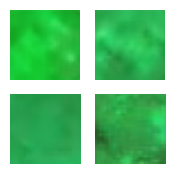

Epoch 514/1000: 100%|██████████| 87/87 [00:04<00:00, 18.51step/s]


Generator Loss: 2.5330164432525635, Discriminator Loss: 0.6482495069503784


Epoch 515/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]

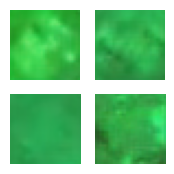

Epoch 515/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]


Generator Loss: 2.7462894916534424, Discriminator Loss: 0.574708104133606


Epoch 516/1000: 100%|██████████| 87/87 [00:04<00:00, 18.90step/s]

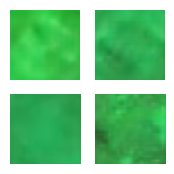

Epoch 516/1000: 100%|██████████| 87/87 [00:04<00:00, 17.78step/s]


Generator Loss: 3.1649723052978516, Discriminator Loss: 0.5869515538215637


Epoch 517/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.50step/s]

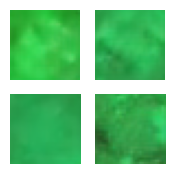

Epoch 517/1000: 100%|██████████| 87/87 [00:04<00:00, 18.35step/s]


Generator Loss: 2.798703670501709, Discriminator Loss: 0.661109983921051


Epoch 518/1000: 100%|██████████| 87/87 [00:05<00:00, 16.75step/s]

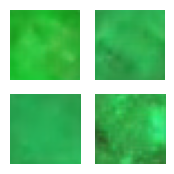

Epoch 518/1000: 100%|██████████| 87/87 [00:05<00:00, 15.10step/s]


Generator Loss: 2.7143213748931885, Discriminator Loss: 0.5826378464698792


Epoch 519/1000: 100%|██████████| 87/87 [00:05<00:00, 14.94step/s]

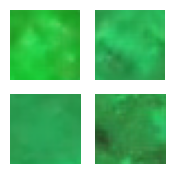

Epoch 519/1000: 100%|██████████| 87/87 [00:05<00:00, 15.27step/s]


Generator Loss: 2.900456666946411, Discriminator Loss: 0.7072215676307678


Epoch 520/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.28step/s]

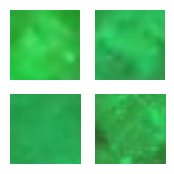

Epoch 520/1000: 100%|██████████| 87/87 [00:05<00:00, 15.88step/s]


Generator Loss: 2.822244644165039, Discriminator Loss: 0.6931819915771484


Epoch 521/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.12step/s]

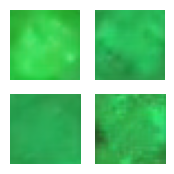

Epoch 521/1000: 100%|██████████| 87/87 [00:05<00:00, 15.50step/s]


Generator Loss: 2.929518461227417, Discriminator Loss: 0.49555209279060364


Epoch 522/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.20step/s]

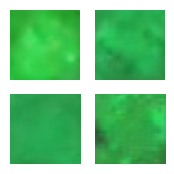

Epoch 522/1000: 100%|██████████| 87/87 [00:05<00:00, 15.41step/s]


Generator Loss: 3.155475378036499, Discriminator Loss: 0.5515487790107727


Epoch 523/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.21step/s]

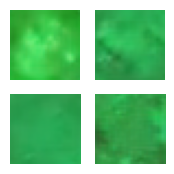

Epoch 523/1000: 100%|██████████| 87/87 [00:05<00:00, 14.80step/s]


Generator Loss: 2.890345573425293, Discriminator Loss: 0.5414509773254395


Epoch 524/1000: 100%|██████████| 87/87 [00:05<00:00, 16.44step/s]

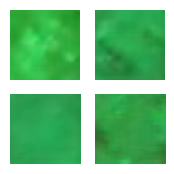

Epoch 524/1000: 100%|██████████| 87/87 [00:05<00:00, 15.27step/s]


Generator Loss: 2.8132073879241943, Discriminator Loss: 0.5752783417701721


Epoch 525/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.45step/s]

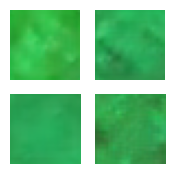

Epoch 525/1000: 100%|██████████| 87/87 [00:05<00:00, 14.96step/s]


Generator Loss: 3.3809313774108887, Discriminator Loss: 0.43979233503341675


Epoch 526/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.92step/s]

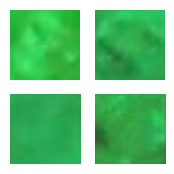

Epoch 526/1000: 100%|██████████| 87/87 [00:06<00:00, 14.36step/s]


Generator Loss: 3.075446367263794, Discriminator Loss: 0.5404334664344788


Epoch 527/1000:  99%|█████████▉| 86/87 [00:05<00:00, 13.76step/s]

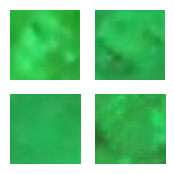

Epoch 527/1000: 100%|██████████| 87/87 [00:06<00:00, 14.36step/s]


Generator Loss: 2.8327832221984863, Discriminator Loss: 0.717724621295929


Epoch 528/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.63step/s]

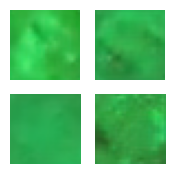

Epoch 528/1000: 100%|██████████| 87/87 [00:04<00:00, 18.00step/s]


Generator Loss: 2.862595796585083, Discriminator Loss: 0.5440856218338013


Epoch 529/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.46step/s]

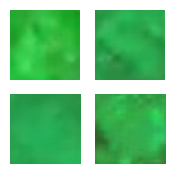

Epoch 529/1000: 100%|██████████| 87/87 [00:04<00:00, 19.18step/s]


Generator Loss: 2.5109758377075195, Discriminator Loss: 0.804874837398529


Epoch 530/1000: 100%|██████████| 87/87 [00:04<00:00, 20.49step/s]

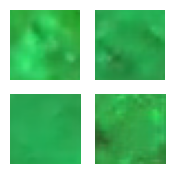

Epoch 530/1000: 100%|██████████| 87/87 [00:04<00:00, 18.18step/s]


Generator Loss: 2.61847186088562, Discriminator Loss: 0.6863318085670471


Epoch 531/1000: 100%|██████████| 87/87 [00:04<00:00, 20.03step/s]

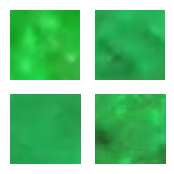

Epoch 531/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]


Generator Loss: 2.727822780609131, Discriminator Loss: 0.523323118686676


Epoch 532/1000: 100%|██████████| 87/87 [00:04<00:00, 19.90step/s]

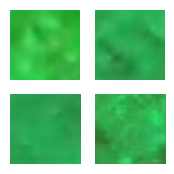

Epoch 532/1000: 100%|██████████| 87/87 [00:04<00:00, 19.19step/s]


Generator Loss: 2.793062210083008, Discriminator Loss: 0.5564708709716797


Epoch 533/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.18step/s]

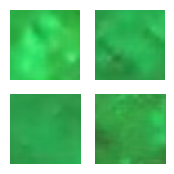

Epoch 533/1000: 100%|██████████| 87/87 [00:04<00:00, 19.00step/s]


Generator Loss: 2.7349929809570312, Discriminator Loss: 0.6053076386451721


Epoch 534/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]

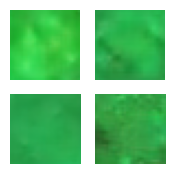

Epoch 534/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 2.7845489978790283, Discriminator Loss: 0.5999035239219666


Epoch 535/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.00step/s]

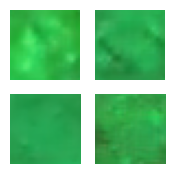

Epoch 535/1000: 100%|██████████| 87/87 [00:04<00:00, 18.41step/s]


Generator Loss: 3.039867639541626, Discriminator Loss: 0.42896392941474915


Epoch 536/1000: 100%|██████████| 87/87 [00:04<00:00, 20.62step/s]

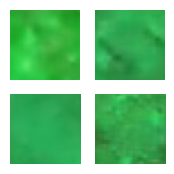

Epoch 536/1000: 100%|██████████| 87/87 [00:04<00:00, 19.19step/s]


Generator Loss: 3.096158027648926, Discriminator Loss: 0.4673665463924408


Epoch 537/1000: 100%|██████████| 87/87 [00:04<00:00, 20.33step/s]

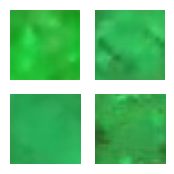

Epoch 537/1000: 100%|██████████| 87/87 [00:04<00:00, 19.41step/s]


Generator Loss: 3.0520331859588623, Discriminator Loss: 0.5238630175590515


Epoch 538/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]

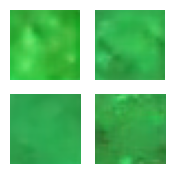

Epoch 538/1000: 100%|██████████| 87/87 [00:04<00:00, 17.97step/s]


Generator Loss: 2.9407360553741455, Discriminator Loss: 0.7522061467170715


Epoch 539/1000: 100%|██████████| 87/87 [00:04<00:00, 20.59step/s]

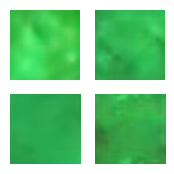

Epoch 539/1000: 100%|██████████| 87/87 [00:04<00:00, 19.19step/s]


Generator Loss: 2.886470317840576, Discriminator Loss: 0.5861820578575134


Epoch 540/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.30step/s]

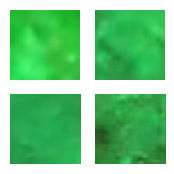

Epoch 540/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 3.0044312477111816, Discriminator Loss: 0.5836876034736633


Epoch 541/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.09step/s]

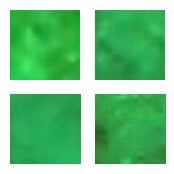

Epoch 541/1000: 100%|██████████| 87/87 [00:04<00:00, 17.52step/s]


Generator Loss: 3.1361472606658936, Discriminator Loss: 0.4225391447544098


Epoch 542/1000: 100%|██████████| 87/87 [00:04<00:00, 18.62step/s]

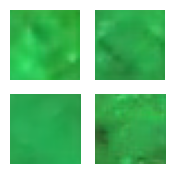

Epoch 542/1000: 100%|██████████| 87/87 [00:04<00:00, 17.58step/s]


Generator Loss: 3.0667083263397217, Discriminator Loss: 0.617285430431366


Epoch 543/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.30step/s]

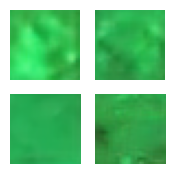

Epoch 543/1000: 100%|██████████| 87/87 [00:04<00:00, 19.04step/s]


Generator Loss: 2.939871311187744, Discriminator Loss: 0.5477701425552368


Epoch 544/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.85step/s]

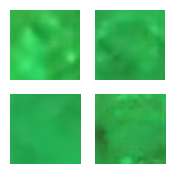

Epoch 544/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 3.0447590351104736, Discriminator Loss: 0.554185152053833


Epoch 545/1000: 100%|██████████| 87/87 [00:04<00:00, 19.84step/s]

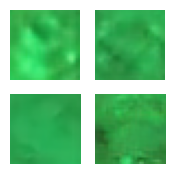

Epoch 545/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 3.0090389251708984, Discriminator Loss: 0.5573070049285889


Epoch 546/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.71step/s]

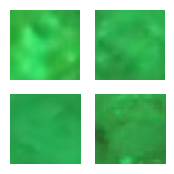

Epoch 546/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 3.058123826980591, Discriminator Loss: 0.5719553828239441


Epoch 547/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]

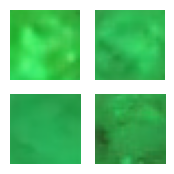

Epoch 547/1000: 100%|██████████| 87/87 [00:04<00:00, 18.02step/s]


Generator Loss: 3.063610315322876, Discriminator Loss: 0.5805094838142395


Epoch 548/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.14step/s]

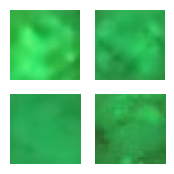

Epoch 548/1000: 100%|██████████| 87/87 [00:04<00:00, 17.57step/s]


Generator Loss: 2.911545753479004, Discriminator Loss: 0.5707733035087585


Epoch 549/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.78step/s]

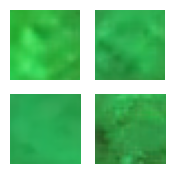

Epoch 549/1000: 100%|██████████| 87/87 [00:04<00:00, 19.75step/s]


Generator Loss: 3.0441806316375732, Discriminator Loss: 0.6010440587997437


Epoch 550/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.34step/s]

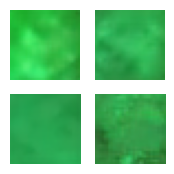

Epoch 550/1000: 100%|██████████| 87/87 [00:04<00:00, 19.14step/s]


Generator Loss: 3.001660108566284, Discriminator Loss: 0.6008761525154114


Epoch 551/1000: 100%|██████████| 87/87 [00:04<00:00, 16.91step/s]

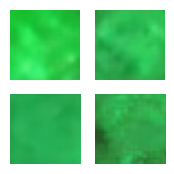

Epoch 551/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]


Generator Loss: 3.1445059776306152, Discriminator Loss: 0.5069320797920227


Epoch 552/1000: 100%|██████████| 87/87 [00:04<00:00, 17.69step/s]

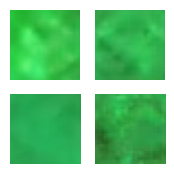

Epoch 552/1000: 100%|██████████| 87/87 [00:04<00:00, 18.10step/s]


Generator Loss: 3.124606132507324, Discriminator Loss: 0.6927123069763184


Epoch 553/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]

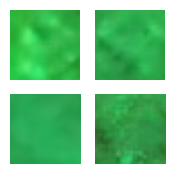

Epoch 553/1000: 100%|██████████| 87/87 [00:04<00:00, 18.70step/s]


Generator Loss: 2.8767895698547363, Discriminator Loss: 0.6057899594306946


Epoch 554/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.88step/s]

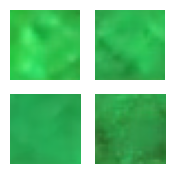

Epoch 554/1000: 100%|██████████| 87/87 [00:04<00:00, 17.49step/s]


Generator Loss: 3.0774574279785156, Discriminator Loss: 0.5751973390579224


Epoch 555/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.50step/s]

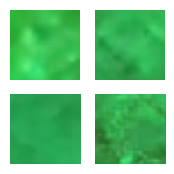

Epoch 555/1000: 100%|██████████| 87/87 [00:05<00:00, 16.90step/s]


Generator Loss: 2.926004409790039, Discriminator Loss: 0.6233436465263367


Epoch 556/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.64step/s]

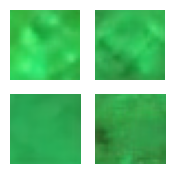

Epoch 556/1000: 100%|██████████| 87/87 [00:05<00:00, 17.35step/s]


Generator Loss: 2.8756794929504395, Discriminator Loss: 0.559598445892334


Epoch 557/1000: 100%|██████████| 87/87 [00:04<00:00, 17.00step/s]

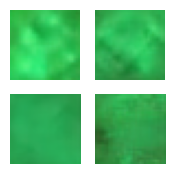

Epoch 557/1000: 100%|██████████| 87/87 [00:04<00:00, 17.55step/s]


Generator Loss: 3.215463876724243, Discriminator Loss: 0.6142381429672241


Epoch 558/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.76step/s]

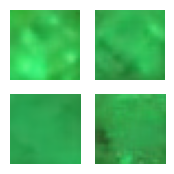

Epoch 558/1000: 100%|██████████| 87/87 [00:05<00:00, 17.27step/s]


Generator Loss: 2.816244125366211, Discriminator Loss: 0.737269937992096


Epoch 559/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]

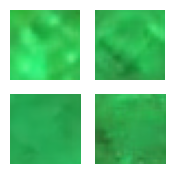

Epoch 559/1000: 100%|██████████| 87/87 [00:04<00:00, 17.93step/s]


Generator Loss: 2.9390227794647217, Discriminator Loss: 0.6043341755867004


Epoch 560/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.46step/s]

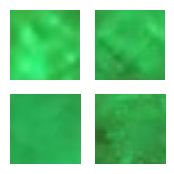

Epoch 560/1000: 100%|██████████| 87/87 [00:04<00:00, 19.24step/s]


Generator Loss: 3.086655616760254, Discriminator Loss: 0.5423310399055481


Epoch 561/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.23step/s]

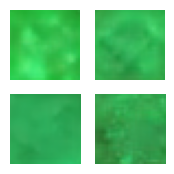

Epoch 561/1000: 100%|██████████| 87/87 [00:04<00:00, 17.60step/s]


Generator Loss: 3.3508496284484863, Discriminator Loss: 0.4148205816745758


Epoch 562/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.02step/s]

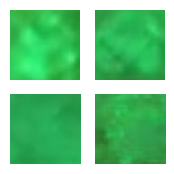

Epoch 562/1000: 100%|██████████| 87/87 [00:04<00:00, 17.81step/s]


Generator Loss: 2.9646198749542236, Discriminator Loss: 0.5104808211326599


Epoch 563/1000: 100%|██████████| 87/87 [00:04<00:00, 18.89step/s]

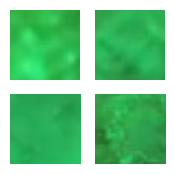

Epoch 563/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]


Generator Loss: 2.904149055480957, Discriminator Loss: 0.5755313634872437


Epoch 564/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.45step/s]

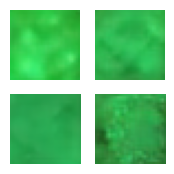

Epoch 564/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]


Generator Loss: 2.817619562149048, Discriminator Loss: 0.6861576437950134


Epoch 565/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.44step/s]

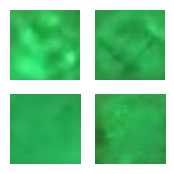

Epoch 565/1000: 100%|██████████| 87/87 [00:04<00:00, 17.66step/s]


Generator Loss: 3.0451018810272217, Discriminator Loss: 0.5021945238113403


Epoch 566/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.68step/s]

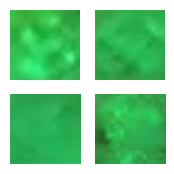

Epoch 566/1000: 100%|██████████| 87/87 [00:05<00:00, 15.17step/s]


Generator Loss: 3.067166805267334, Discriminator Loss: 0.5376065373420715


Epoch 567/1000: 100%|██████████| 87/87 [00:05<00:00, 15.62step/s]

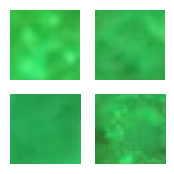

Epoch 567/1000: 100%|██████████| 87/87 [00:05<00:00, 15.50step/s]


Generator Loss: 3.257193088531494, Discriminator Loss: 0.4660228490829468


Epoch 568/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.92step/s]

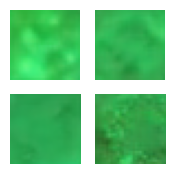

Epoch 568/1000: 100%|██████████| 87/87 [00:05<00:00, 15.36step/s]


Generator Loss: 3.2710156440734863, Discriminator Loss: 0.5603428483009338


Epoch 569/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.38step/s]

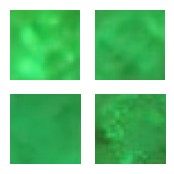

Epoch 569/1000: 100%|██████████| 87/87 [00:05<00:00, 15.64step/s]


Generator Loss: 3.4024620056152344, Discriminator Loss: 0.5306052565574646


Epoch 570/1000:  98%|█████████▊| 85/87 [00:05<00:00, 15.93step/s]

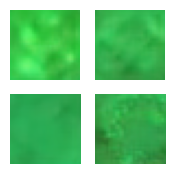

Epoch 570/1000: 100%|██████████| 87/87 [00:05<00:00, 15.83step/s]


Generator Loss: 2.9112861156463623, Discriminator Loss: 0.521539032459259


Epoch 571/1000: 100%|██████████| 87/87 [00:05<00:00, 14.97step/s]

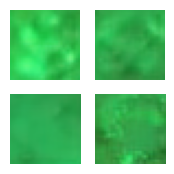

Epoch 571/1000: 100%|██████████| 87/87 [00:05<00:00, 14.98step/s]


Generator Loss: 3.0882649421691895, Discriminator Loss: 0.50741046667099


Epoch 572/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.90step/s]

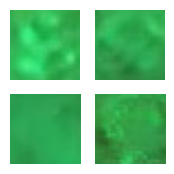

Epoch 572/1000: 100%|██████████| 87/87 [00:05<00:00, 14.58step/s]


Generator Loss: 3.0557029247283936, Discriminator Loss: 0.5743659734725952


Epoch 573/1000: 100%|██████████| 87/87 [00:05<00:00, 14.95step/s]

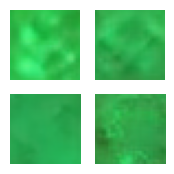

Epoch 573/1000: 100%|██████████| 87/87 [00:05<00:00, 15.75step/s]


Generator Loss: 2.993988275527954, Discriminator Loss: 0.5038902163505554


Epoch 574/1000: 100%|██████████| 87/87 [00:05<00:00, 15.48step/s]

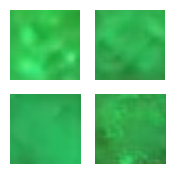

Epoch 574/1000: 100%|██████████| 87/87 [00:05<00:00, 15.00step/s]


Generator Loss: 2.9700355529785156, Discriminator Loss: 0.7416000962257385


Epoch 575/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.90step/s]

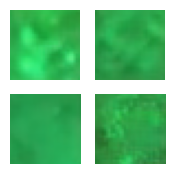

Epoch 575/1000: 100%|██████████| 87/87 [00:05<00:00, 15.09step/s]


Generator Loss: 3.0565924644470215, Discriminator Loss: 0.5291979908943176


Epoch 576/1000: 100%|██████████| 87/87 [00:05<00:00, 19.46step/s]

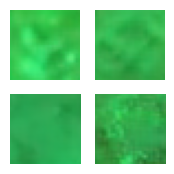

Epoch 576/1000: 100%|██████████| 87/87 [00:05<00:00, 16.27step/s]


Generator Loss: 3.005584478378296, Discriminator Loss: 0.6461479067802429


Epoch 577/1000: 100%|██████████| 87/87 [00:04<00:00, 19.28step/s]

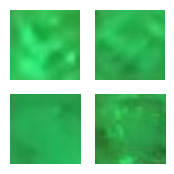

Epoch 577/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 3.3440499305725098, Discriminator Loss: 0.46146902441978455


Epoch 578/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]

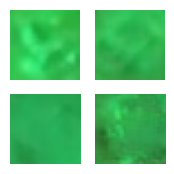

Epoch 578/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 3.128997564315796, Discriminator Loss: 0.5087538361549377


Epoch 579/1000: 100%|██████████| 87/87 [00:04<00:00, 21.12step/s]

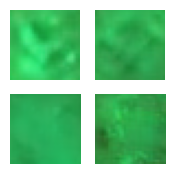

Epoch 579/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 3.1739792823791504, Discriminator Loss: 0.634361982345581


Epoch 580/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.79step/s]

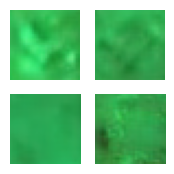

Epoch 580/1000: 100%|██████████| 87/87 [00:04<00:00, 19.17step/s]


Generator Loss: 3.0534422397613525, Discriminator Loss: 0.5907407999038696


Epoch 581/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.12step/s]

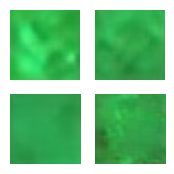

Epoch 581/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]


Generator Loss: 2.8770904541015625, Discriminator Loss: 0.5810009837150574


Epoch 582/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.74step/s]

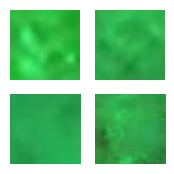

Epoch 582/1000: 100%|██████████| 87/87 [00:04<00:00, 19.30step/s]


Generator Loss: 3.261216163635254, Discriminator Loss: 0.5251870155334473


Epoch 583/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.27step/s]

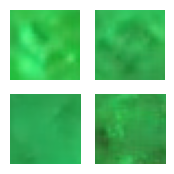

Epoch 583/1000: 100%|██████████| 87/87 [00:04<00:00, 19.62step/s]


Generator Loss: 2.9924368858337402, Discriminator Loss: 0.554332435131073


Epoch 584/1000: 100%|██████████| 87/87 [00:04<00:00, 19.89step/s]

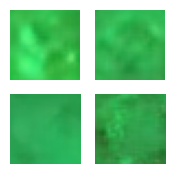

Epoch 584/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]


Generator Loss: 3.1039347648620605, Discriminator Loss: 0.41981345415115356


Epoch 585/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.04step/s]

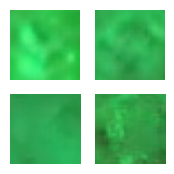

Epoch 585/1000: 100%|██████████| 87/87 [00:04<00:00, 19.43step/s]


Generator Loss: 3.2548046112060547, Discriminator Loss: 0.5839300155639648


Epoch 586/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.04step/s]

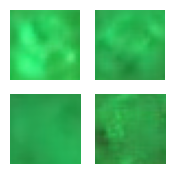

Epoch 586/1000: 100%|██████████| 87/87 [00:04<00:00, 17.91step/s]


Generator Loss: 2.90787672996521, Discriminator Loss: 0.6633075475692749


Epoch 587/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.27step/s]

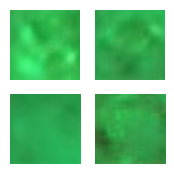

Epoch 587/1000: 100%|██████████| 87/87 [00:04<00:00, 19.11step/s]


Generator Loss: 3.364358425140381, Discriminator Loss: 0.4205997586250305


Epoch 588/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.65step/s]

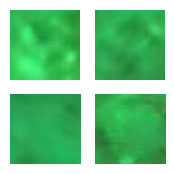

Epoch 588/1000: 100%|██████████| 87/87 [00:04<00:00, 19.65step/s]


Generator Loss: 3.3879036903381348, Discriminator Loss: 0.36532506346702576


Epoch 589/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.69step/s]

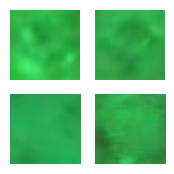

Epoch 589/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 3.190093755722046, Discriminator Loss: 0.523215651512146


Epoch 590/1000: 100%|██████████| 87/87 [00:04<00:00, 19.94step/s]

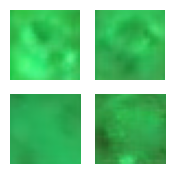

Epoch 590/1000: 100%|██████████| 87/87 [00:04<00:00, 17.97step/s]


Generator Loss: 2.9753572940826416, Discriminator Loss: 0.6290186643600464


Epoch 591/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.78step/s]

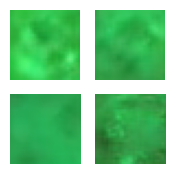

Epoch 591/1000: 100%|██████████| 87/87 [00:04<00:00, 19.66step/s]


Generator Loss: 3.311856269836426, Discriminator Loss: 0.5580844879150391


Epoch 592/1000: 100%|██████████| 87/87 [00:04<00:00, 21.35step/s]

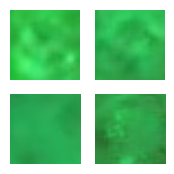

Epoch 592/1000: 100%|██████████| 87/87 [00:04<00:00, 18.85step/s]


Generator Loss: 2.9960150718688965, Discriminator Loss: 0.5220555067062378


Epoch 593/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.20step/s]

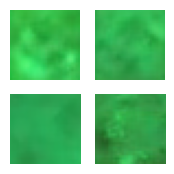

Epoch 593/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 3.0364038944244385, Discriminator Loss: 0.4915969669818878


Epoch 594/1000: 100%|██████████| 87/87 [00:04<00:00, 20.96step/s]

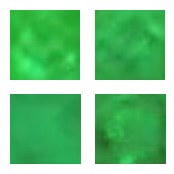

Epoch 594/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 3.1119041442871094, Discriminator Loss: 0.5102332830429077


Epoch 595/1000: 100%|██████████| 87/87 [00:04<00:00, 20.45step/s]

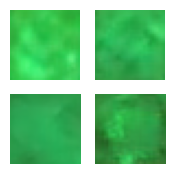

Epoch 595/1000: 100%|██████████| 87/87 [00:04<00:00, 18.72step/s]


Generator Loss: 3.2362594604492188, Discriminator Loss: 0.4038754999637604


Epoch 596/1000: 100%|██████████| 87/87 [00:04<00:00, 19.98step/s]

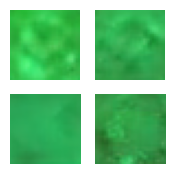

Epoch 596/1000: 100%|██████████| 87/87 [00:04<00:00, 18.22step/s]


Generator Loss: 3.4624156951904297, Discriminator Loss: 0.36642131209373474


Epoch 597/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.10step/s]

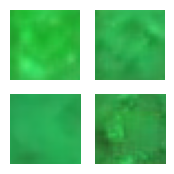

Epoch 597/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 3.4215986728668213, Discriminator Loss: 0.5845220685005188


Epoch 598/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.56step/s]

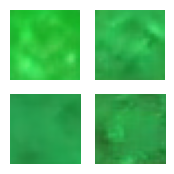

Epoch 598/1000: 100%|██████████| 87/87 [00:04<00:00, 18.73step/s]


Generator Loss: 3.036923408508301, Discriminator Loss: 0.5080476999282837


Epoch 599/1000: 100%|██████████| 87/87 [00:05<00:00, 17.11step/s]

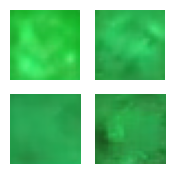

Epoch 599/1000: 100%|██████████| 87/87 [00:05<00:00, 16.70step/s]


Generator Loss: 3.5855050086975098, Discriminator Loss: 0.39882969856262207


Epoch 600/1000:  98%|█████████▊| 85/87 [00:05<00:00, 15.87step/s]

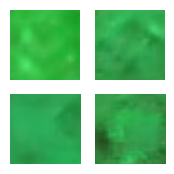

Epoch 600/1000: 100%|██████████| 87/87 [00:05<00:00, 16.26step/s]


Generator Loss: 3.3293890953063965, Discriminator Loss: 0.5157509446144104


Epoch 601/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.06step/s]

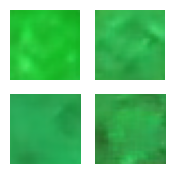

Epoch 601/1000: 100%|██████████| 87/87 [00:05<00:00, 16.91step/s]


Generator Loss: 2.9748682975769043, Discriminator Loss: 0.7112817764282227


Epoch 602/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.33step/s]

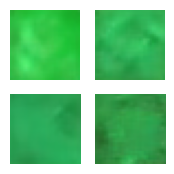

Epoch 602/1000: 100%|██████████| 87/87 [00:05<00:00, 17.26step/s]


Generator Loss: 3.1687281131744385, Discriminator Loss: 0.42837244272232056


Epoch 603/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.84step/s]

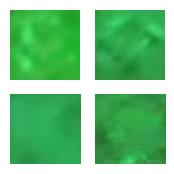

Epoch 603/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 3.420016288757324, Discriminator Loss: 0.5430135130882263


Epoch 604/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.12step/s]

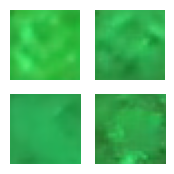

Epoch 604/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 2.9567980766296387, Discriminator Loss: 0.5836829543113708


Epoch 605/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.86step/s]

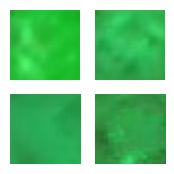

Epoch 605/1000: 100%|██████████| 87/87 [00:04<00:00, 17.89step/s]


Generator Loss: 3.2045323848724365, Discriminator Loss: 0.5710479617118835


Epoch 606/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.68step/s]

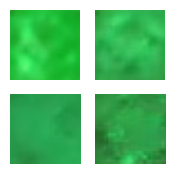

Epoch 606/1000: 100%|██████████| 87/87 [00:05<00:00, 17.08step/s]


Generator Loss: 3.166714668273926, Discriminator Loss: 0.4229680597782135


Epoch 607/1000: 100%|██████████| 87/87 [00:04<00:00, 18.26step/s]

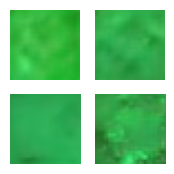

Epoch 607/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]


Generator Loss: 3.223557710647583, Discriminator Loss: 0.5186297297477722


Epoch 608/1000: 100%|██████████| 87/87 [00:04<00:00, 19.76step/s]

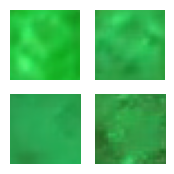

Epoch 608/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]


Generator Loss: 3.1128406524658203, Discriminator Loss: 0.5944438576698303


Epoch 609/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.99step/s]

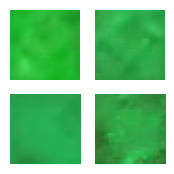

Epoch 609/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 2.980428695678711, Discriminator Loss: 0.6936579346656799


Epoch 610/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.61step/s]

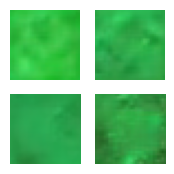

Epoch 610/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]


Generator Loss: 3.3023264408111572, Discriminator Loss: 0.4943840503692627


Epoch 611/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.23step/s]

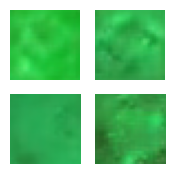

Epoch 611/1000: 100%|██████████| 87/87 [00:04<00:00, 19.35step/s]


Generator Loss: 3.4153079986572266, Discriminator Loss: 0.688932478427887


Epoch 612/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.30step/s]

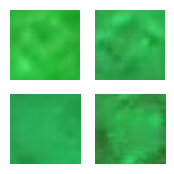

Epoch 612/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 3.0481085777282715, Discriminator Loss: 0.5415025949478149


Epoch 613/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.61step/s]

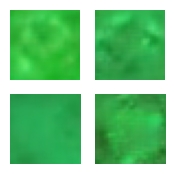

Epoch 613/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]


Generator Loss: 3.196371078491211, Discriminator Loss: 0.5489145517349243


Epoch 614/1000: 100%|██████████| 87/87 [00:05<00:00, 16.15step/s]

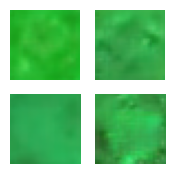

Epoch 614/1000: 100%|██████████| 87/87 [00:05<00:00, 16.43step/s]


Generator Loss: 3.195538282394409, Discriminator Loss: 0.4388282299041748


Epoch 615/1000: 100%|██████████| 87/87 [00:05<00:00, 16.80step/s]

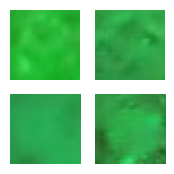

Epoch 615/1000: 100%|██████████| 87/87 [00:05<00:00, 15.59step/s]


Generator Loss: 3.4284372329711914, Discriminator Loss: 0.47112247347831726


Epoch 616/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.76step/s]

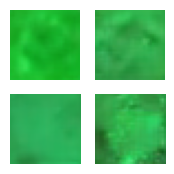

Epoch 616/1000: 100%|██████████| 87/87 [00:05<00:00, 15.90step/s]


Generator Loss: 3.263869047164917, Discriminator Loss: 0.5565391182899475


Epoch 617/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.70step/s]

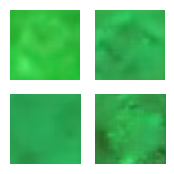

Epoch 617/1000: 100%|██████████| 87/87 [00:05<00:00, 15.24step/s]


Generator Loss: 3.4095914363861084, Discriminator Loss: 0.49533945322036743


Epoch 618/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.90step/s]

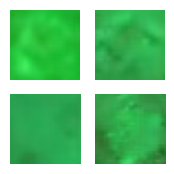

Epoch 618/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 3.3109688758850098, Discriminator Loss: 0.4862450361251831


Epoch 619/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.17step/s]

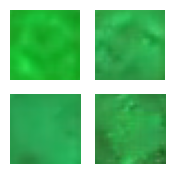

Epoch 619/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 3.527056932449341, Discriminator Loss: 0.31129351258277893


Epoch 620/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.82step/s]

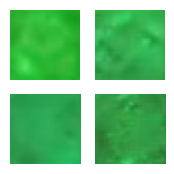

Epoch 620/1000: 100%|██████████| 87/87 [00:05<00:00, 14.70step/s]


Generator Loss: 3.3421266078948975, Discriminator Loss: 0.3717430830001831


Epoch 621/1000: 100%|██████████| 87/87 [00:05<00:00, 14.74step/s]

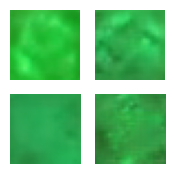

Epoch 621/1000: 100%|██████████| 87/87 [00:05<00:00, 14.92step/s]


Generator Loss: 3.1860148906707764, Discriminator Loss: 0.57440185546875


Epoch 622/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.20step/s]

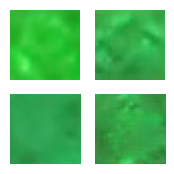

Epoch 622/1000: 100%|██████████| 87/87 [00:05<00:00, 14.65step/s]


Generator Loss: 3.4340710639953613, Discriminator Loss: 0.47138866782188416


Epoch 623/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.92step/s]

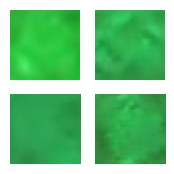

Epoch 623/1000: 100%|██████████| 87/87 [00:05<00:00, 15.01step/s]


Generator Loss: 3.3811028003692627, Discriminator Loss: 0.440761923789978


Epoch 624/1000:  99%|█████████▉| 86/87 [00:05<00:00, 19.76step/s]

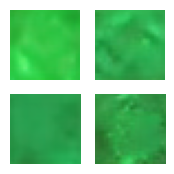

Epoch 624/1000: 100%|██████████| 87/87 [00:05<00:00, 15.39step/s]


Generator Loss: 3.469433307647705, Discriminator Loss: 0.5032832026481628


Epoch 625/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.88step/s]

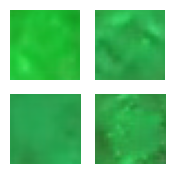

Epoch 625/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 3.0970301628112793, Discriminator Loss: 0.6271615028381348


Epoch 626/1000: 100%|██████████| 87/87 [00:04<00:00, 20.45step/s]

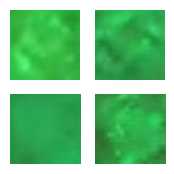

Epoch 626/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 3.0999739170074463, Discriminator Loss: 0.4938705265522003


Epoch 627/1000: 100%|██████████| 87/87 [00:04<00:00, 19.44step/s]

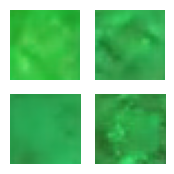

Epoch 627/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]


Generator Loss: 3.2418792247772217, Discriminator Loss: 0.4511025846004486


Epoch 628/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.23step/s]

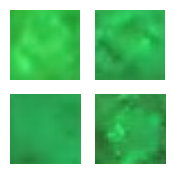

Epoch 628/1000: 100%|██████████| 87/87 [00:04<00:00, 18.98step/s]


Generator Loss: 3.350020170211792, Discriminator Loss: 0.4312392473220825


Epoch 629/1000: 100%|██████████| 87/87 [00:04<00:00, 20.38step/s]

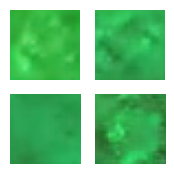

Epoch 629/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 3.3837897777557373, Discriminator Loss: 0.5438328385353088


Epoch 630/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.98step/s]

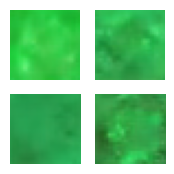

Epoch 630/1000: 100%|██████████| 87/87 [00:04<00:00, 18.89step/s]


Generator Loss: 3.359804630279541, Discriminator Loss: 0.3706204295158386


Epoch 631/1000: 100%|██████████| 87/87 [00:04<00:00, 19.37step/s]

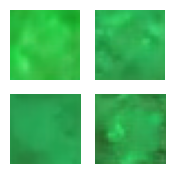

Epoch 631/1000: 100%|██████████| 87/87 [00:04<00:00, 18.74step/s]


Generator Loss: 3.6010496616363525, Discriminator Loss: 0.47503381967544556


Epoch 632/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.87step/s]

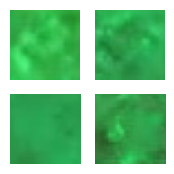

Epoch 632/1000: 100%|██████████| 87/87 [00:04<00:00, 19.43step/s]


Generator Loss: 3.165811538696289, Discriminator Loss: 0.6212610006332397


Epoch 633/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.02step/s]

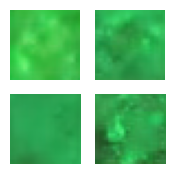

Epoch 633/1000: 100%|██████████| 87/87 [00:04<00:00, 18.57step/s]


Generator Loss: 3.352445363998413, Discriminator Loss: 0.45102840662002563


Epoch 634/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.90step/s]

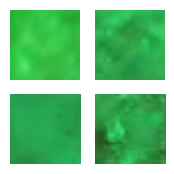

Epoch 634/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 3.2360007762908936, Discriminator Loss: 0.43492740392684937


Epoch 635/1000: 100%|██████████| 87/87 [00:04<00:00, 19.48step/s]

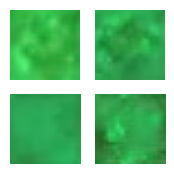

Epoch 635/1000: 100%|██████████| 87/87 [00:04<00:00, 18.91step/s]


Generator Loss: 3.4548943042755127, Discriminator Loss: 0.4542233347892761


Epoch 636/1000: 100%|██████████| 87/87 [00:04<00:00, 19.77step/s]

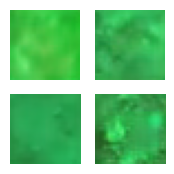

Epoch 636/1000: 100%|██████████| 87/87 [00:04<00:00, 18.70step/s]


Generator Loss: 3.3163585662841797, Discriminator Loss: 0.6520332098007202


Epoch 637/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.96step/s]

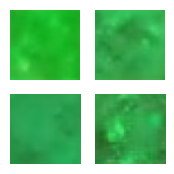

Epoch 637/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 3.4561073780059814, Discriminator Loss: 0.4175756573677063


Epoch 638/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.84step/s]

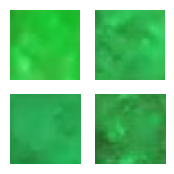

Epoch 638/1000: 100%|██████████| 87/87 [00:04<00:00, 18.14step/s]


Generator Loss: 3.4497897624969482, Discriminator Loss: 0.5310832262039185


Epoch 639/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.68step/s]

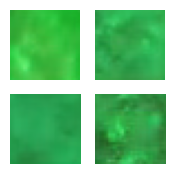

Epoch 639/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 3.2739367485046387, Discriminator Loss: 0.4742780327796936


Epoch 640/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]

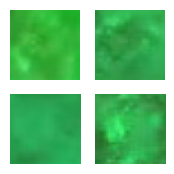

Epoch 640/1000: 100%|██████████| 87/87 [00:04<00:00, 18.48step/s]


Generator Loss: 3.3473689556121826, Discriminator Loss: 0.517114520072937


Epoch 641/1000: 100%|██████████| 87/87 [00:04<00:00, 19.84step/s]

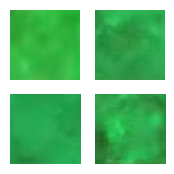

Epoch 641/1000: 100%|██████████| 87/87 [00:04<00:00, 17.96step/s]


Generator Loss: 3.577216386795044, Discriminator Loss: 0.36017099022865295


Epoch 642/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.20step/s]

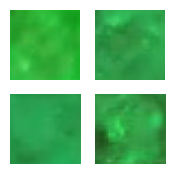

Epoch 642/1000: 100%|██████████| 87/87 [00:04<00:00, 19.45step/s]


Generator Loss: 3.774486780166626, Discriminator Loss: 0.4064123332500458


Epoch 643/1000: 100%|██████████| 87/87 [00:04<00:00, 19.30step/s]

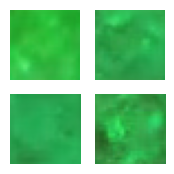

Epoch 643/1000: 100%|██████████| 87/87 [00:04<00:00, 19.35step/s]


Generator Loss: 3.2729337215423584, Discriminator Loss: 0.521868884563446


Epoch 644/1000:  98%|█████████▊| 85/87 [00:04<00:00, 16.86step/s]

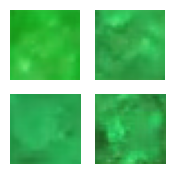

Epoch 644/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 3.545722007751465, Discriminator Loss: 0.445502370595932


Epoch 645/1000: 100%|██████████| 87/87 [00:04<00:00, 19.48step/s]

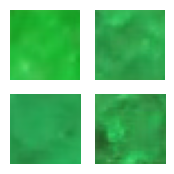

Epoch 645/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 3.212956666946411, Discriminator Loss: 0.564254879951477


Epoch 646/1000: 100%|██████████| 87/87 [00:04<00:00, 18.14step/s]

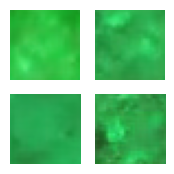

Epoch 646/1000: 100%|██████████| 87/87 [00:04<00:00, 17.68step/s]


Generator Loss: 3.6825308799743652, Discriminator Loss: 0.46789786219596863


Epoch 647/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.69step/s]

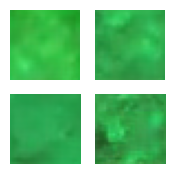

Epoch 647/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 3.2994065284729004, Discriminator Loss: 0.5807005167007446


Epoch 648/1000: 100%|██████████| 87/87 [00:04<00:00, 16.47step/s]

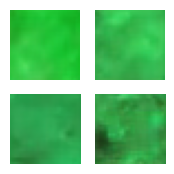

Epoch 648/1000: 100%|██████████| 87/87 [00:04<00:00, 18.10step/s]


Generator Loss: 3.5258498191833496, Discriminator Loss: 0.457427054643631


Epoch 649/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.01step/s]

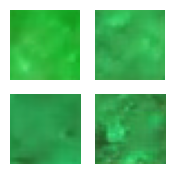

Epoch 649/1000: 100%|██████████| 87/87 [00:04<00:00, 19.79step/s]


Generator Loss: 3.4823169708251953, Discriminator Loss: 0.41616737842559814


Epoch 650/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.83step/s]

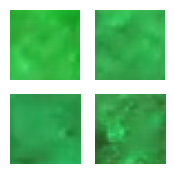

Epoch 650/1000: 100%|██████████| 87/87 [00:05<00:00, 17.34step/s]


Generator Loss: 3.0462794303894043, Discriminator Loss: 0.6044756770133972


Epoch 651/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.51step/s]

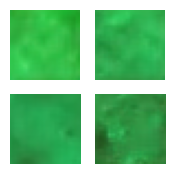

Epoch 651/1000: 100%|██████████| 87/87 [00:04<00:00, 17.73step/s]


Generator Loss: 3.204493999481201, Discriminator Loss: 0.6259461045265198


Epoch 652/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.52step/s]

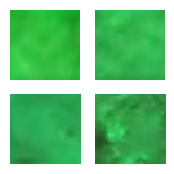

Epoch 652/1000: 100%|██████████| 87/87 [00:05<00:00, 17.30step/s]


Generator Loss: 3.2805161476135254, Discriminator Loss: 0.5444590449333191


Epoch 653/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.29step/s]

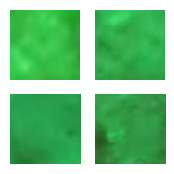

Epoch 653/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 3.351971387863159, Discriminator Loss: 0.4475761353969574


Epoch 654/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.79step/s]

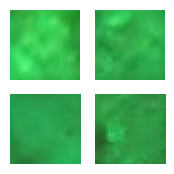

Epoch 654/1000: 100%|██████████| 87/87 [00:04<00:00, 18.03step/s]


Generator Loss: 3.418606758117676, Discriminator Loss: 0.49356311559677124


Epoch 655/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.22step/s]

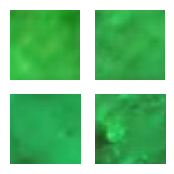

Epoch 655/1000: 100%|██████████| 87/87 [00:04<00:00, 17.49step/s]


Generator Loss: 3.171694755554199, Discriminator Loss: 0.5076407790184021


Epoch 656/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.50step/s]

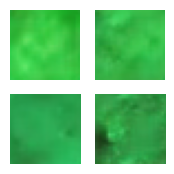

Epoch 656/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 3.3578484058380127, Discriminator Loss: 0.5574896335601807


Epoch 657/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.70step/s]

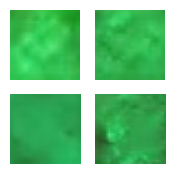

Epoch 657/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]


Generator Loss: 3.3553266525268555, Discriminator Loss: 0.46639829874038696


Epoch 658/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.58step/s]

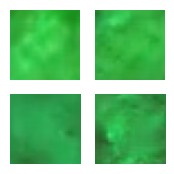

Epoch 658/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 3.5206499099731445, Discriminator Loss: 0.38709303736686707


Epoch 659/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]

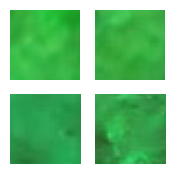

Epoch 659/1000: 100%|██████████| 87/87 [00:04<00:00, 18.81step/s]


Generator Loss: 3.281313180923462, Discriminator Loss: 0.4855429232120514


Epoch 660/1000: 100%|██████████| 87/87 [00:04<00:00, 18.39step/s]

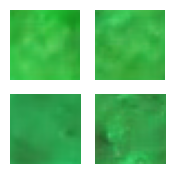

Epoch 660/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 3.6005985736846924, Discriminator Loss: 0.5120614767074585


Epoch 661/1000: 100%|██████████| 87/87 [00:04<00:00, 20.02step/s]

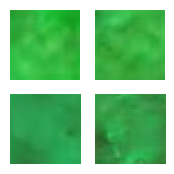

Epoch 661/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 3.260511636734009, Discriminator Loss: 0.4742848575115204


Epoch 662/1000: 100%|██████████| 87/87 [00:04<00:00, 16.45step/s]

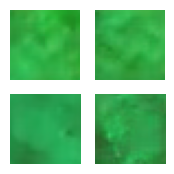

Epoch 662/1000: 100%|██████████| 87/87 [00:04<00:00, 17.60step/s]


Generator Loss: 3.504979372024536, Discriminator Loss: 0.4744683504104614


Epoch 663/1000: 100%|██████████| 87/87 [00:05<00:00, 17.59step/s]

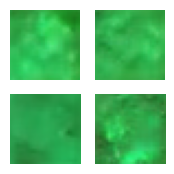

Epoch 663/1000: 100%|██████████| 87/87 [00:05<00:00, 15.57step/s]


Generator Loss: 3.276157855987549, Discriminator Loss: 0.44566407799720764


Epoch 664/1000:  99%|█████████▉| 86/87 [00:05<00:00, 18.01step/s]

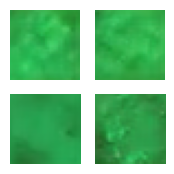

Epoch 664/1000: 100%|██████████| 87/87 [00:05<00:00, 15.39step/s]


Generator Loss: 3.4928970336914062, Discriminator Loss: 0.3834139406681061


Epoch 665/1000: 100%|██████████| 87/87 [00:05<00:00, 15.20step/s]

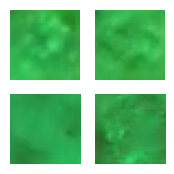

Epoch 665/1000: 100%|██████████| 87/87 [00:05<00:00, 15.27step/s]


Generator Loss: 3.7053418159484863, Discriminator Loss: 0.4238320291042328


Epoch 666/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.94step/s]

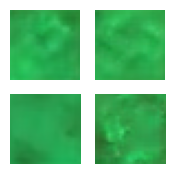

Epoch 666/1000: 100%|██████████| 87/87 [00:05<00:00, 15.56step/s]


Generator Loss: 3.515073299407959, Discriminator Loss: 0.5534498691558838


Epoch 667/1000: 100%|██████████| 87/87 [00:05<00:00, 18.03step/s]

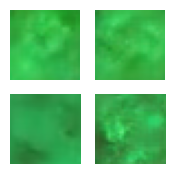

Epoch 667/1000: 100%|██████████| 87/87 [00:05<00:00, 15.53step/s]


Generator Loss: 3.6231391429901123, Discriminator Loss: 0.3854016363620758


Epoch 668/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.71step/s]

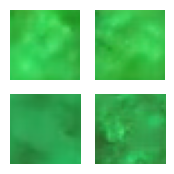

Epoch 668/1000: 100%|██████████| 87/87 [00:05<00:00, 14.55step/s]


Generator Loss: 3.6125905513763428, Discriminator Loss: 0.4208518862724304


Epoch 669/1000: 100%|██████████| 87/87 [00:05<00:00, 15.06step/s]

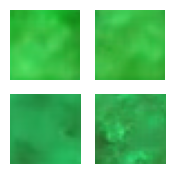

Epoch 669/1000: 100%|██████████| 87/87 [00:05<00:00, 15.19step/s]


Generator Loss: 3.4910850524902344, Discriminator Loss: 0.43314120173454285


Epoch 670/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.12step/s]

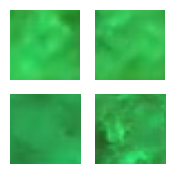

Epoch 670/1000: 100%|██████████| 87/87 [00:05<00:00, 15.52step/s]


Generator Loss: 3.529005289077759, Discriminator Loss: 0.4723343551158905


Epoch 671/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.28step/s]

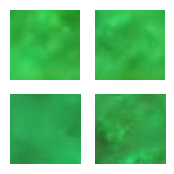

Epoch 671/1000: 100%|██████████| 87/87 [00:05<00:00, 14.77step/s]


Generator Loss: 3.526041030883789, Discriminator Loss: 0.48114433884620667


Epoch 672/1000: 100%|██████████| 87/87 [00:05<00:00, 17.04step/s]

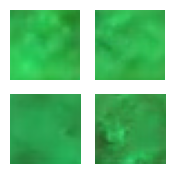

Epoch 672/1000: 100%|██████████| 87/87 [00:05<00:00, 14.96step/s]


Generator Loss: 3.7899012565612793, Discriminator Loss: 0.4386276304721832


Epoch 673/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.48step/s]

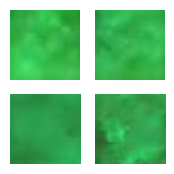

Epoch 673/1000: 100%|██████████| 87/87 [00:04<00:00, 17.69step/s]


Generator Loss: 3.7011165618896484, Discriminator Loss: 0.586726725101471


Epoch 674/1000: 100%|██████████| 87/87 [00:04<00:00, 20.47step/s]

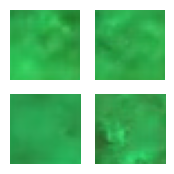

Epoch 674/1000: 100%|██████████| 87/87 [00:04<00:00, 18.01step/s]


Generator Loss: 3.5130436420440674, Discriminator Loss: 0.5408064723014832


Epoch 675/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.11step/s]

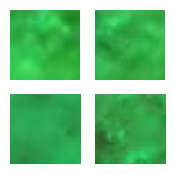

Epoch 675/1000: 100%|██████████| 87/87 [00:04<00:00, 19.09step/s]


Generator Loss: 3.502396821975708, Discriminator Loss: 0.44449299573898315


Epoch 676/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.42step/s]

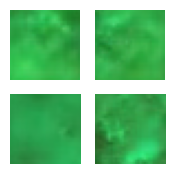

Epoch 676/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 3.231666326522827, Discriminator Loss: 0.4635114073753357


Epoch 677/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.36step/s]

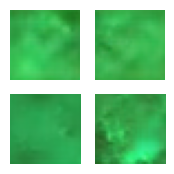

Epoch 677/1000: 100%|██████████| 87/87 [00:04<00:00, 19.51step/s]


Generator Loss: 3.642925977706909, Discriminator Loss: 0.47147926688194275


Epoch 678/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]

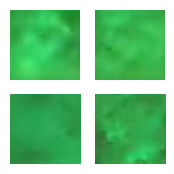

Epoch 678/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 3.5380287170410156, Discriminator Loss: 0.41828781366348267


Epoch 679/1000: 100%|██████████| 87/87 [00:04<00:00, 20.68step/s]

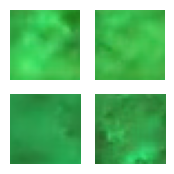

Epoch 679/1000: 100%|██████████| 87/87 [00:04<00:00, 18.91step/s]


Generator Loss: 3.657755136489868, Discriminator Loss: 0.35328570008277893


Epoch 680/1000: 100%|██████████| 87/87 [00:04<00:00, 16.72step/s]

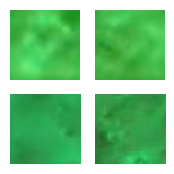

Epoch 680/1000: 100%|██████████| 87/87 [00:04<00:00, 18.20step/s]


Generator Loss: 3.601942300796509, Discriminator Loss: 0.5557172894477844


Epoch 681/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.76step/s]

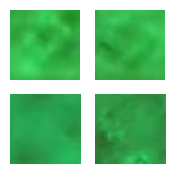

Epoch 681/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]


Generator Loss: 3.4416005611419678, Discriminator Loss: 0.39679765701293945


Epoch 682/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.06step/s]

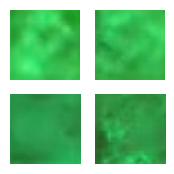

Epoch 682/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 3.9111359119415283, Discriminator Loss: 0.3550974428653717


Epoch 683/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.21step/s]

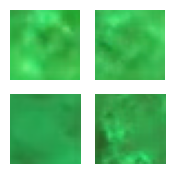

Epoch 683/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]


Generator Loss: 3.7638118267059326, Discriminator Loss: 0.415961354970932


Epoch 684/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.86step/s]

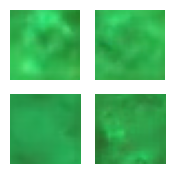

Epoch 684/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]


Generator Loss: 3.625339984893799, Discriminator Loss: 0.3736806809902191


Epoch 685/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.32step/s]

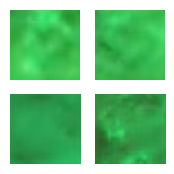

Epoch 685/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 3.6679210662841797, Discriminator Loss: 0.44347456097602844


Epoch 686/1000: 100%|██████████| 87/87 [00:04<00:00, 19.72step/s]

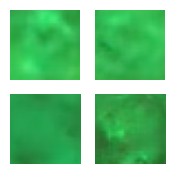

Epoch 686/1000: 100%|██████████| 87/87 [00:04<00:00, 17.83step/s]


Generator Loss: 3.242382287979126, Discriminator Loss: 0.7801565527915955


Epoch 687/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.44step/s]

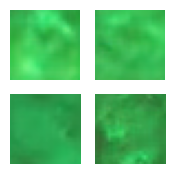

Epoch 687/1000: 100%|██████████| 87/87 [00:04<00:00, 18.52step/s]


Generator Loss: 3.4773001670837402, Discriminator Loss: 0.5320428013801575


Epoch 688/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]

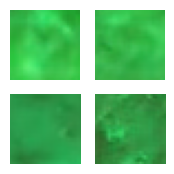

Epoch 688/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 3.4799797534942627, Discriminator Loss: 0.4725431203842163


Epoch 689/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.68step/s]

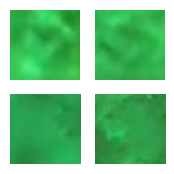

Epoch 689/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 3.437899112701416, Discriminator Loss: 0.46317535638809204


Epoch 690/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.89step/s]

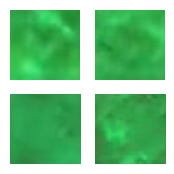

Epoch 690/1000: 100%|██████████| 87/87 [00:04<00:00, 19.40step/s]


Generator Loss: 3.8627004623413086, Discriminator Loss: 0.5294245481491089


Epoch 691/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.14step/s]

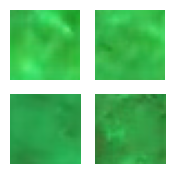

Epoch 691/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 3.451364755630493, Discriminator Loss: 0.502822756767273


Epoch 692/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.03step/s]

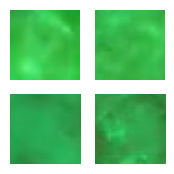

Epoch 692/1000: 100%|██████████| 87/87 [00:04<00:00, 18.10step/s]


Generator Loss: 3.622206687927246, Discriminator Loss: 0.36909985542297363


Epoch 693/1000: 100%|██████████| 87/87 [00:04<00:00, 20.91step/s]

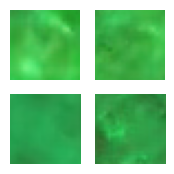

Epoch 693/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]


Generator Loss: 3.544952630996704, Discriminator Loss: 0.5967761874198914


Epoch 694/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.65step/s]

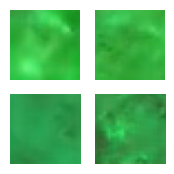

Epoch 694/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 3.5119876861572266, Discriminator Loss: 0.43680888414382935


Epoch 695/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.21step/s]

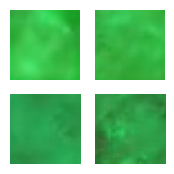

Epoch 695/1000: 100%|██████████| 87/87 [00:04<00:00, 19.21step/s]


Generator Loss: 3.779672145843506, Discriminator Loss: 0.6286948919296265


Epoch 696/1000: 100%|██████████| 87/87 [00:04<00:00, 17.64step/s]

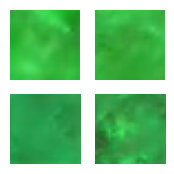

Epoch 696/1000: 100%|██████████| 87/87 [00:04<00:00, 19.06step/s]


Generator Loss: 3.4750380516052246, Discriminator Loss: 0.4509701430797577


Epoch 697/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.93step/s]

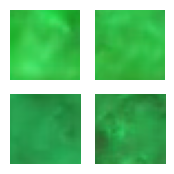

Epoch 697/1000: 100%|██████████| 87/87 [00:04<00:00, 18.60step/s]


Generator Loss: 3.446105718612671, Discriminator Loss: 0.41101568937301636


Epoch 698/1000: 100%|██████████| 87/87 [00:04<00:00, 18.30step/s]

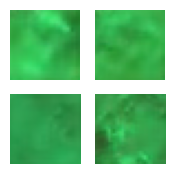

Epoch 698/1000: 100%|██████████| 87/87 [00:04<00:00, 17.79step/s]


Generator Loss: 3.6110734939575195, Discriminator Loss: 0.3690464496612549


Epoch 699/1000: 100%|██████████| 87/87 [00:04<00:00, 18.19step/s]

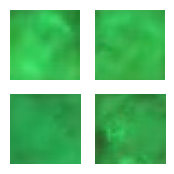

Epoch 699/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]


Generator Loss: 3.678987741470337, Discriminator Loss: 0.4057156443595886


Epoch 700/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.08step/s]

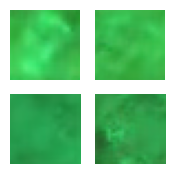

Epoch 700/1000: 100%|██████████| 87/87 [00:04<00:00, 17.68step/s]


Generator Loss: 3.7203845977783203, Discriminator Loss: 0.41398462653160095


Epoch 701/1000: 100%|██████████| 87/87 [00:04<00:00, 17.96step/s]

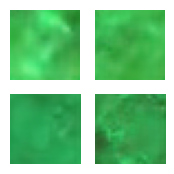

Epoch 701/1000: 100%|██████████| 87/87 [00:04<00:00, 17.51step/s]


Generator Loss: 3.597451686859131, Discriminator Loss: 0.3531917929649353


Epoch 702/1000: 100%|██████████| 87/87 [00:04<00:00, 18.14step/s]

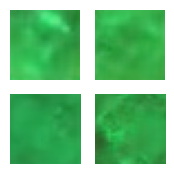

Epoch 702/1000: 100%|██████████| 87/87 [00:04<00:00, 17.60step/s]


Generator Loss: 3.588975667953491, Discriminator Loss: 0.43801042437553406


Epoch 703/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]

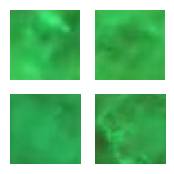

Epoch 703/1000: 100%|██████████| 87/87 [00:04<00:00, 17.98step/s]


Generator Loss: 3.6292366981506348, Discriminator Loss: 0.4548831880092621


Epoch 704/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.44step/s]

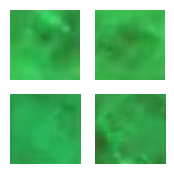

Epoch 704/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 3.7531328201293945, Discriminator Loss: 0.37926360964775085


Epoch 705/1000: 100%|██████████| 87/87 [00:04<00:00, 20.61step/s]

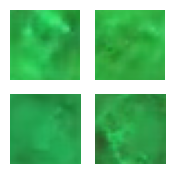

Epoch 705/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 3.480185031890869, Discriminator Loss: 0.4635910093784332


Epoch 706/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.70step/s]

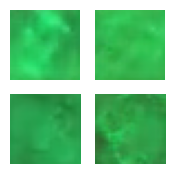

Epoch 706/1000: 100%|██████████| 87/87 [00:04<00:00, 18.50step/s]


Generator Loss: 3.5675621032714844, Discriminator Loss: 0.3920448422431946


Epoch 707/1000: 100%|██████████| 87/87 [00:04<00:00, 21.47step/s]

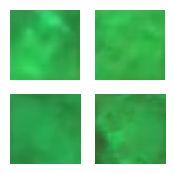

Epoch 707/1000: 100%|██████████| 87/87 [00:04<00:00, 18.86step/s]


Generator Loss: 3.7921829223632812, Discriminator Loss: 0.4243871867656708


Epoch 708/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.14step/s]

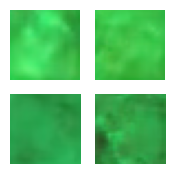

Epoch 708/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 3.6779932975769043, Discriminator Loss: 0.4306701719760895


Epoch 709/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]

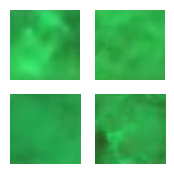

Epoch 709/1000: 100%|██████████| 87/87 [00:04<00:00, 19.17step/s]


Generator Loss: 3.667785406112671, Discriminator Loss: 0.4766852855682373


Epoch 710/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.87step/s]

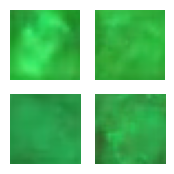

Epoch 710/1000: 100%|██████████| 87/87 [00:04<00:00, 17.80step/s]


Generator Loss: 3.5440444946289062, Discriminator Loss: 0.4278615415096283


Epoch 711/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.87step/s]

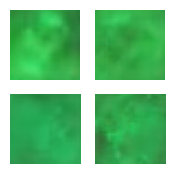

Epoch 711/1000: 100%|██████████| 87/87 [00:05<00:00, 17.18step/s]


Generator Loss: 3.8503477573394775, Discriminator Loss: 0.3374458849430084


Epoch 712/1000:  98%|█████████▊| 85/87 [00:05<00:00, 16.46step/s]

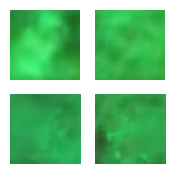

Epoch 712/1000: 100%|██████████| 87/87 [00:05<00:00, 15.76step/s]


Generator Loss: 3.7709715366363525, Discriminator Loss: 0.3993178606033325


Epoch 713/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.97step/s]

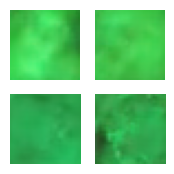

Epoch 713/1000: 100%|██████████| 87/87 [00:05<00:00, 15.69step/s]


Generator Loss: 4.101315021514893, Discriminator Loss: 0.3642393946647644


Epoch 714/1000: 100%|██████████| 87/87 [00:05<00:00, 16.08step/s]

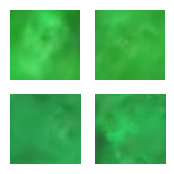

Epoch 714/1000: 100%|██████████| 87/87 [00:05<00:00, 15.40step/s]


Generator Loss: 3.8248746395111084, Discriminator Loss: 0.329013854265213


Epoch 715/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.10step/s]

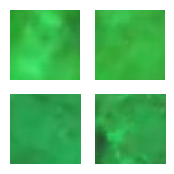

Epoch 715/1000: 100%|██████████| 87/87 [00:05<00:00, 15.49step/s]


Generator Loss: 3.9551594257354736, Discriminator Loss: 0.389119416475296


Epoch 716/1000: 100%|██████████| 87/87 [00:05<00:00, 14.97step/s]

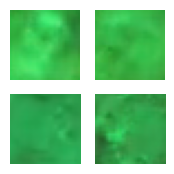

Epoch 716/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 3.6944727897644043, Discriminator Loss: 0.6097288727760315


Epoch 717/1000: 100%|██████████| 87/87 [00:05<00:00, 14.81step/s]

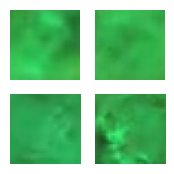

Epoch 717/1000: 100%|██████████| 87/87 [00:05<00:00, 14.71step/s]


Generator Loss: 3.724919557571411, Discriminator Loss: 0.5165355205535889


Epoch 718/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.72step/s]

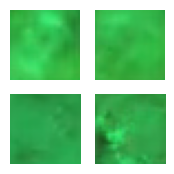

Epoch 718/1000: 100%|██████████| 87/87 [00:05<00:00, 15.24step/s]


Generator Loss: 3.871136426925659, Discriminator Loss: 0.4476836621761322


Epoch 719/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.11step/s]

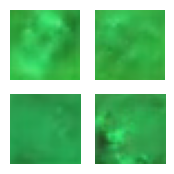

Epoch 719/1000: 100%|██████████| 87/87 [00:05<00:00, 15.22step/s]


Generator Loss: 3.8187918663024902, Discriminator Loss: 0.4118507504463196


Epoch 720/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.35step/s]

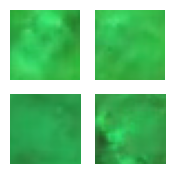

Epoch 720/1000: 100%|██████████| 87/87 [00:05<00:00, 14.95step/s]


Generator Loss: 3.65816593170166, Discriminator Loss: 0.46627119183540344


Epoch 721/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.11step/s]

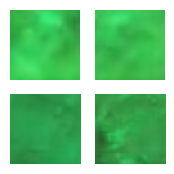

Epoch 721/1000: 100%|██████████| 87/87 [00:05<00:00, 14.82step/s]


Generator Loss: 3.4526023864746094, Discriminator Loss: 0.6038507223129272


Epoch 722/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.61step/s]

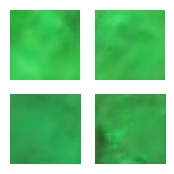

Epoch 722/1000: 100%|██████████| 87/87 [00:04<00:00, 18.15step/s]


Generator Loss: 3.563471555709839, Discriminator Loss: 0.48611852526664734


Epoch 723/1000: 100%|██████████| 87/87 [00:04<00:00, 19.18step/s]

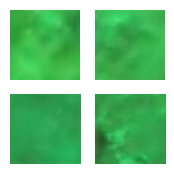

Epoch 723/1000: 100%|██████████| 87/87 [00:04<00:00, 18.72step/s]


Generator Loss: 3.678053140640259, Discriminator Loss: 0.5335946083068848


Epoch 724/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.52step/s]

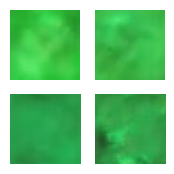

Epoch 724/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 3.710432767868042, Discriminator Loss: 0.34728196263313293


Epoch 725/1000: 100%|██████████| 87/87 [00:04<00:00, 17.89step/s]

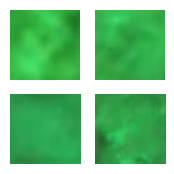

Epoch 725/1000: 100%|██████████| 87/87 [00:04<00:00, 18.37step/s]


Generator Loss: 3.79898738861084, Discriminator Loss: 0.48828551173210144


Epoch 726/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]

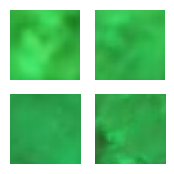

Epoch 726/1000: 100%|██████████| 87/87 [00:04<00:00, 18.93step/s]


Generator Loss: 4.060624122619629, Discriminator Loss: 0.4599308967590332


Epoch 727/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.28step/s]

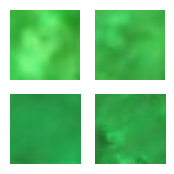

Epoch 727/1000: 100%|██████████| 87/87 [00:04<00:00, 19.43step/s]


Generator Loss: 3.9578609466552734, Discriminator Loss: 0.3377740979194641


Epoch 728/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.77step/s]

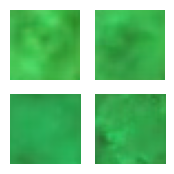

Epoch 728/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]


Generator Loss: 3.7617621421813965, Discriminator Loss: 0.3914172351360321


Epoch 729/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.85step/s]

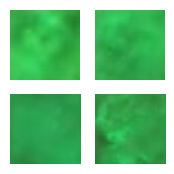

Epoch 729/1000: 100%|██████████| 87/87 [00:04<00:00, 19.98step/s]


Generator Loss: 3.911112070083618, Discriminator Loss: 0.3226919174194336


Epoch 730/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.27step/s]

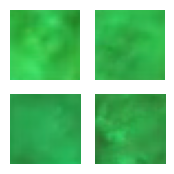

Epoch 730/1000: 100%|██████████| 87/87 [00:04<00:00, 18.93step/s]


Generator Loss: 3.956932306289673, Discriminator Loss: 0.2798539400100708


Epoch 731/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.40step/s]

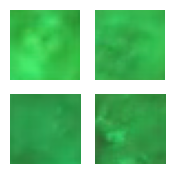

Epoch 731/1000: 100%|██████████| 87/87 [00:04<00:00, 18.05step/s]


Generator Loss: 3.8985824584960938, Discriminator Loss: 0.41863688826560974


Epoch 732/1000: 100%|██████████| 87/87 [00:04<00:00, 20.05step/s]

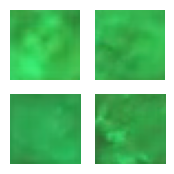

Epoch 732/1000: 100%|██████████| 87/87 [00:04<00:00, 18.91step/s]


Generator Loss: 3.765380859375, Discriminator Loss: 0.38159042596817017


Epoch 733/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.31step/s]

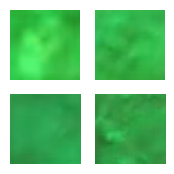

Epoch 733/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 3.7747864723205566, Discriminator Loss: 0.4529589116573334


Epoch 734/1000: 100%|██████████| 87/87 [00:04<00:00, 19.82step/s]

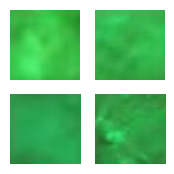

Epoch 734/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 3.90022611618042, Discriminator Loss: 0.6069529056549072


Epoch 735/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.52step/s]

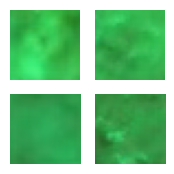

Epoch 735/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 3.6237375736236572, Discriminator Loss: 0.46465015411376953


Epoch 736/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.51step/s]

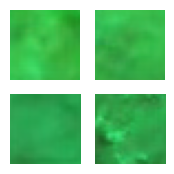

Epoch 736/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 3.8375468254089355, Discriminator Loss: 0.34706002473831177


Epoch 737/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]

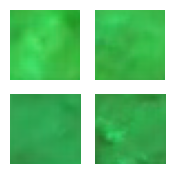

Epoch 737/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 3.870725393295288, Discriminator Loss: 0.4038200378417969


Epoch 738/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.51step/s]

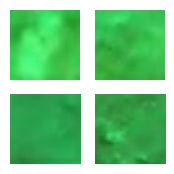

Epoch 738/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 3.8889107704162598, Discriminator Loss: 0.3527887463569641


Epoch 739/1000: 100%|██████████| 87/87 [00:04<00:00, 19.48step/s]

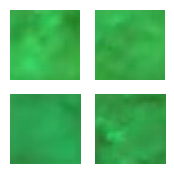

Epoch 739/1000: 100%|██████████| 87/87 [00:04<00:00, 19.51step/s]


Generator Loss: 3.7144155502319336, Discriminator Loss: 0.32624855637550354


Epoch 740/1000: 100%|██████████| 87/87 [00:04<00:00, 18.11step/s]

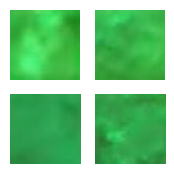

Epoch 740/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 4.087656497955322, Discriminator Loss: 0.3719700872898102


Epoch 741/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.51step/s]

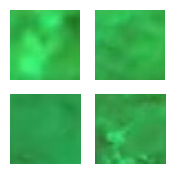

Epoch 741/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 3.831681966781616, Discriminator Loss: 0.4847619831562042


Epoch 742/1000: 100%|██████████| 87/87 [00:04<00:00, 15.76step/s]

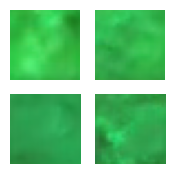

Epoch 742/1000: 100%|██████████| 87/87 [00:04<00:00, 17.80step/s]


Generator Loss: 3.737445592880249, Discriminator Loss: 0.4322580397129059


Epoch 743/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.49step/s]

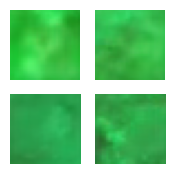

Epoch 743/1000: 100%|██████████| 87/87 [00:04<00:00, 19.20step/s]


Generator Loss: 3.979213237762451, Discriminator Loss: 0.41473135352134705


Epoch 744/1000: 100%|██████████| 87/87 [00:04<00:00, 20.73step/s]

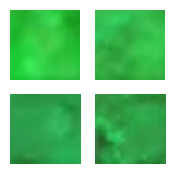

Epoch 744/1000: 100%|██████████| 87/87 [00:04<00:00, 18.27step/s]


Generator Loss: 3.699418783187866, Discriminator Loss: 0.3582955002784729


Epoch 745/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.67step/s]

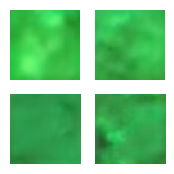

Epoch 745/1000: 100%|██████████| 87/87 [00:04<00:00, 19.81step/s]


Generator Loss: 4.2463836669921875, Discriminator Loss: 0.4078552722930908


Epoch 746/1000: 100%|██████████| 87/87 [00:04<00:00, 20.43step/s]

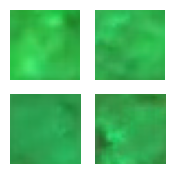

Epoch 746/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]


Generator Loss: 4.400655746459961, Discriminator Loss: 0.37071841955184937


Epoch 747/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.06step/s]

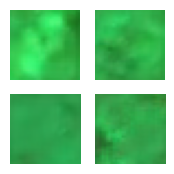

Epoch 747/1000: 100%|██████████| 87/87 [00:04<00:00, 18.26step/s]


Generator Loss: 4.025050163269043, Discriminator Loss: 0.48141348361968994


Epoch 748/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.97step/s]

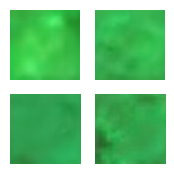

Epoch 748/1000: 100%|██████████| 87/87 [00:04<00:00, 17.65step/s]


Generator Loss: 4.163211822509766, Discriminator Loss: 0.3706662058830261


Epoch 749/1000: 100%|██████████| 87/87 [00:04<00:00, 17.73step/s]

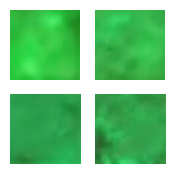

Epoch 749/1000: 100%|██████████| 87/87 [00:04<00:00, 18.28step/s]


Generator Loss: 3.9366393089294434, Discriminator Loss: 0.3398500382900238


Epoch 750/1000: 100%|██████████| 87/87 [00:04<00:00, 18.70step/s]

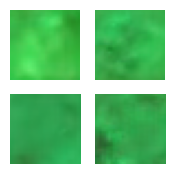

Epoch 750/1000: 100%|██████████| 87/87 [00:05<00:00, 17.33step/s]


Generator Loss: 3.8232996463775635, Discriminator Loss: 0.5126226544380188


Epoch 751/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.18step/s]

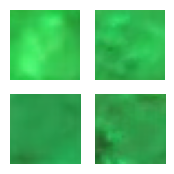

Epoch 751/1000: 100%|██████████| 87/87 [00:04<00:00, 18.08step/s]


Generator Loss: 3.8159477710723877, Discriminator Loss: 0.5738109350204468


Epoch 752/1000: 100%|██████████| 87/87 [00:04<00:00, 19.11step/s]

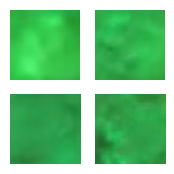

Epoch 752/1000: 100%|██████████| 87/87 [00:04<00:00, 18.41step/s]


Generator Loss: 3.824544906616211, Discriminator Loss: 0.5588558912277222


Epoch 753/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.51step/s]

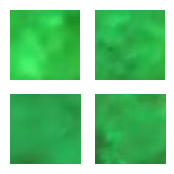

Epoch 753/1000: 100%|██████████| 87/87 [00:04<00:00, 18.07step/s]


Generator Loss: 3.549207925796509, Discriminator Loss: 0.44359689950942993


Epoch 754/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.26step/s]

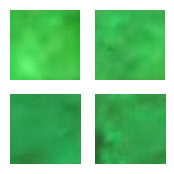

Epoch 754/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]


Generator Loss: 3.8365681171417236, Discriminator Loss: 0.3667636215686798


Epoch 755/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.97step/s]

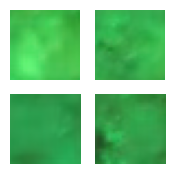

Epoch 755/1000: 100%|██████████| 87/87 [00:04<00:00, 18.34step/s]


Generator Loss: 3.8909599781036377, Discriminator Loss: 0.3229407072067261


Epoch 756/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.64step/s]

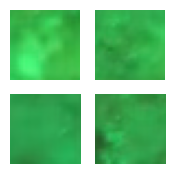

Epoch 756/1000: 100%|██████████| 87/87 [00:04<00:00, 18.17step/s]


Generator Loss: 3.8096601963043213, Discriminator Loss: 0.46237713098526


Epoch 757/1000: 100%|██████████| 87/87 [00:04<00:00, 19.39step/s]

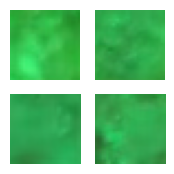

Epoch 757/1000: 100%|██████████| 87/87 [00:04<00:00, 18.69step/s]


Generator Loss: 3.7667617797851562, Discriminator Loss: 0.43842294812202454


Epoch 758/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.89step/s]

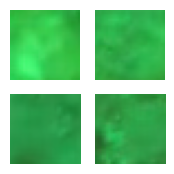

Epoch 758/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 3.7745361328125, Discriminator Loss: 0.6505990624427795


Epoch 759/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.83step/s]

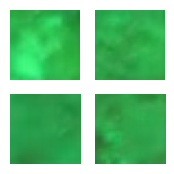

Epoch 759/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]


Generator Loss: 3.8242433071136475, Discriminator Loss: 0.30441147089004517


Epoch 760/1000: 100%|██████████| 87/87 [00:05<00:00, 16.13step/s]

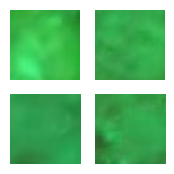

Epoch 760/1000: 100%|██████████| 87/87 [00:05<00:00, 15.58step/s]


Generator Loss: 3.857520341873169, Discriminator Loss: 0.5068366527557373


Epoch 761/1000: 100%|██████████| 87/87 [00:05<00:00, 15.12step/s]

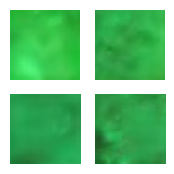

Epoch 761/1000: 100%|██████████| 87/87 [00:05<00:00, 15.46step/s]


Generator Loss: 3.456547975540161, Discriminator Loss: 0.4225430488586426


Epoch 762/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.89step/s]

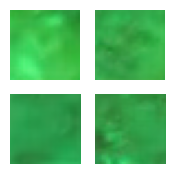

Epoch 762/1000: 100%|██████████| 87/87 [00:05<00:00, 15.63step/s]


Generator Loss: 3.976299524307251, Discriminator Loss: 0.4509330689907074


Epoch 763/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.95step/s]

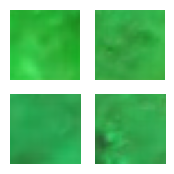

Epoch 763/1000: 100%|██████████| 87/87 [00:05<00:00, 15.60step/s]


Generator Loss: 3.9950196743011475, Discriminator Loss: 0.31214070320129395


Epoch 764/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.53step/s]

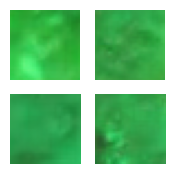

Epoch 764/1000: 100%|██████████| 87/87 [00:05<00:00, 16.21step/s]


Generator Loss: 3.9440927505493164, Discriminator Loss: 0.4698439836502075


Epoch 765/1000: 100%|██████████| 87/87 [00:05<00:00, 15.32step/s]

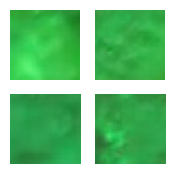

Epoch 765/1000: 100%|██████████| 87/87 [00:05<00:00, 15.24step/s]


Generator Loss: 3.995081663131714, Discriminator Loss: 0.4769088625907898


Epoch 766/1000: 100%|██████████| 87/87 [00:05<00:00, 14.90step/s]

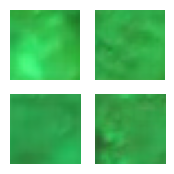

Epoch 766/1000: 100%|██████████| 87/87 [00:06<00:00, 14.38step/s]


Generator Loss: 3.9768290519714355, Discriminator Loss: 0.3691062927246094


Epoch 767/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.90step/s]

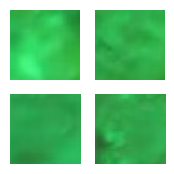

Epoch 767/1000: 100%|██████████| 87/87 [00:05<00:00, 15.36step/s]


Generator Loss: 3.9985249042510986, Discriminator Loss: 0.2926327586174011


Epoch 768/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.14step/s]

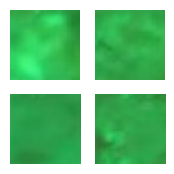

Epoch 768/1000: 100%|██████████| 87/87 [00:05<00:00, 14.81step/s]


Generator Loss: 4.202174186706543, Discriminator Loss: 0.3506488800048828


Epoch 769/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.97step/s]

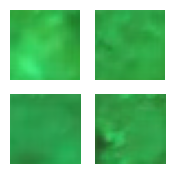

Epoch 769/1000: 100%|██████████| 87/87 [00:05<00:00, 15.01step/s]


Generator Loss: 3.873040199279785, Discriminator Loss: 0.36029231548309326


Epoch 770/1000: 100%|██████████| 87/87 [00:05<00:00, 19.56step/s]

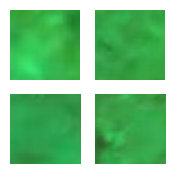

Epoch 770/1000: 100%|██████████| 87/87 [00:05<00:00, 15.94step/s]


Generator Loss: 3.8942039012908936, Discriminator Loss: 0.47619694471359253


Epoch 771/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.36step/s]

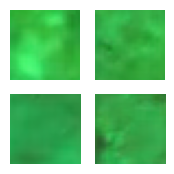

Epoch 771/1000: 100%|██████████| 87/87 [00:04<00:00, 19.39step/s]


Generator Loss: 3.644207239151001, Discriminator Loss: 0.43619391322135925


Epoch 772/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.70step/s]

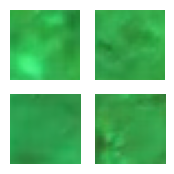

Epoch 772/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 3.9248507022857666, Discriminator Loss: 0.4651181399822235


Epoch 773/1000: 100%|██████████| 87/87 [00:04<00:00, 21.10step/s]

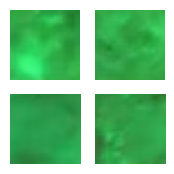

Epoch 773/1000: 100%|██████████| 87/87 [00:04<00:00, 18.85step/s]


Generator Loss: 3.7094783782958984, Discriminator Loss: 0.3573608100414276


Epoch 774/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.63step/s]

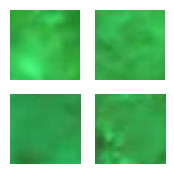

Epoch 774/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 3.9996047019958496, Discriminator Loss: 0.3009592592716217


Epoch 775/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.12step/s]

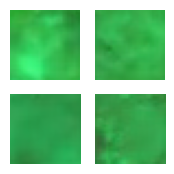

Epoch 775/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]


Generator Loss: 3.987967014312744, Discriminator Loss: 0.3525770306587219


Epoch 776/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]

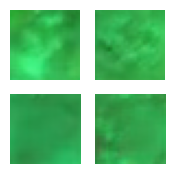

Epoch 776/1000: 100%|██████████| 87/87 [00:04<00:00, 19.30step/s]


Generator Loss: 4.15146017074585, Discriminator Loss: 0.4456707239151001


Epoch 777/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.70step/s]

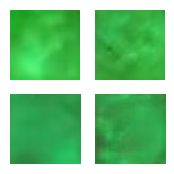

Epoch 777/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 3.7954368591308594, Discriminator Loss: 0.46725475788116455


Epoch 778/1000: 100%|██████████| 87/87 [00:04<00:00, 19.22step/s]

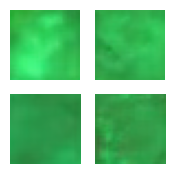

Epoch 778/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 4.0515828132629395, Discriminator Loss: 0.34787946939468384


Epoch 779/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]

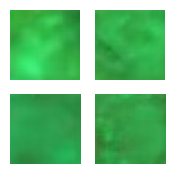

Epoch 779/1000: 100%|██████████| 87/87 [00:04<00:00, 18.88step/s]


Generator Loss: 4.19041633605957, Discriminator Loss: 0.3250786066055298


Epoch 780/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.95step/s]

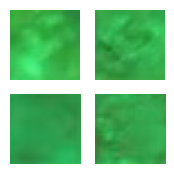

Epoch 780/1000: 100%|██████████| 87/87 [00:04<00:00, 19.04step/s]


Generator Loss: 3.8851938247680664, Discriminator Loss: 0.40790894627571106


Epoch 781/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]

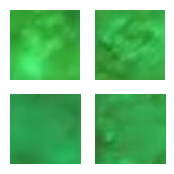

Epoch 781/1000: 100%|██████████| 87/87 [00:04<00:00, 19.20step/s]


Generator Loss: 3.847478151321411, Discriminator Loss: 0.4633638262748718


Epoch 782/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.43step/s]

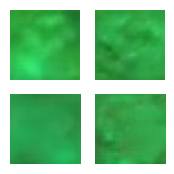

Epoch 782/1000: 100%|██████████| 87/87 [00:04<00:00, 18.66step/s]


Generator Loss: 4.46196174621582, Discriminator Loss: 0.30414724349975586


Epoch 783/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.48step/s]

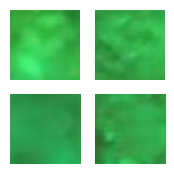

Epoch 783/1000: 100%|██████████| 87/87 [00:04<00:00, 17.95step/s]


Generator Loss: 4.0446624755859375, Discriminator Loss: 0.38108861446380615


Epoch 784/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.97step/s]

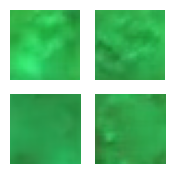

Epoch 784/1000: 100%|██████████| 87/87 [00:04<00:00, 18.35step/s]


Generator Loss: 3.704202890396118, Discriminator Loss: 0.39747536182403564


Epoch 785/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.68step/s]

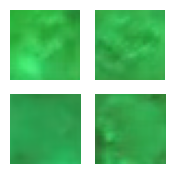

Epoch 785/1000: 100%|██████████| 87/87 [00:04<00:00, 18.95step/s]


Generator Loss: 4.159605026245117, Discriminator Loss: 0.45775845646858215


Epoch 786/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.43step/s]

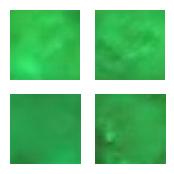

Epoch 786/1000: 100%|██████████| 87/87 [00:04<00:00, 18.93step/s]


Generator Loss: 3.8702712059020996, Discriminator Loss: 0.31457796692848206


Epoch 787/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.05step/s]

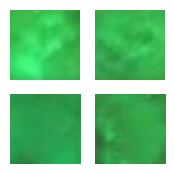

Epoch 787/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 4.183132648468018, Discriminator Loss: 0.40298742055892944


Epoch 788/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.59step/s]

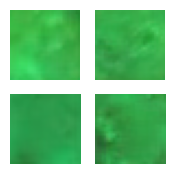

Epoch 788/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 3.984398126602173, Discriminator Loss: 0.29593929648399353


Epoch 789/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.69step/s]

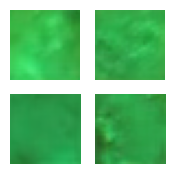

Epoch 789/1000: 100%|██████████| 87/87 [00:04<00:00, 18.85step/s]


Generator Loss: 3.477292537689209, Discriminator Loss: 0.5152706503868103


Epoch 790/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.42step/s]

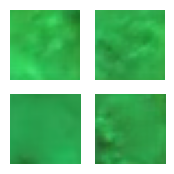

Epoch 790/1000: 100%|██████████| 87/87 [00:04<00:00, 19.16step/s]


Generator Loss: 4.3258209228515625, Discriminator Loss: 0.2821689546108246


Epoch 791/1000:  98%|█████████▊| 85/87 [00:04<00:00, 21.05step/s]

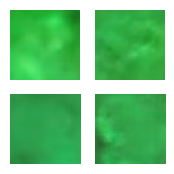

Epoch 791/1000: 100%|██████████| 87/87 [00:04<00:00, 19.59step/s]


Generator Loss: 4.429555892944336, Discriminator Loss: 0.30151844024658203


Epoch 792/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]

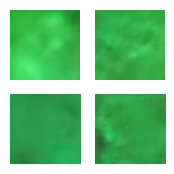

Epoch 792/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 4.386796951293945, Discriminator Loss: 0.46541836857795715


Epoch 793/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.46step/s]

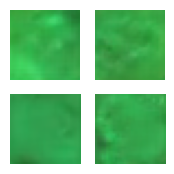

Epoch 793/1000: 100%|██████████| 87/87 [00:04<00:00, 19.02step/s]


Generator Loss: 3.763223648071289, Discriminator Loss: 0.4317589998245239


Epoch 794/1000: 100%|██████████| 87/87 [00:04<00:00, 20.57step/s]

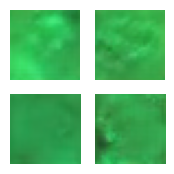

Epoch 794/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 4.075044631958008, Discriminator Loss: 0.3734223246574402


Epoch 795/1000: 100%|██████████| 87/87 [00:04<00:00, 18.86step/s]

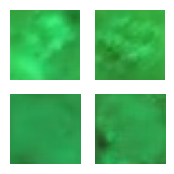

Epoch 795/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]


Generator Loss: 4.0416951179504395, Discriminator Loss: 0.38915765285491943


Epoch 796/1000: 100%|██████████| 87/87 [00:04<00:00, 19.28step/s]

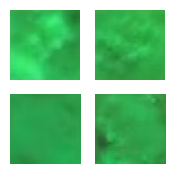

Epoch 796/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 4.240858554840088, Discriminator Loss: 0.3021714985370636


Epoch 797/1000:  98%|█████████▊| 85/87 [00:04<00:00, 17.84step/s]

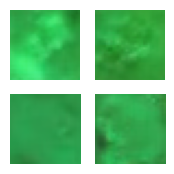

Epoch 797/1000: 100%|██████████| 87/87 [00:04<00:00, 17.88step/s]


Generator Loss: 4.234095573425293, Discriminator Loss: 0.39668533205986023


Epoch 798/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.20step/s]

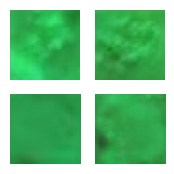

Epoch 798/1000: 100%|██████████| 87/87 [00:04<00:00, 17.47step/s]


Generator Loss: 4.085637092590332, Discriminator Loss: 0.3237209916114807


Epoch 799/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.26step/s]

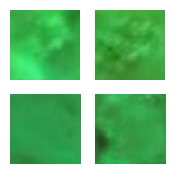

Epoch 799/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 4.104569435119629, Discriminator Loss: 0.34573492407798767


Epoch 800/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]

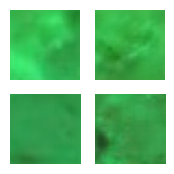

Epoch 800/1000: 100%|██████████| 87/87 [00:04<00:00, 17.66step/s]


Generator Loss: 3.863942861557007, Discriminator Loss: 0.6302927136421204


Epoch 801/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.64step/s]

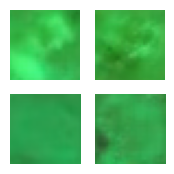

Epoch 801/1000: 100%|██████████| 87/87 [00:04<00:00, 18.03step/s]


Generator Loss: 4.346936225891113, Discriminator Loss: 0.3055068850517273


Epoch 802/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.37step/s]

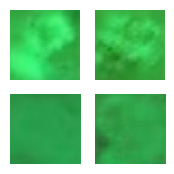

Epoch 802/1000: 100%|██████████| 87/87 [00:04<00:00, 18.69step/s]


Generator Loss: 4.102509498596191, Discriminator Loss: 0.43465760350227356


Epoch 803/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]

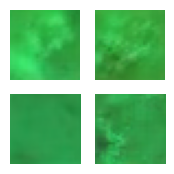

Epoch 803/1000: 100%|██████████| 87/87 [00:04<00:00, 18.30step/s]


Generator Loss: 3.91910982131958, Discriminator Loss: 0.4405105710029602


Epoch 804/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.14step/s]

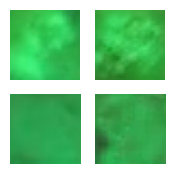

Epoch 804/1000: 100%|██████████| 87/87 [00:04<00:00, 18.09step/s]


Generator Loss: 4.202179431915283, Discriminator Loss: 0.30729949474334717


Epoch 805/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.78step/s]

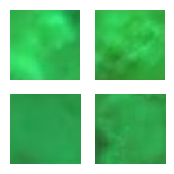

Epoch 805/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 4.152359962463379, Discriminator Loss: 0.4629887044429779


Epoch 806/1000: 100%|██████████| 87/87 [00:04<00:00, 19.06step/s]

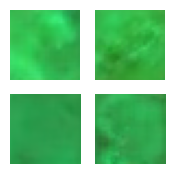

Epoch 806/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 3.8942601680755615, Discriminator Loss: 0.3163464069366455


Epoch 807/1000: 100%|██████████| 87/87 [00:04<00:00, 19.77step/s]

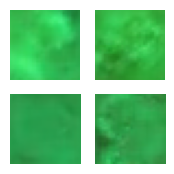

Epoch 807/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]


Generator Loss: 4.324244976043701, Discriminator Loss: 0.39581236243247986


Epoch 808/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.82step/s]

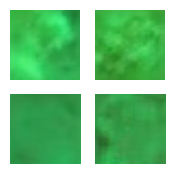

Epoch 808/1000: 100%|██████████| 87/87 [00:05<00:00, 16.83step/s]


Generator Loss: 4.246877193450928, Discriminator Loss: 0.3607218861579895


Epoch 809/1000: 100%|██████████| 87/87 [00:05<00:00, 16.88step/s]

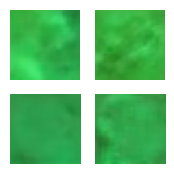

Epoch 809/1000: 100%|██████████| 87/87 [00:05<00:00, 15.84step/s]


Generator Loss: 4.058441638946533, Discriminator Loss: 0.3768433630466461


Epoch 810/1000: 100%|██████████| 87/87 [00:05<00:00, 15.56step/s]

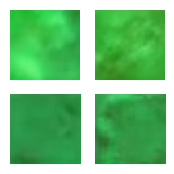

Epoch 810/1000: 100%|██████████| 87/87 [00:05<00:00, 15.14step/s]


Generator Loss: 4.13185977935791, Discriminator Loss: 0.3809746503829956


Epoch 811/1000:  99%|█████████▉| 86/87 [00:05<00:00, 16.10step/s]

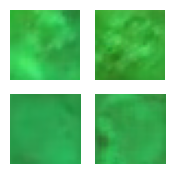

Epoch 811/1000: 100%|██████████| 87/87 [00:05<00:00, 15.48step/s]


Generator Loss: 4.395238399505615, Discriminator Loss: 0.32980167865753174


Epoch 812/1000: 100%|██████████| 87/87 [00:05<00:00, 16.24step/s]

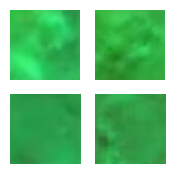

Epoch 812/1000: 100%|██████████| 87/87 [00:05<00:00, 15.62step/s]


Generator Loss: 3.837207078933716, Discriminator Loss: 0.5551419854164124


Epoch 813/1000: 100%|██████████| 87/87 [00:05<00:00, 15.30step/s]

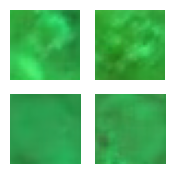

Epoch 813/1000: 100%|██████████| 87/87 [00:05<00:00, 15.28step/s]


Generator Loss: 4.183002471923828, Discriminator Loss: 0.32006001472473145


Epoch 814/1000: 100%|██████████| 87/87 [00:05<00:00, 15.05step/s]

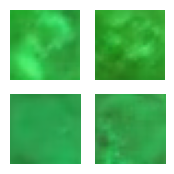

Epoch 814/1000: 100%|██████████| 87/87 [00:05<00:00, 14.95step/s]


Generator Loss: 4.01487922668457, Discriminator Loss: 0.38338908553123474


Epoch 815/1000: 100%|██████████| 87/87 [00:05<00:00, 16.57step/s]

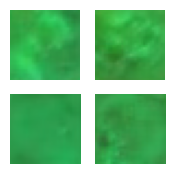

Epoch 815/1000: 100%|██████████| 87/87 [00:05<00:00, 14.62step/s]


Generator Loss: 4.17128849029541, Discriminator Loss: 0.46025365591049194


Epoch 816/1000: 100%|██████████| 87/87 [00:05<00:00, 14.62step/s]

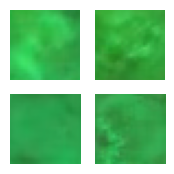

Epoch 816/1000: 100%|██████████| 87/87 [00:05<00:00, 15.13step/s]


Generator Loss: 4.144685745239258, Discriminator Loss: 0.3434208929538727


Epoch 817/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.80step/s]

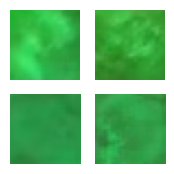

Epoch 817/1000: 100%|██████████| 87/87 [00:05<00:00, 14.61step/s]


Generator Loss: 4.042451858520508, Discriminator Loss: 0.3962571620941162


Epoch 818/1000: 100%|██████████| 87/87 [00:05<00:00, 15.12step/s]

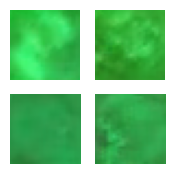

Epoch 818/1000: 100%|██████████| 87/87 [00:06<00:00, 14.23step/s]


Generator Loss: 4.182713508605957, Discriminator Loss: 0.3584824800491333


Epoch 819/1000: 100%|██████████| 87/87 [00:04<00:00, 19.73step/s]

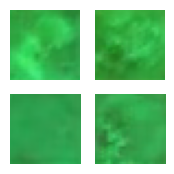

Epoch 819/1000: 100%|██████████| 87/87 [00:04<00:00, 19.58step/s]


Generator Loss: 4.047504901885986, Discriminator Loss: 0.3502728044986725


Epoch 820/1000: 100%|██████████| 87/87 [00:04<00:00, 19.65step/s]

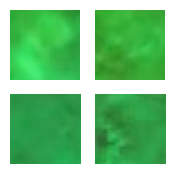

Epoch 820/1000: 100%|██████████| 87/87 [00:04<00:00, 18.97step/s]


Generator Loss: 3.975844144821167, Discriminator Loss: 0.4141194224357605


Epoch 821/1000: 100%|██████████| 87/87 [00:04<00:00, 19.25step/s]

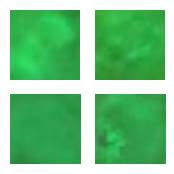

Epoch 821/1000: 100%|██████████| 87/87 [00:04<00:00, 17.99step/s]


Generator Loss: 4.301612854003906, Discriminator Loss: 0.4676484763622284


Epoch 822/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.85step/s]

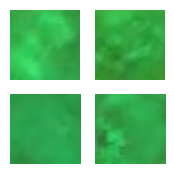

Epoch 822/1000: 100%|██████████| 87/87 [00:04<00:00, 18.87step/s]


Generator Loss: 3.915018320083618, Discriminator Loss: 0.42722535133361816


Epoch 823/1000: 100%|██████████| 87/87 [00:04<00:00, 19.40step/s]

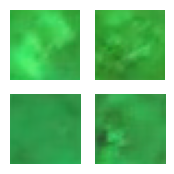

Epoch 823/1000: 100%|██████████| 87/87 [00:04<00:00, 18.38step/s]


Generator Loss: 4.0477399826049805, Discriminator Loss: 0.3140406906604767


Epoch 824/1000: 100%|██████████| 87/87 [00:04<00:00, 19.42step/s]

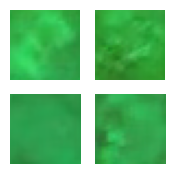

Epoch 824/1000: 100%|██████████| 87/87 [00:04<00:00, 18.82step/s]


Generator Loss: 4.372721195220947, Discriminator Loss: 0.33344802260398865


Epoch 825/1000: 100%|██████████| 87/87 [00:04<00:00, 19.92step/s]

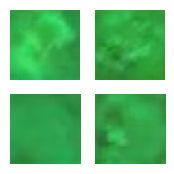

Epoch 825/1000: 100%|██████████| 87/87 [00:04<00:00, 18.69step/s]


Generator Loss: 4.089437007904053, Discriminator Loss: 0.35250380635261536


Epoch 826/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.04step/s]

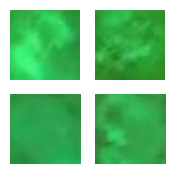

Epoch 826/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 3.9869725704193115, Discriminator Loss: 0.39390695095062256


Epoch 827/1000: 100%|██████████| 87/87 [00:04<00:00, 17.60step/s]

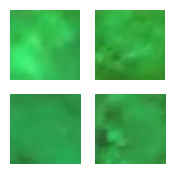

Epoch 827/1000: 100%|██████████| 87/87 [00:04<00:00, 18.13step/s]


Generator Loss: 4.244376182556152, Discriminator Loss: 0.40344923734664917


Epoch 828/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.83step/s]

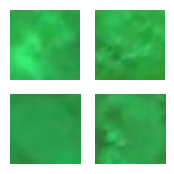

Epoch 828/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]


Generator Loss: 4.272348880767822, Discriminator Loss: 0.32351815700531006


Epoch 829/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.04step/s]

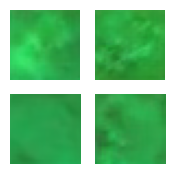

Epoch 829/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 3.730818033218384, Discriminator Loss: 0.6236576437950134


Epoch 830/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.62step/s]

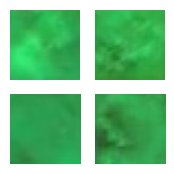

Epoch 830/1000: 100%|██████████| 87/87 [00:04<00:00, 18.63step/s]


Generator Loss: 4.121050834655762, Discriminator Loss: 0.400485634803772


Epoch 831/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]

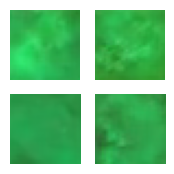

Epoch 831/1000: 100%|██████████| 87/87 [00:04<00:00, 18.36step/s]


Generator Loss: 3.9578795433044434, Discriminator Loss: 0.38146844506263733


Epoch 832/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.54step/s]

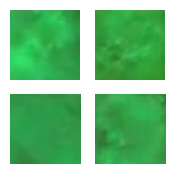

Epoch 832/1000: 100%|██████████| 87/87 [00:04<00:00, 18.61step/s]


Generator Loss: 4.292653560638428, Discriminator Loss: 0.46548229455947876


Epoch 833/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.54step/s]

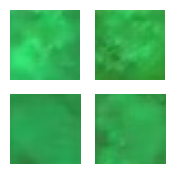

Epoch 833/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 4.0646796226501465, Discriminator Loss: 0.3852691650390625


Epoch 834/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.68step/s]

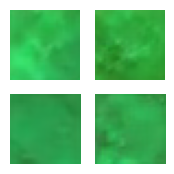

Epoch 834/1000: 100%|██████████| 87/87 [00:04<00:00, 19.11step/s]


Generator Loss: 3.792304754257202, Discriminator Loss: 0.5150385499000549


Epoch 835/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.75step/s]

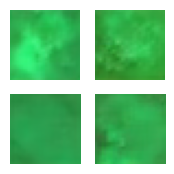

Epoch 835/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 4.142655849456787, Discriminator Loss: 0.4016560912132263


Epoch 836/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.96step/s]

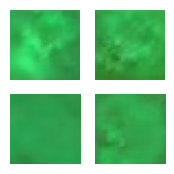

Epoch 836/1000: 100%|██████████| 87/87 [00:04<00:00, 19.28step/s]


Generator Loss: 4.4303765296936035, Discriminator Loss: 0.3317950665950775


Epoch 837/1000: 100%|██████████| 87/87 [00:04<00:00, 21.58step/s]

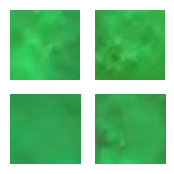

Epoch 837/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]


Generator Loss: 3.9817800521850586, Discriminator Loss: 0.5036289095878601


Epoch 838/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.70step/s]

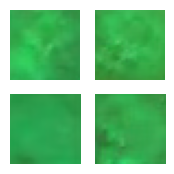

Epoch 838/1000: 100%|██████████| 87/87 [00:04<00:00, 17.70step/s]


Generator Loss: 3.7897791862487793, Discriminator Loss: 0.47553274035453796


Epoch 839/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.71step/s]

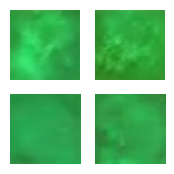

Epoch 839/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 4.113743782043457, Discriminator Loss: 0.304057240486145


Epoch 840/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.15step/s]

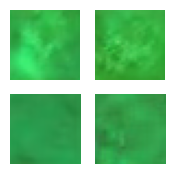

Epoch 840/1000: 100%|██████████| 87/87 [00:04<00:00, 18.08step/s]


Generator Loss: 4.036030292510986, Discriminator Loss: 0.36247900128364563


Epoch 841/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.90step/s]

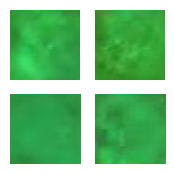

Epoch 841/1000: 100%|██████████| 87/87 [00:04<00:00, 19.20step/s]


Generator Loss: 4.304183483123779, Discriminator Loss: 0.28401148319244385


Epoch 842/1000: 100%|██████████| 87/87 [00:04<00:00, 20.39step/s]

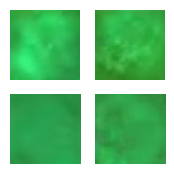

Epoch 842/1000: 100%|██████████| 87/87 [00:04<00:00, 18.04step/s]


Generator Loss: 4.391232490539551, Discriminator Loss: 0.2769745886325836


Epoch 843/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.28step/s]

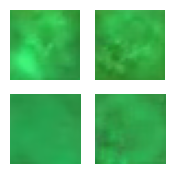

Epoch 843/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 4.225970268249512, Discriminator Loss: 0.31482064723968506


Epoch 844/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.17step/s]

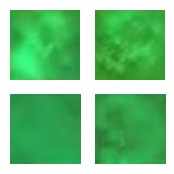

Epoch 844/1000: 100%|██████████| 87/87 [00:04<00:00, 19.55step/s]


Generator Loss: 3.750343084335327, Discriminator Loss: 0.6142252087593079


Epoch 845/1000: 100%|██████████| 87/87 [00:04<00:00, 16.29step/s]

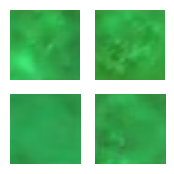

Epoch 845/1000: 100%|██████████| 87/87 [00:05<00:00, 17.37step/s]


Generator Loss: 4.2570576667785645, Discriminator Loss: 0.38878193497657776


Epoch 846/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.17step/s]

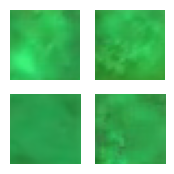

Epoch 846/1000: 100%|██████████| 87/87 [00:04<00:00, 17.42step/s]


Generator Loss: 3.720219373703003, Discriminator Loss: 0.3824412524700165


Epoch 847/1000: 100%|██████████| 87/87 [00:04<00:00, 16.99step/s]

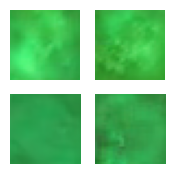

Epoch 847/1000: 100%|██████████| 87/87 [00:04<00:00, 17.98step/s]


Generator Loss: 4.202338695526123, Discriminator Loss: 0.3380569815635681


Epoch 848/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.10step/s]

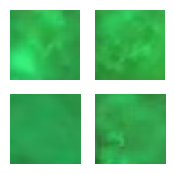

Epoch 848/1000: 100%|██████████| 87/87 [00:04<00:00, 17.48step/s]


Generator Loss: 4.205035209655762, Discriminator Loss: 0.39999863505363464


Epoch 849/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]

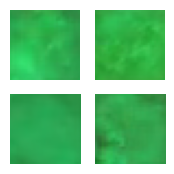

Epoch 849/1000: 100%|██████████| 87/87 [00:04<00:00, 17.86step/s]


Generator Loss: 4.2981672286987305, Discriminator Loss: 0.3177584409713745


Epoch 850/1000: 100%|██████████| 87/87 [00:04<00:00, 19.75step/s]

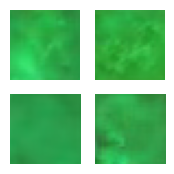

Epoch 850/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 4.128818035125732, Discriminator Loss: 0.29358726739883423


Epoch 851/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.64step/s]

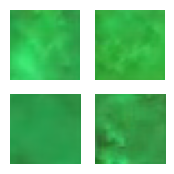

Epoch 851/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 4.3443193435668945, Discriminator Loss: 0.36311155557632446


Epoch 852/1000: 100%|██████████| 87/87 [00:04<00:00, 19.40step/s]

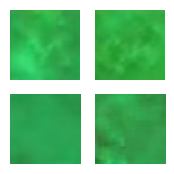

Epoch 852/1000: 100%|██████████| 87/87 [00:04<00:00, 17.97step/s]


Generator Loss: 3.9542930126190186, Discriminator Loss: 0.371466726064682


Epoch 853/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.87step/s]

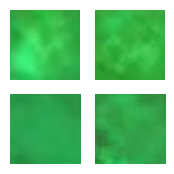

Epoch 853/1000: 100%|██████████| 87/87 [00:04<00:00, 18.72step/s]


Generator Loss: 4.507225513458252, Discriminator Loss: 0.3735131323337555


Epoch 854/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.38step/s]

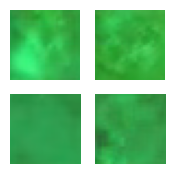

Epoch 854/1000: 100%|██████████| 87/87 [00:04<00:00, 17.76step/s]


Generator Loss: 4.072061061859131, Discriminator Loss: 0.3295087218284607


Epoch 855/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.47step/s]

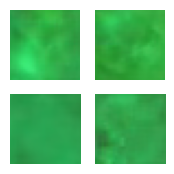

Epoch 855/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 4.505447864532471, Discriminator Loss: 0.3411126434803009


Epoch 856/1000: 100%|██████████| 87/87 [00:04<00:00, 17.53step/s]

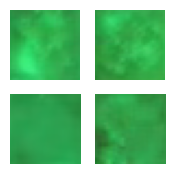

Epoch 856/1000: 100%|██████████| 87/87 [00:04<00:00, 18.21step/s]


Generator Loss: 4.444461822509766, Discriminator Loss: 0.44148218631744385


Epoch 857/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.75step/s]

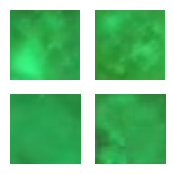

Epoch 857/1000: 100%|██████████| 87/87 [00:05<00:00, 15.55step/s]


Generator Loss: 4.032171249389648, Discriminator Loss: 0.3528713285923004


Epoch 858/1000: 100%|██████████| 87/87 [00:05<00:00, 16.34step/s]

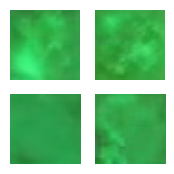

Epoch 858/1000: 100%|██████████| 87/87 [00:05<00:00, 15.90step/s]


Generator Loss: 4.009379863739014, Discriminator Loss: 0.43138906359672546


Epoch 859/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.57step/s]

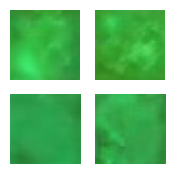

Epoch 859/1000: 100%|██████████| 87/87 [00:05<00:00, 15.63step/s]


Generator Loss: 4.046330451965332, Discriminator Loss: 0.44455552101135254


Epoch 860/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.52step/s]

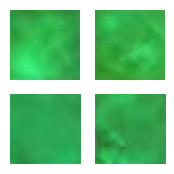

Epoch 860/1000: 100%|██████████| 87/87 [00:05<00:00, 15.36step/s]


Generator Loss: 3.9343643188476562, Discriminator Loss: 0.5324354767799377


Epoch 861/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.93step/s]

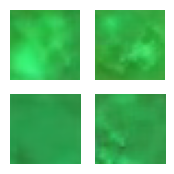

Epoch 861/1000: 100%|██████████| 87/87 [00:05<00:00, 15.20step/s]


Generator Loss: 3.9352850914001465, Discriminator Loss: 0.332155704498291


Epoch 862/1000: 100%|██████████| 87/87 [00:05<00:00, 14.48step/s]

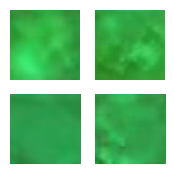

Epoch 862/1000: 100%|██████████| 87/87 [00:05<00:00, 14.85step/s]


Generator Loss: 4.253534317016602, Discriminator Loss: 0.2986827790737152


Epoch 863/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.48step/s]

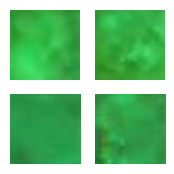

Epoch 863/1000: 100%|██████████| 87/87 [00:05<00:00, 14.52step/s]


Generator Loss: 4.255351543426514, Discriminator Loss: 0.3265325129032135


Epoch 864/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.60step/s]

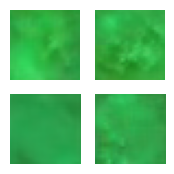

Epoch 864/1000: 100%|██████████| 87/87 [00:05<00:00, 14.60step/s]


Generator Loss: 4.35013484954834, Discriminator Loss: 0.3213919401168823


Epoch 865/1000: 100%|██████████| 87/87 [00:05<00:00, 14.60step/s]

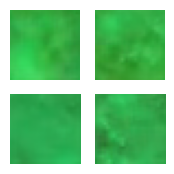

Epoch 865/1000: 100%|██████████| 87/87 [00:05<00:00, 15.24step/s]


Generator Loss: 4.350070476531982, Discriminator Loss: 0.34787049889564514


Epoch 866/1000: 100%|██████████| 87/87 [00:05<00:00, 14.77step/s]

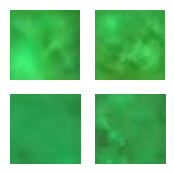

Epoch 866/1000: 100%|██████████| 87/87 [00:06<00:00, 14.43step/s]


Generator Loss: 4.511144161224365, Discriminator Loss: 0.2885932922363281


Epoch 867/1000: 100%|██████████| 87/87 [00:04<00:00, 17.73step/s]

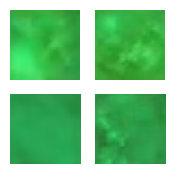

Epoch 867/1000: 100%|██████████| 87/87 [00:05<00:00, 17.38step/s]


Generator Loss: 4.24372673034668, Discriminator Loss: 0.4738680422306061


Epoch 868/1000: 100%|██████████| 87/87 [00:04<00:00, 20.73step/s]

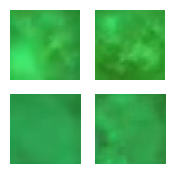

Epoch 868/1000: 100%|██████████| 87/87 [00:04<00:00, 19.09step/s]


Generator Loss: 4.392144680023193, Discriminator Loss: 0.28748464584350586


Epoch 869/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.28step/s]

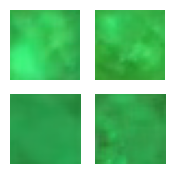

Epoch 869/1000: 100%|██████████| 87/87 [00:04<00:00, 19.29step/s]


Generator Loss: 4.378872394561768, Discriminator Loss: 0.2936321496963501


Epoch 870/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.09step/s]

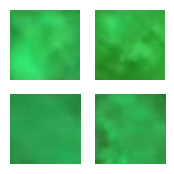

Epoch 870/1000: 100%|██████████| 87/87 [00:04<00:00, 19.08step/s]


Generator Loss: 4.1773810386657715, Discriminator Loss: 0.4065621495246887


Epoch 871/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.31step/s]

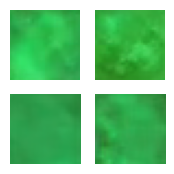

Epoch 871/1000: 100%|██████████| 87/87 [00:04<00:00, 19.29step/s]


Generator Loss: 4.123049736022949, Discriminator Loss: 0.3535062074661255


Epoch 872/1000: 100%|██████████| 87/87 [00:04<00:00, 21.06step/s]

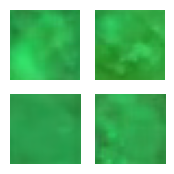

Epoch 872/1000: 100%|██████████| 87/87 [00:04<00:00, 19.41step/s]


Generator Loss: 3.997328042984009, Discriminator Loss: 0.4181702733039856


Epoch 873/1000: 100%|██████████| 87/87 [00:04<00:00, 17.67step/s]

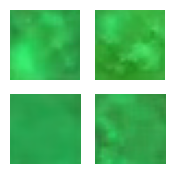

Epoch 873/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 4.370859146118164, Discriminator Loss: 0.42516279220581055


Epoch 874/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.61step/s]

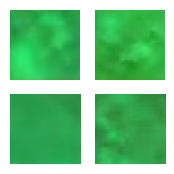

Epoch 874/1000: 100%|██████████| 87/87 [00:04<00:00, 18.28step/s]


Generator Loss: 4.432315349578857, Discriminator Loss: 0.327055960893631


Epoch 875/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.26step/s]

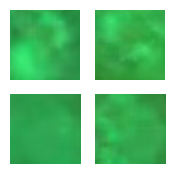

Epoch 875/1000: 100%|██████████| 87/87 [00:04<00:00, 18.74step/s]


Generator Loss: 4.286237716674805, Discriminator Loss: 0.34925925731658936


Epoch 876/1000: 100%|██████████| 87/87 [00:04<00:00, 19.70step/s]

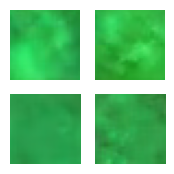

Epoch 876/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 4.136661529541016, Discriminator Loss: 0.5245506167411804


Epoch 877/1000: 100%|██████████| 87/87 [00:04<00:00, 18.37step/s]

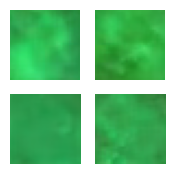

Epoch 877/1000: 100%|██████████| 87/87 [00:04<00:00, 17.78step/s]


Generator Loss: 4.430905818939209, Discriminator Loss: 0.3326074481010437


Epoch 878/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.05step/s]

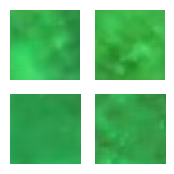

Epoch 878/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 4.570791721343994, Discriminator Loss: 0.4179345965385437


Epoch 879/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.59step/s]

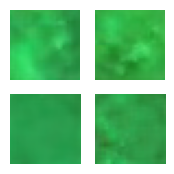

Epoch 879/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 4.205912113189697, Discriminator Loss: 0.3120240569114685


Epoch 880/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.07step/s]

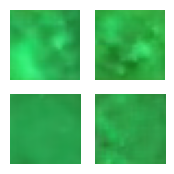

Epoch 880/1000: 100%|██████████| 87/87 [00:04<00:00, 18.29step/s]


Generator Loss: 4.114119529724121, Discriminator Loss: 0.29363876581192017


Epoch 881/1000: 100%|██████████| 87/87 [00:04<00:00, 19.69step/s]

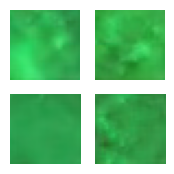

Epoch 881/1000: 100%|██████████| 87/87 [00:04<00:00, 18.70step/s]


Generator Loss: 4.286705493927002, Discriminator Loss: 0.3460354804992676


Epoch 882/1000:  98%|█████████▊| 85/87 [00:04<00:00, 15.94step/s]

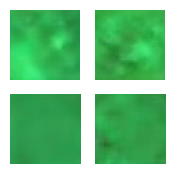

Epoch 882/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 4.710276126861572, Discriminator Loss: 0.32458460330963135


Epoch 883/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.87step/s]

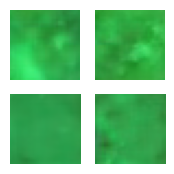

Epoch 883/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 4.265842437744141, Discriminator Loss: 0.2597421109676361


Epoch 884/1000: 100%|██████████| 87/87 [00:04<00:00, 19.18step/s]

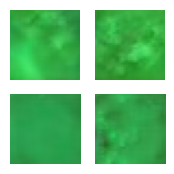

Epoch 884/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]


Generator Loss: 4.324028491973877, Discriminator Loss: 0.25273191928863525


Epoch 885/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.50step/s]

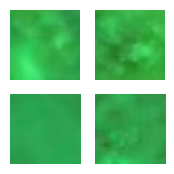

Epoch 885/1000: 100%|██████████| 87/87 [00:04<00:00, 19.33step/s]


Generator Loss: 4.484344959259033, Discriminator Loss: 0.30921289324760437


Epoch 886/1000: 100%|██████████| 87/87 [00:04<00:00, 19.49step/s]

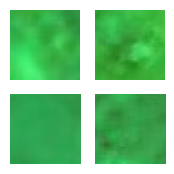

Epoch 886/1000: 100%|██████████| 87/87 [00:04<00:00, 17.84step/s]


Generator Loss: 4.294068336486816, Discriminator Loss: 0.595963716506958


Epoch 887/1000: 100%|██████████| 87/87 [00:04<00:00, 21.09step/s]

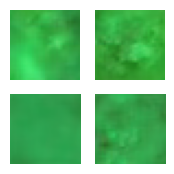

Epoch 887/1000: 100%|██████████| 87/87 [00:04<00:00, 18.16step/s]


Generator Loss: 4.186824798583984, Discriminator Loss: 0.35755500197410583


Epoch 888/1000: 100%|██████████| 87/87 [00:04<00:00, 20.03step/s]

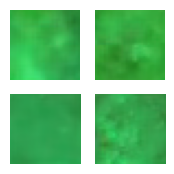

Epoch 888/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 4.2780609130859375, Discriminator Loss: 0.40765491127967834


Epoch 889/1000: 100%|██████████| 87/87 [00:04<00:00, 20.32step/s]

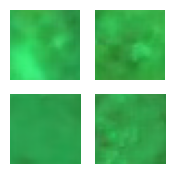

Epoch 889/1000: 100%|██████████| 87/87 [00:04<00:00, 18.59step/s]


Generator Loss: 4.029907703399658, Discriminator Loss: 0.4526694416999817


Epoch 890/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.47step/s]

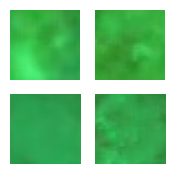

Epoch 890/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 4.102126121520996, Discriminator Loss: 0.32499226927757263


Epoch 891/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.04step/s]

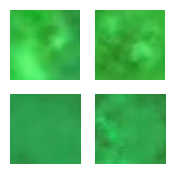

Epoch 891/1000: 100%|██████████| 87/87 [00:04<00:00, 18.91step/s]


Generator Loss: 4.267214775085449, Discriminator Loss: 0.32901281118392944


Epoch 892/1000:  99%|█████████▉| 86/87 [00:04<00:00, 22.07step/s]

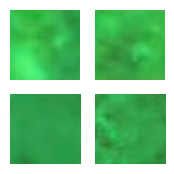

Epoch 892/1000: 100%|██████████| 87/87 [00:04<00:00, 19.41step/s]


Generator Loss: 4.63670015335083, Discriminator Loss: 0.22643588483333588


Epoch 893/1000: 100%|██████████| 87/87 [00:04<00:00, 17.14step/s]

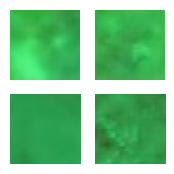

Epoch 893/1000: 100%|██████████| 87/87 [00:04<00:00, 17.46step/s]


Generator Loss: 4.454655647277832, Discriminator Loss: 0.46913427114486694


Epoch 894/1000: 100%|██████████| 87/87 [00:04<00:00, 19.34step/s]

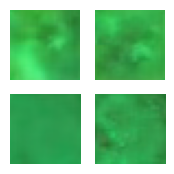

Epoch 894/1000: 100%|██████████| 87/87 [00:04<00:00, 17.63step/s]


Generator Loss: 3.9603068828582764, Discriminator Loss: 0.4198135435581207


Epoch 895/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.53step/s]

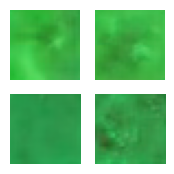

Epoch 895/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 4.61702299118042, Discriminator Loss: 0.29584482312202454


Epoch 896/1000: 100%|██████████| 87/87 [00:04<00:00, 17.84step/s]

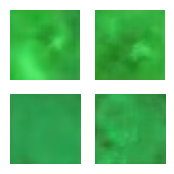

Epoch 896/1000: 100%|██████████| 87/87 [00:05<00:00, 17.16step/s]


Generator Loss: 4.095933437347412, Discriminator Loss: 0.46548014879226685


Epoch 897/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.77step/s]

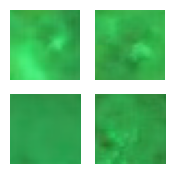

Epoch 897/1000: 100%|██████████| 87/87 [00:05<00:00, 17.39step/s]


Generator Loss: 4.437856674194336, Discriminator Loss: 0.31927722692489624


Epoch 898/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.62step/s]

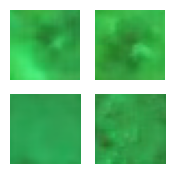

Epoch 898/1000: 100%|██████████| 87/87 [00:04<00:00, 17.61step/s]


Generator Loss: 4.148785591125488, Discriminator Loss: 0.3704238533973694


Epoch 899/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.86step/s]

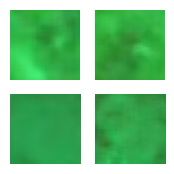

Epoch 899/1000: 100%|██████████| 87/87 [00:04<00:00, 18.74step/s]


Generator Loss: 4.251674175262451, Discriminator Loss: 0.3323507010936737


Epoch 900/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.66step/s]

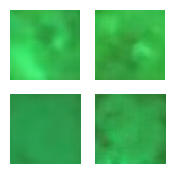

Epoch 900/1000: 100%|██████████| 87/87 [00:04<00:00, 18.56step/s]


Generator Loss: 4.096602916717529, Discriminator Loss: 0.36891037225723267


Epoch 901/1000: 100%|██████████| 87/87 [00:04<00:00, 19.79step/s]

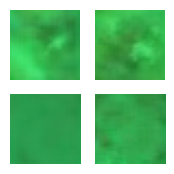

Epoch 901/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]


Generator Loss: 4.282899856567383, Discriminator Loss: 0.5116974115371704


Epoch 902/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]

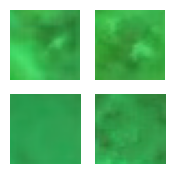

Epoch 902/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 4.110215663909912, Discriminator Loss: 0.31258273124694824


Epoch 903/1000: 100%|██████████| 87/87 [00:04<00:00, 17.63step/s]

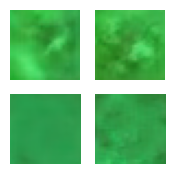

Epoch 903/1000: 100%|██████████| 87/87 [00:04<00:00, 18.71step/s]


Generator Loss: 3.902359962463379, Discriminator Loss: 0.48643791675567627


Epoch 904/1000: 100%|██████████| 87/87 [00:04<00:00, 18.92step/s]

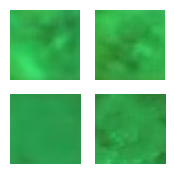

Epoch 904/1000: 100%|██████████| 87/87 [00:04<00:00, 18.40step/s]


Generator Loss: 4.179907321929932, Discriminator Loss: 0.32238346338272095


Epoch 905/1000: 100%|██████████| 87/87 [00:05<00:00, 16.73step/s]

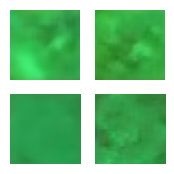

Epoch 905/1000: 100%|██████████| 87/87 [00:05<00:00, 16.01step/s]


Generator Loss: 4.3711113929748535, Discriminator Loss: 0.27467477321624756


Epoch 906/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.10step/s]

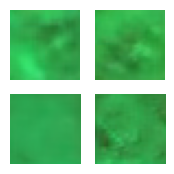

Epoch 906/1000: 100%|██████████| 87/87 [00:05<00:00, 15.49step/s]


Generator Loss: 4.301243782043457, Discriminator Loss: 0.3304305374622345


Epoch 907/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.53step/s]

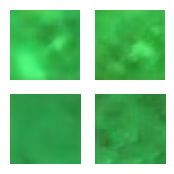

Epoch 907/1000: 100%|██████████| 87/87 [00:05<00:00, 14.96step/s]


Generator Loss: 4.4529500007629395, Discriminator Loss: 0.2862601578235626


Epoch 908/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.79step/s]

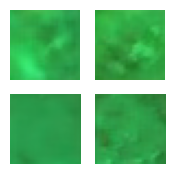

Epoch 908/1000: 100%|██████████| 87/87 [00:05<00:00, 15.45step/s]


Generator Loss: 4.431185245513916, Discriminator Loss: 0.455088347196579


Epoch 909/1000: 100%|██████████| 87/87 [00:05<00:00, 16.02step/s]

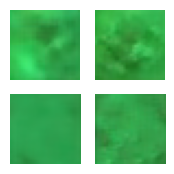

Epoch 909/1000: 100%|██████████| 87/87 [00:05<00:00, 15.35step/s]


Generator Loss: 4.367447376251221, Discriminator Loss: 0.3542989194393158


Epoch 910/1000: 100%|██████████| 87/87 [00:05<00:00, 15.04step/s]

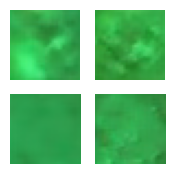

Epoch 910/1000: 100%|██████████| 87/87 [00:05<00:00, 15.35step/s]


Generator Loss: 4.080068111419678, Discriminator Loss: 0.3483549654483795


Epoch 911/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.77step/s]

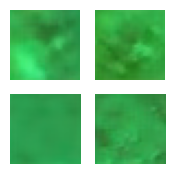

Epoch 911/1000: 100%|██████████| 87/87 [00:05<00:00, 14.56step/s]


Generator Loss: 4.303538799285889, Discriminator Loss: 0.4061338007450104


Epoch 912/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.76step/s]

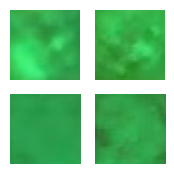

Epoch 912/1000: 100%|██████████| 87/87 [00:05<00:00, 14.98step/s]


Generator Loss: 4.304719924926758, Discriminator Loss: 0.21889673173427582


Epoch 913/1000: 100%|██████████| 87/87 [00:05<00:00, 15.14step/s]

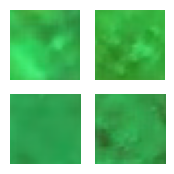

Epoch 913/1000: 100%|██████████| 87/87 [00:05<00:00, 15.18step/s]


Generator Loss: 4.638828754425049, Discriminator Loss: 0.29026511311531067


Epoch 914/1000: 100%|██████████| 87/87 [00:05<00:00, 15.17step/s]

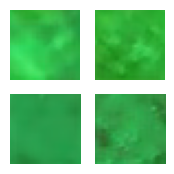

Epoch 914/1000: 100%|██████████| 87/87 [00:06<00:00, 14.49step/s]


Generator Loss: 4.6063361167907715, Discriminator Loss: 0.3732181787490845


Epoch 915/1000:  99%|█████████▉| 86/87 [00:05<00:00, 19.92step/s]

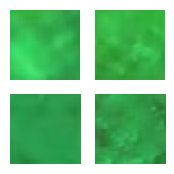

Epoch 915/1000: 100%|██████████| 87/87 [00:05<00:00, 16.25step/s]


Generator Loss: 4.52504301071167, Discriminator Loss: 0.4103684723377228


Epoch 916/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.89step/s]

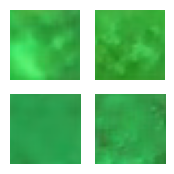

Epoch 916/1000: 100%|██████████| 87/87 [00:04<00:00, 19.71step/s]


Generator Loss: 4.513771057128906, Discriminator Loss: 0.2670668065547943


Epoch 917/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.67step/s]

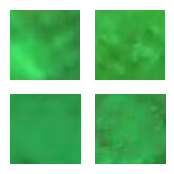

Epoch 917/1000: 100%|██████████| 87/87 [00:04<00:00, 18.27step/s]


Generator Loss: 4.253284454345703, Discriminator Loss: 0.5321993827819824


Epoch 918/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.05step/s]

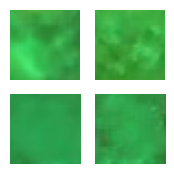

Epoch 918/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 4.349974155426025, Discriminator Loss: 0.29616302251815796


Epoch 919/1000: 100%|██████████| 87/87 [00:04<00:00, 18.86step/s]

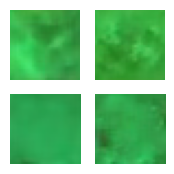

Epoch 919/1000: 100%|██████████| 87/87 [00:04<00:00, 19.35step/s]


Generator Loss: 4.193350791931152, Discriminator Loss: 0.4454769194126129


Epoch 920/1000: 100%|██████████| 87/87 [00:04<00:00, 20.77step/s]

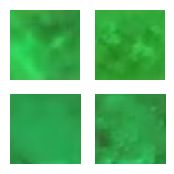

Epoch 920/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 4.267224311828613, Discriminator Loss: 0.34950709342956543


Epoch 921/1000: 100%|██████████| 87/87 [00:04<00:00, 20.47step/s]

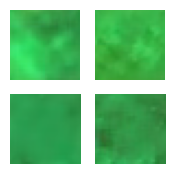

Epoch 921/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 4.131453514099121, Discriminator Loss: 0.46481892466545105


Epoch 922/1000: 100%|██████████| 87/87 [00:04<00:00, 18.14step/s]

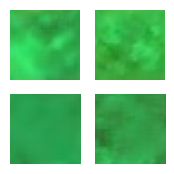

Epoch 922/1000: 100%|██████████| 87/87 [00:04<00:00, 17.64step/s]


Generator Loss: 4.475340366363525, Discriminator Loss: 0.27475982904434204


Epoch 923/1000: 100%|██████████| 87/87 [00:04<00:00, 18.94step/s]

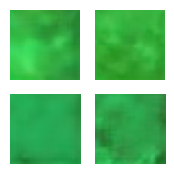

Epoch 923/1000: 100%|██████████| 87/87 [00:04<00:00, 19.32step/s]


Generator Loss: 4.567225456237793, Discriminator Loss: 0.2552125155925751


Epoch 924/1000: 100%|██████████| 87/87 [00:04<00:00, 20.90step/s]

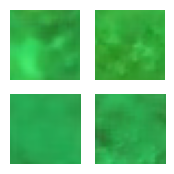

Epoch 924/1000: 100%|██████████| 87/87 [00:04<00:00, 18.06step/s]


Generator Loss: 4.730360984802246, Discriminator Loss: 0.3691696524620056


Epoch 925/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.48step/s]

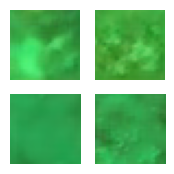

Epoch 925/1000: 100%|██████████| 87/87 [00:04<00:00, 19.13step/s]


Generator Loss: 4.511912822723389, Discriminator Loss: 0.292061984539032


Epoch 926/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]

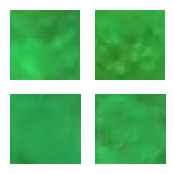

Epoch 926/1000: 100%|██████████| 87/87 [00:04<00:00, 18.44step/s]


Generator Loss: 4.7591471672058105, Discriminator Loss: 0.39586305618286133


Epoch 927/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.41step/s]

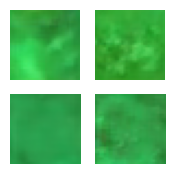

Epoch 927/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]


Generator Loss: 4.5281524658203125, Discriminator Loss: 0.519203245639801


Epoch 928/1000: 100%|██████████| 87/87 [00:04<00:00, 19.34step/s]

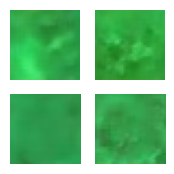

Epoch 928/1000: 100%|██████████| 87/87 [00:04<00:00, 17.97step/s]


Generator Loss: 4.061295032501221, Discriminator Loss: 0.3316608965396881


Epoch 929/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.28step/s]

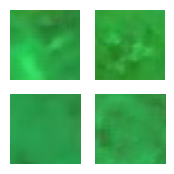

Epoch 929/1000: 100%|██████████| 87/87 [00:04<00:00, 18.48step/s]


Generator Loss: 4.165782928466797, Discriminator Loss: 0.46426519751548767


Epoch 930/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]

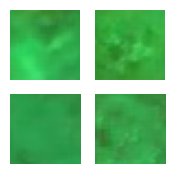

Epoch 930/1000: 100%|██████████| 87/87 [00:04<00:00, 18.91step/s]


Generator Loss: 4.130626678466797, Discriminator Loss: 0.3854580521583557


Epoch 931/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.65step/s]

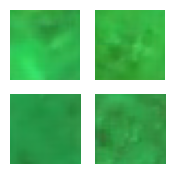

Epoch 931/1000: 100%|██████████| 87/87 [00:04<00:00, 18.80step/s]


Generator Loss: 4.3778767585754395, Discriminator Loss: 0.32994627952575684


Epoch 932/1000:  98%|█████████▊| 85/87 [00:04<00:00, 20.13step/s]

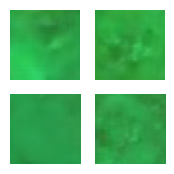

Epoch 932/1000: 100%|██████████| 87/87 [00:04<00:00, 19.16step/s]


Generator Loss: 4.23808479309082, Discriminator Loss: 0.41508427262306213


Epoch 933/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.39step/s]

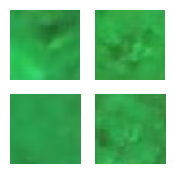

Epoch 933/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 4.279455661773682, Discriminator Loss: 0.2713471055030823


Epoch 934/1000: 100%|██████████| 87/87 [00:04<00:00, 18.42step/s]

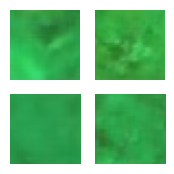

Epoch 934/1000: 100%|██████████| 87/87 [00:04<00:00, 18.33step/s]


Generator Loss: 4.234109401702881, Discriminator Loss: 0.35317742824554443


Epoch 935/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]

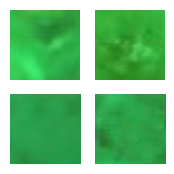

Epoch 935/1000: 100%|██████████| 87/87 [00:05<00:00, 17.30step/s]


Generator Loss: 4.206671714782715, Discriminator Loss: 0.23004339635372162


Epoch 936/1000: 100%|██████████| 87/87 [00:04<00:00, 19.99step/s]

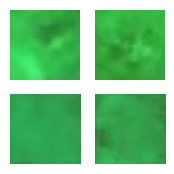

Epoch 936/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]


Generator Loss: 4.301056861877441, Discriminator Loss: 0.2993215024471283


Epoch 937/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.25step/s]

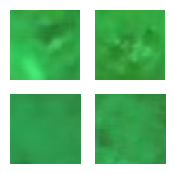

Epoch 937/1000: 100%|██████████| 87/87 [00:05<00:00, 16.98step/s]


Generator Loss: 4.433095932006836, Discriminator Loss: 0.39203423261642456


Epoch 938/1000:  99%|█████████▉| 86/87 [00:04<00:00, 15.10step/s]

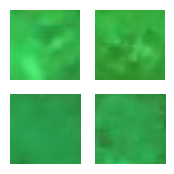

Epoch 938/1000: 100%|██████████| 87/87 [00:05<00:00, 16.82step/s]


Generator Loss: 4.53556489944458, Discriminator Loss: 0.31533774733543396


Epoch 939/1000: 100%|██████████| 87/87 [00:05<00:00, 17.10step/s]

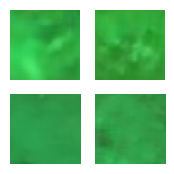

Epoch 939/1000: 100%|██████████| 87/87 [00:05<00:00, 16.19step/s]


Generator Loss: 4.283515453338623, Discriminator Loss: 0.4195009768009186


Epoch 940/1000:  99%|█████████▉| 86/87 [00:04<00:00, 16.40step/s]

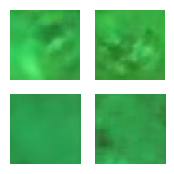

Epoch 940/1000: 100%|██████████| 87/87 [00:05<00:00, 16.62step/s]


Generator Loss: 4.251862049102783, Discriminator Loss: 0.3086813688278198


Epoch 941/1000: 100%|██████████| 87/87 [00:04<00:00, 19.16step/s]

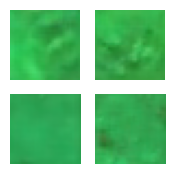

Epoch 941/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 4.196979999542236, Discriminator Loss: 0.3903849422931671


Epoch 942/1000: 100%|██████████| 87/87 [00:04<00:00, 19.22step/s]

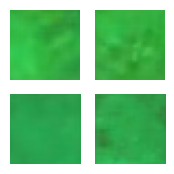

Epoch 942/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 4.122244834899902, Discriminator Loss: 0.42280855774879456


Epoch 943/1000: 100%|██████████| 87/87 [00:04<00:00, 17.52step/s]

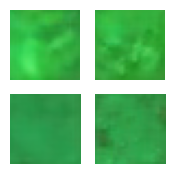

Epoch 943/1000: 100%|██████████| 87/87 [00:04<00:00, 17.69step/s]


Generator Loss: 4.290541172027588, Discriminator Loss: 0.24717508256435394


Epoch 944/1000: 100%|██████████| 87/87 [00:04<00:00, 17.35step/s]

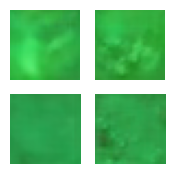

Epoch 944/1000: 100%|██████████| 87/87 [00:05<00:00, 17.36step/s]


Generator Loss: 4.479314804077148, Discriminator Loss: 0.39559119939804077


Epoch 945/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.27step/s]

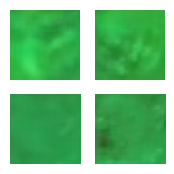

Epoch 945/1000: 100%|██████████| 87/87 [00:05<00:00, 17.16step/s]


Generator Loss: 4.338648796081543, Discriminator Loss: 0.3584987223148346


Epoch 946/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]

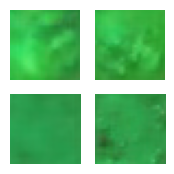

Epoch 946/1000: 100%|██████████| 87/87 [00:04<00:00, 17.44step/s]


Generator Loss: 4.296365737915039, Discriminator Loss: 0.4077529013156891


Epoch 947/1000: 100%|██████████| 87/87 [00:04<00:00, 16.58step/s]

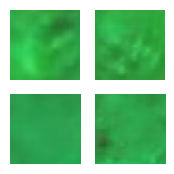

Epoch 947/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 4.571079730987549, Discriminator Loss: 0.32465654611587524


Epoch 948/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]

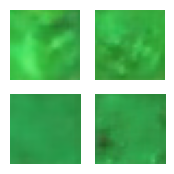

Epoch 948/1000: 100%|██████████| 87/87 [00:04<00:00, 17.94step/s]


Generator Loss: 4.41135311126709, Discriminator Loss: 0.36587318778038025


Epoch 949/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.77step/s]

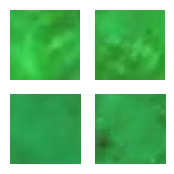

Epoch 949/1000: 100%|██████████| 87/87 [00:04<00:00, 19.96step/s]


Generator Loss: 4.291640758514404, Discriminator Loss: 0.48813045024871826


Epoch 950/1000: 100%|██████████| 87/87 [00:04<00:00, 18.76step/s]

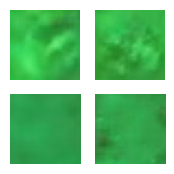

Epoch 950/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 4.2899932861328125, Discriminator Loss: 0.4326636791229248


Epoch 951/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.33step/s]

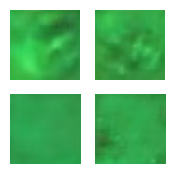

Epoch 951/1000: 100%|██████████| 87/87 [00:04<00:00, 18.41step/s]


Generator Loss: 4.339027404785156, Discriminator Loss: 0.35390257835388184


Epoch 952/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.95step/s]

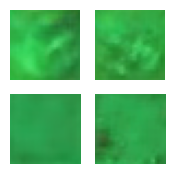

Epoch 952/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 4.492718696594238, Discriminator Loss: 0.2734812796115875


Epoch 953/1000:  99%|█████████▉| 86/87 [00:05<00:00, 14.61step/s]

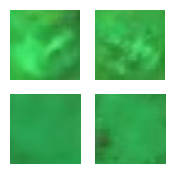

Epoch 953/1000: 100%|██████████| 87/87 [00:05<00:00, 15.60step/s]


Generator Loss: 4.765549659729004, Discriminator Loss: 0.2377946525812149


Epoch 954/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.33step/s]

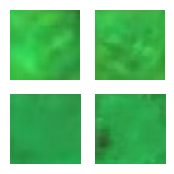

Epoch 954/1000: 100%|██████████| 87/87 [00:05<00:00, 15.44step/s]


Generator Loss: 4.362284183502197, Discriminator Loss: 0.325104296207428


Epoch 955/1000: 100%|██████████| 87/87 [00:05<00:00, 16.69step/s]

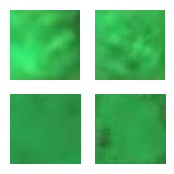

Epoch 955/1000: 100%|██████████| 87/87 [00:05<00:00, 15.25step/s]


Generator Loss: 4.469631671905518, Discriminator Loss: 0.24806588888168335


Epoch 956/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.13step/s]

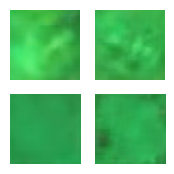

Epoch 956/1000: 100%|██████████| 87/87 [00:05<00:00, 15.55step/s]


Generator Loss: 4.752307415008545, Discriminator Loss: 0.28541088104248047


Epoch 957/1000:  99%|█████████▉| 86/87 [00:05<00:00, 17.27step/s]

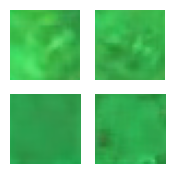

Epoch 957/1000: 100%|██████████| 87/87 [00:05<00:00, 15.89step/s]


Generator Loss: 4.508391857147217, Discriminator Loss: 0.29820379614830017


Epoch 958/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.21step/s]

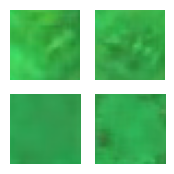

Epoch 958/1000: 100%|██████████| 87/87 [00:05<00:00, 15.23step/s]


Generator Loss: 4.615128993988037, Discriminator Loss: 0.4324060082435608


Epoch 959/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.51step/s]

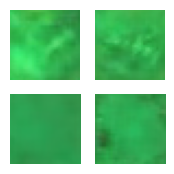

Epoch 959/1000: 100%|██████████| 87/87 [00:05<00:00, 15.08step/s]


Generator Loss: 4.499210834503174, Discriminator Loss: 0.2294081598520279


Epoch 960/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.65step/s]

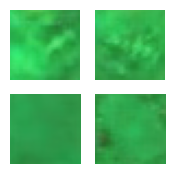

Epoch 960/1000: 100%|██████████| 87/87 [00:05<00:00, 14.65step/s]


Generator Loss: 4.526777267456055, Discriminator Loss: 0.3965505361557007


Epoch 961/1000: 100%|██████████| 87/87 [00:05<00:00, 14.68step/s]

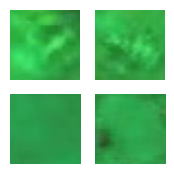

Epoch 961/1000: 100%|██████████| 87/87 [00:05<00:00, 15.18step/s]


Generator Loss: 4.252562999725342, Discriminator Loss: 0.3316396176815033


Epoch 962/1000:  99%|█████████▉| 86/87 [00:05<00:00, 15.07step/s]

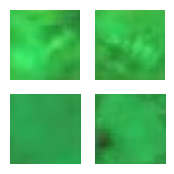

Epoch 962/1000: 100%|██████████| 87/87 [00:06<00:00, 14.22step/s]


Generator Loss: 4.447446823120117, Discriminator Loss: 0.33647188544273376


Epoch 963/1000:  99%|█████████▉| 86/87 [00:05<00:00, 19.77step/s]

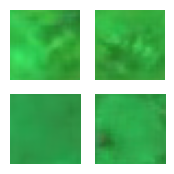

Epoch 963/1000: 100%|██████████| 87/87 [00:05<00:00, 15.94step/s]


Generator Loss: 4.461058139801025, Discriminator Loss: 0.3109712600708008


Epoch 964/1000: 100%|██████████| 87/87 [00:04<00:00, 20.85step/s]

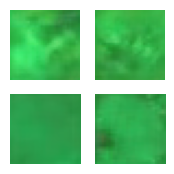

Epoch 964/1000: 100%|██████████| 87/87 [00:04<00:00, 19.35step/s]


Generator Loss: 4.562929630279541, Discriminator Loss: 0.2034638673067093


Epoch 965/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.53step/s]

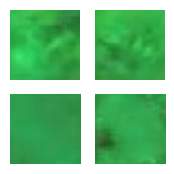

Epoch 965/1000: 100%|██████████| 87/87 [00:04<00:00, 18.67step/s]


Generator Loss: 4.401955604553223, Discriminator Loss: 0.34174707531929016


Epoch 966/1000:  98%|█████████▊| 85/87 [00:04<00:00, 18.39step/s]

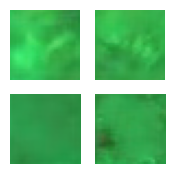

Epoch 966/1000: 100%|██████████| 87/87 [00:04<00:00, 18.55step/s]


Generator Loss: 4.2232279777526855, Discriminator Loss: 0.5564823746681213


Epoch 967/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.89step/s]

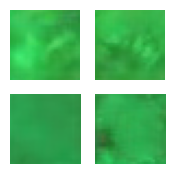

Epoch 967/1000: 100%|██████████| 87/87 [00:04<00:00, 18.54step/s]


Generator Loss: 4.127673149108887, Discriminator Loss: 0.507240891456604


Epoch 968/1000: 100%|██████████| 87/87 [00:04<00:00, 21.00step/s]

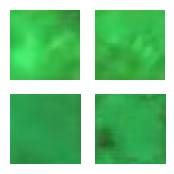

Epoch 968/1000: 100%|██████████| 87/87 [00:04<00:00, 19.01step/s]


Generator Loss: 4.326134204864502, Discriminator Loss: 0.4187835156917572


Epoch 969/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.58step/s]

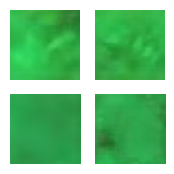

Epoch 969/1000: 100%|██████████| 87/87 [00:04<00:00, 18.46step/s]


Generator Loss: 4.353934288024902, Discriminator Loss: 0.3304097652435303


Epoch 970/1000:  98%|█████████▊| 85/87 [00:04<00:00, 19.07step/s]

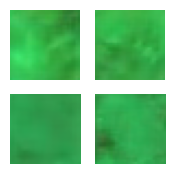

Epoch 970/1000: 100%|██████████| 87/87 [00:04<00:00, 19.38step/s]


Generator Loss: 4.380748748779297, Discriminator Loss: 0.40353384613990784


Epoch 971/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.96step/s]

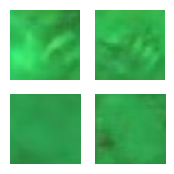

Epoch 971/1000: 100%|██████████| 87/87 [00:04<00:00, 18.25step/s]


Generator Loss: 4.1825642585754395, Discriminator Loss: 0.3805807828903198


Epoch 972/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.11step/s]

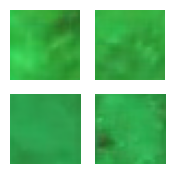

Epoch 972/1000: 100%|██████████| 87/87 [00:04<00:00, 18.84step/s]


Generator Loss: 4.396874904632568, Discriminator Loss: 0.32766976952552795


Epoch 973/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.11step/s]

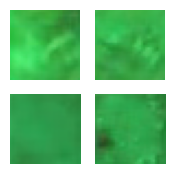

Epoch 973/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 4.287286281585693, Discriminator Loss: 0.30841585993766785


Epoch 974/1000: 100%|██████████| 87/87 [00:04<00:00, 18.37step/s]

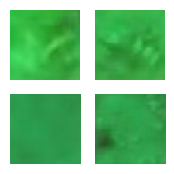

Epoch 974/1000: 100%|██████████| 87/87 [00:04<00:00, 18.43step/s]


Generator Loss: 4.665804386138916, Discriminator Loss: 0.2709428071975708


Epoch 975/1000: 100%|██████████| 87/87 [00:04<00:00, 18.58step/s]

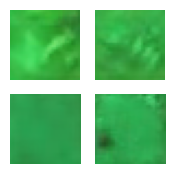

Epoch 975/1000: 100%|██████████| 87/87 [00:04<00:00, 18.31step/s]


Generator Loss: 4.434651851654053, Discriminator Loss: 0.2087501436471939


Epoch 976/1000: 100%|██████████| 87/87 [00:04<00:00, 17.50step/s]

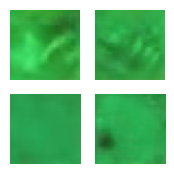

Epoch 976/1000: 100%|██████████| 87/87 [00:04<00:00, 18.50step/s]


Generator Loss: 4.472185134887695, Discriminator Loss: 0.3216796815395355


Epoch 977/1000: 100%|██████████| 87/87 [00:04<00:00, 17.16step/s]

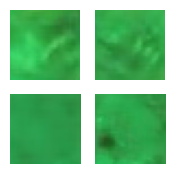

Epoch 977/1000: 100%|██████████| 87/87 [00:04<00:00, 18.68step/s]


Generator Loss: 4.582796573638916, Discriminator Loss: 0.29783472418785095


Epoch 978/1000: 100%|██████████| 87/87 [00:04<00:00, 17.73step/s]

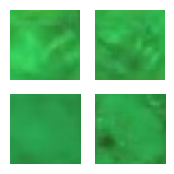

Epoch 978/1000: 100%|██████████| 87/87 [00:04<00:00, 18.12step/s]


Generator Loss: 4.385814189910889, Discriminator Loss: 0.3249480724334717


Epoch 979/1000: 100%|██████████| 87/87 [00:04<00:00, 18.32step/s]

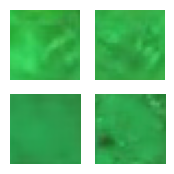

Epoch 979/1000: 100%|██████████| 87/87 [00:04<00:00, 18.96step/s]


Generator Loss: 4.768570423126221, Discriminator Loss: 0.45515695214271545


Epoch 980/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.62step/s]

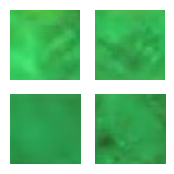

Epoch 980/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 4.603626728057861, Discriminator Loss: 0.37000274658203125


Epoch 981/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.81step/s]

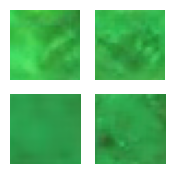

Epoch 981/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 4.4250969886779785, Discriminator Loss: 0.28887757658958435


Epoch 982/1000:  99%|█████████▉| 86/87 [00:04<00:00, 21.61step/s]

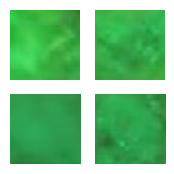

Epoch 982/1000: 100%|██████████| 87/87 [00:04<00:00, 19.23step/s]


Generator Loss: 4.235282897949219, Discriminator Loss: 0.40898990631103516


Epoch 983/1000: 100%|██████████| 87/87 [00:04<00:00, 20.24step/s]

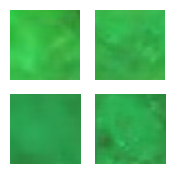

Epoch 983/1000: 100%|██████████| 87/87 [00:04<00:00, 18.64step/s]


Generator Loss: 4.443573474884033, Discriminator Loss: 0.25565648078918457


Epoch 984/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.55step/s]

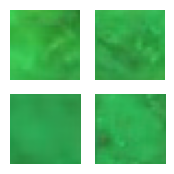

Epoch 984/1000: 100%|██████████| 87/87 [00:04<00:00, 18.83step/s]


Generator Loss: 4.123413562774658, Discriminator Loss: 0.4008852243423462


Epoch 985/1000:  99%|█████████▉| 86/87 [00:04<00:00, 17.62step/s]

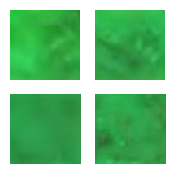

Epoch 985/1000: 100%|██████████| 87/87 [00:04<00:00, 18.48step/s]


Generator Loss: 4.76420783996582, Discriminator Loss: 0.308989942073822


Epoch 986/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.47step/s]

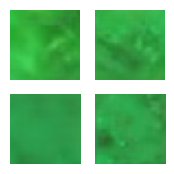

Epoch 986/1000: 100%|██████████| 87/87 [00:04<00:00, 19.03step/s]


Generator Loss: 4.682100296020508, Discriminator Loss: 0.3952575623989105


Epoch 987/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.90step/s]

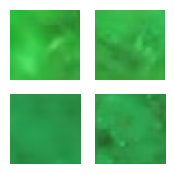

Epoch 987/1000: 100%|██████████| 87/87 [00:04<00:00, 19.10step/s]


Generator Loss: 4.066554069519043, Discriminator Loss: 0.5169171094894409


Epoch 988/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.03step/s]

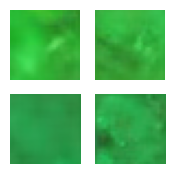

Epoch 988/1000: 100%|██████████| 87/87 [00:04<00:00, 18.47step/s]


Generator Loss: 4.197395324707031, Discriminator Loss: 0.6293578743934631


Epoch 989/1000: 100%|██████████| 87/87 [00:04<00:00, 18.13step/s]

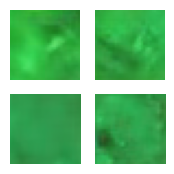

Epoch 989/1000: 100%|██████████| 87/87 [00:04<00:00, 17.82step/s]


Generator Loss: 4.31646203994751, Discriminator Loss: 0.32592007517814636


Epoch 990/1000: 100%|██████████| 87/87 [00:05<00:00, 18.01step/s]

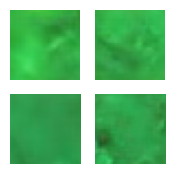

Epoch 990/1000: 100%|██████████| 87/87 [00:05<00:00, 16.82step/s]


Generator Loss: 4.427454948425293, Discriminator Loss: 0.2795833647251129


Epoch 991/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.93step/s]

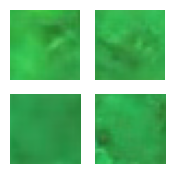

Epoch 991/1000: 100%|██████████| 87/87 [00:04<00:00, 17.84step/s]


Generator Loss: 4.4763641357421875, Discriminator Loss: 0.2597050964832306


Epoch 992/1000: 100%|██████████| 87/87 [00:04<00:00, 18.90step/s]

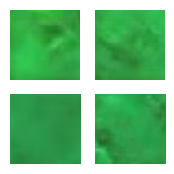

Epoch 992/1000: 100%|██████████| 87/87 [00:04<00:00, 17.79step/s]


Generator Loss: 4.298470497131348, Discriminator Loss: 0.40981197357177734


Epoch 993/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.02step/s]

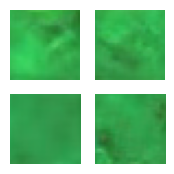

Epoch 993/1000: 100%|██████████| 87/87 [00:05<00:00, 17.12step/s]


Generator Loss: 4.470847129821777, Discriminator Loss: 0.31462910771369934


Epoch 994/1000: 100%|██████████| 87/87 [00:04<00:00, 18.15step/s]

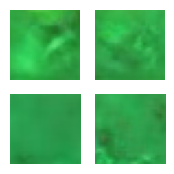

Epoch 994/1000: 100%|██████████| 87/87 [00:04<00:00, 17.87step/s]


Generator Loss: 4.590190887451172, Discriminator Loss: 0.31591591238975525


Epoch 995/1000: 100%|██████████| 87/87 [00:04<00:00, 20.15step/s]

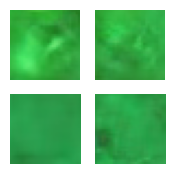

Epoch 995/1000: 100%|██████████| 87/87 [00:04<00:00, 18.69step/s]


Generator Loss: 4.469313144683838, Discriminator Loss: 0.34738150238990784


Epoch 996/1000:  99%|█████████▉| 86/87 [00:04<00:00, 18.01step/s]

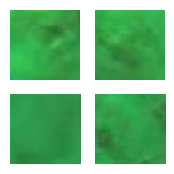

Epoch 996/1000: 100%|██████████| 87/87 [00:04<00:00, 17.75step/s]


Generator Loss: 4.384539604187012, Discriminator Loss: 0.5185019969940186


Epoch 997/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.45step/s]

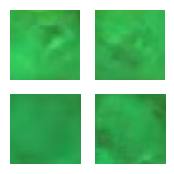

Epoch 997/1000: 100%|██████████| 87/87 [00:04<00:00, 18.75step/s]


Generator Loss: 4.334612846374512, Discriminator Loss: 0.33439135551452637


Epoch 998/1000:  99%|█████████▉| 86/87 [00:04<00:00, 20.38step/s]

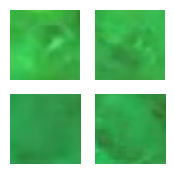

Epoch 998/1000: 100%|██████████| 87/87 [00:04<00:00, 18.24step/s]


Generator Loss: 4.622951984405518, Discriminator Loss: 0.2788594365119934


Epoch 999/1000: 100%|██████████| 87/87 [00:04<00:00, 19.40step/s]

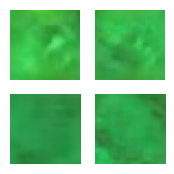

Epoch 999/1000: 100%|██████████| 87/87 [00:04<00:00, 17.90step/s]


Generator Loss: 4.707544803619385, Discriminator Loss: 0.3227073550224304


Epoch 1000/1000:  99%|█████████▉| 86/87 [00:04<00:00, 19.28step/s]

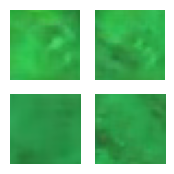

Epoch 1000/1000: 100%|██████████| 87/87 [00:04<00:00, 17.44step/s]

Generator Loss: 4.708096504211426, Discriminator Loss: 0.2651847302913666


In [579]:
train(dataset, epochs=1000,batch_size=64)

In [ ]:
generator.save('generator_erizos.h5')

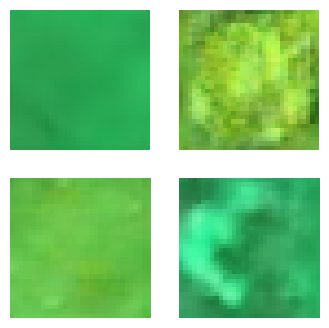

In [603]:
seed = tf.random.normal([num_examples_to_generate, 100])
predictions = generator(seed , training=False)

# Adjust the figure size if needed
fig = plt.figure(figsize=(4, 4))  # You may want to make this bigger if the images are too small

# Limit to display the first 4 images
for i in range(4):  # Change from `predictions.shape[0]` to `4`
    plt.subplot(2, 2, i+1)  # Arrange in a 2x2 grid
    # Rescale the pixel values to the [0, 255] range and remove the last dimension
    image = np.squeeze(np.clip(predictions[i] * 127.5 + 127.5, 0, 255).astype(np.uint8))
    plt.imshow(image, cmap='gray')  # Show the image in grayscale
    plt.axis('off')

plt.show()

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def generar_imagen_con_objetos(num_min_objetos, num_max_objetos, proporciones, tamanos, tamano_imagen=512):
    """
    Genera una imagen cuadrada con objetos representados por rectángulos de colores sin superposición.
    Devuelve la figura, y una lista de tuplas que incluyen la clase y las coordenadas de los objetos.

    :param num_min_objetos: Número mínimo de objetos a generar.
    :param num_max_objetos: Número máximo de objetos a generar.
    :param proporciones: Diccionario con la proporción de cada tipo de objeto.
    :param tamanos: Diccionario con rangos de tamaño (min, max) para cada tipo de objeto.
    :param tamano_imagen: Tamaño de la imagen (se asume cuadrada).
    :return: La figura y las coordenadas con clases de los objetos.
    """
    # Colores para cada tipo de objeto
    colores = {'erizo': 'red', 'pepino': 'yellow', 'vieira': 'white'}

    # Crear figura cuadrada
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlim(0, tamano_imagen)
    ax.set_ylim(0, tamano_imagen)

    # Fondo azul para la imagen
    ax.set_facecolor('blue')

    # Número aleatorio de objetos a generar
    num_objetos = random.randint(num_min_objetos, num_max_objetos)
    objetos = []

    while len(objetos) < num_objetos:
        tipo = random.choices(list(proporciones.keys()), weights=list(proporciones.values()))[0]
        min_tamano, max_tamano = tamanos[tipo]
        ancho = random.randint(min_tamano, max_tamano)
        alto = random.randint(min_tamano, max_tamano)
        xmin = random.randint(0, tamano_imagen - ancho)
        ymin = random.randint(0, tamano_imagen - alto)

        nuevo_objeto = (xmin, ymin, xmin + ancho, ymin + alto)

        # Comprobar superposición
        if not any(overlap(nuevo_objeto, existente[1]) for existente in objetos):
            objetos.append((tipo, nuevo_objeto))

            # Dibujar rectángulo
            rect = patches.Rectangle((xmin, ymin), ancho, alto, linewidth=1, edgecolor='black', facecolor=colores[tipo])
            ax.add_patch(rect)

    plt.show()
    return fig, objetos

def overlap(obj1, obj2):
    """
    Comprueba si dos objetos (definidos por sus coordenadas) se superponen.

    :param obj1: Coordenadas del primer objeto (xmin, ymin, xmax, ymax).
    :param obj2: Coordenadas del segundo objeto (xmin, ymin, xmax, ymax).
    :return: True si hay superposición, False en caso contrario.
    """
    return not (obj1[2] <= obj2[0] or obj1[0] >= obj2[2] or obj1[3] <= obj2[1] or obj1[1] >= obj2[3])

# Ejemplo de uso
num_min_objetos = 5
num_max_objetos = 20
proporciones = {'erizo': 0.4, 'pepino': 0.3, 'vieira': 0.3}
tamanos = {'erizo': (32, 64), 'pepino': (32, 64), 'vieira': (20, 40)}

figura, objetos = generar_imagen_con_objetos(num_min_objetos, num_max_objetos, proporciones, tamanos)
for objeto in objetos:
    print(objeto)
